In [31]:
from functools import partial 
from collections import defaultdict 
from mpl_toolkits.mplot3d import axes3d #Used for the 3d bifurcation plot
from matplotlib.ticker import MultipleLocator
from lmfit import minimize, Parameters, Parameter, report_fit
from math import pow
from datetime import datetime

from scipy.stats import kde
from scipy.integrate import odeint
from scipy.optimize import fsolve 
from scipy.optimize import minimize
from scipy.optimize import curve_fit
from scipy.optimize import basinhopping
from scipy.optimize import Bounds

from pymcmcstat.MCMC import MCMC
from pymcmcstat.plotting import MCMCPlotting
from pymcmcstat.ParallelMCMC import ParallelMCMC
from pymcmcstat.chain import ChainProcessing as CP
from pymcmcstat.chain import ChainStatistics as CS
from pymcmcstat import mcmcplot as mcp

import numpy as np # Numerical computing library
import matplotlib.pyplot as plt # Plotting library
import scipy.integrate #Integration library
import matplotlib.patches as mpatches #used to write custom legends
import math
import os
import sys
import glob
import matplotlib
import numpy as np
import pandas as pd
import xlrd
import matplotlib as mpl
import scipy.io as sio
import pymcmcstat
import scipy
import seaborn as sns
import statistics
import scipy.stats as st
import pymc3
import copy as cp

%matplotlib inline
%precision 4
matplotlib.rcParams['text.usetex'] = True
plt.style.use('ggplot')

mpl.rc("figure", facecolor="white")
mpl.style.use('classic')

np.seterr(over='ignore');

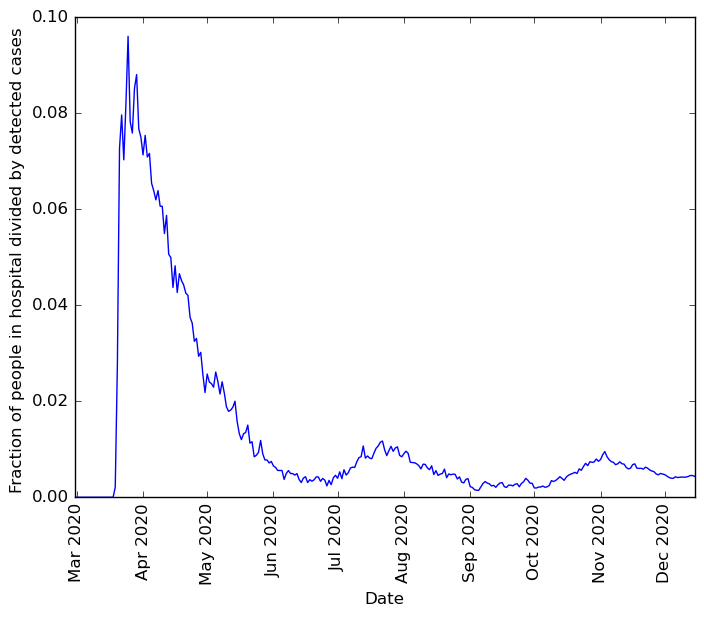

In [32]:
df=pd.read_excel('Data_Luxembourg.xlsx',header=0,index_col=False)
df.head()
df['date']

plt.figure(figsize=(8,6),facecolor="white")
plt.xticks(rotation=90)
plt.xlabel('Date')
plt.ylabel('Fraction of people in hospital divided by detected cases ')
plt.plot(df['date'],df['COVIDsoinsnormaux']/df['new_cases_cum'])

NumberDaysData = len(df['date'])


In [33]:
#seir model
def ODEs(rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,
         tau5,
         tau6,
         tau7,tau8,tau9,
               v,t): 
    
    # Model system
    # S, E, R ,II ,Q, NII, D, H, Hl, ICU, AICU, NI, NI1, R1, D1, D1b?
    
    y=np.zeros((16))

    y[0]=beta*(v[5]+v[3])*v[0]*-rho #S
    y[1]=rho*beta*v[0]*(v[5]+v[3]) - alpha*v[1]#E
    y[2]= tau5*v[8]*p5+tau6*v[10]*p6+p7*tau7*v[11]#R
    y[3]=alpha*p1*v[1]-tau1*v[3]#II
    y[4]= tau1*v[3]-v[4]*(1-p2)*tau2-p2*v[4]*tau2#Q
    y[5]=(1-p1)*alpha*v[1]-v[5]*tau8#NII
    y[6]=  (1-p6)*v[10]*tau6+(1-p5)*v[8]*tau5+(1-p4)*tau4*v[9]#D
    y[7]=  p2*v[4]*tau2-p3*v[7]*tau3-(1-p3)*v[7]*tau3#H
    y[8]= p3*v[7]*tau3-p5*v[8]*tau5-(1-p5)*v[8]*tau5#Hl
    y[9]=  (1-p3)*v[7]*tau3-tau4*v[9]*p4-(1-p4)*v[9]*tau4#ICU
    y[10]=  tau4*v[9]*p4-v[10]*tau6*p6-v[10]*tau6*(1-p6)#AICU
    y[11]=v[4]*(1-p2)*tau2-tau7*(1-p7)*v[11]-p7*tau7*v[11]#NI
    y[12]=v[5]*tau8-tau9*(1-p9)*v[12]-p9*tau9*v[12]#NI1
    y[13]=p9*v[12]*tau9#R1
    y[14]=(1-p9)*tau9*v[12]#D1
    y[15]=(1-p7)*v[11]*tau7#D1b
    return y


In [34]:
def ODE_system(rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,
               tau5,
               tau6,
               tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,
               tau5prim,
               tau6prim,
                                    tau7prim,tau8prim,tau9prim,p1prim,
                p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,
               tau5prim2,
               tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,
               v,t):   
    
    if t<101: 
        y=ODEs(rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               v,t)    
    elif t>=101 and t<204:
        y=ODEs(rho,alpha, beta, 
               p1prim, p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau1,tau2,tau3prim,tau4prim,tau5prim,
               tau6prim,tau7prim,tau8prim,tau9prim,
               v,t)
    elif t>=204:
        y=ODEs(rho,alpha, beta, 
               p1prim, p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau1,tau2,tau3prim2,tau4prim2,tau5prim2,tau6prim2,
               tau7prim2,tau8prim2,tau9prim2,
               v,t)
      
    return y


In [35]:
def rhoAsFunctionforLuxembourg(time,ListOfRhos):
    
    rho0 = ListOfRhos[0]
    rho1 = ListOfRhos[1]
    rho2 = ListOfRhos[2]
    rho3 = ListOfRhos[3]
    rho4 = ListOfRhos[4]
    rho5 = ListOfRhos[5]
    rho6 = ListOfRhos[6]
    rho7 = ListOfRhos[7]
    rho8 = ListOfRhos[8]
    rho9 = ListOfRhos[9]
    rho10 = ListOfRhos[10]
    rho11 = ListOfRhos[11]
    rho12 = ListOfRhos[12]
    rho13 = ListOfRhos[13]
    
    
    ListOfRhosOUTPUT = []
    for t in time:
        if (t<22):
            rho=1
        elif (t>=22)and (t<29):
            rho=rho1
        elif (t>=29)and (t<57):
            rho=rho2
        elif (t>=57)and (t<71):
            rho=rho3
        elif (t>=71)and (t<108):  
            rho=rho4
        elif (t>=108)and(t<127):
            rho=rho5
        elif (t>=127) and (t<141):
            rho=rho6
        elif (t>=141) and (t<159):
            rho=rho7
        elif(t>=159) and (t<171):
            rho=rho8
        elif(t>=171) and (t<182): 
            rho=rho9
        elif(t>=182) and (t<204): 
            rho=rho10
        elif(t>=204) and (t<250):
            rho=rho11  
        elif(t>=250)and(t<276):
            rho=rho12
        elif(t>=276)and(t<NumberDaysData): # This is latest gov measures on Nov 26th of 2 people max at home and restaurants/bar closure 
            rho=rho13  
        elif t >= NumberDaysData:
            if len(ListOfRhos) < 15:
                rho=rho13
            elif len(ListOfRhos) >= 15:
                rho=ListOfRhos[14]
            
        ListOfRhosOUTPUT.append(rho)
    return np.array(ListOfRhosOUTPUT)


In [36]:
#rho values
rho1=0.4902
rho2=0.1984
rho3=0.1918
rho4=0.2507
rho5=0.5298
rho6=0.4804
rho7=0.3101
rho8=0.2203
rho9=0.3457
rho10=0.3351
rho11=0.4333
rho12=0.341 
rho13=0.39

ListOfRhos=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]

In [37]:
# Some Plotting Variables shared by all Plots

LenghtOfForecast = 136 # This hold for all plots: by how many days you wish to show simulation, after end of data?
endofplot = NumberDaysData + LenghtOfForecast

MyListOfDates = ['24 February']
for Day in np.arange(25,30,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,29,1):
    ThisDate = str(Day) + ' February'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
    
MyListOfDates=np.array(MyListOfDates)

only10thindex=np.arange(0,endofplot+1,30)#10)
plt.style.use('ggplot')
mpl.rc("figure", facecolor="white")
mpl.style.use('classic')

FileFormatOfFigures = '.pdf' # Could be also '.pdf' or '.png'

Results_Luxembourg folder already exists.


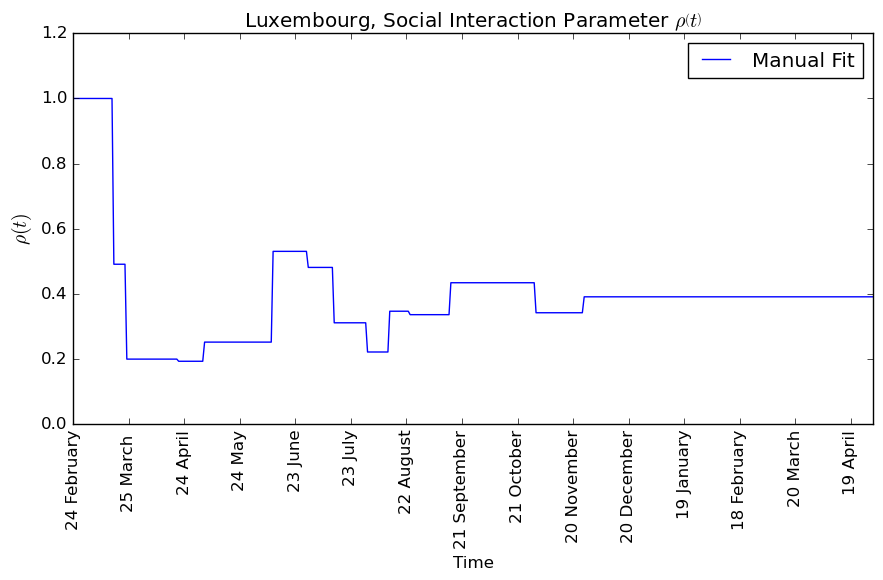

In [38]:
#################################################
### Make a plot of rho values from manual fit ###
#################################################

plt.figure(facecolor="white",figsize=(9, 6))

times=np.arange(0,endofplot+1,1)
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhos),'-',color='blue',label='Manual Fit')

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.xlabel("Time")
plt.ylabel(r'$\rho(t)$', size=14)
plt.xlim(0,endofplot)
plt.ylim(0,1.2)
plt.title(r'Luxembourg, Social Interaction Parameter $\rho\left(t\right)$')
plt.legend(loc='upper right')
plt.tight_layout()

MYDIR = ("Results_Luxembourg")
CHECK_FOLDER = os.path.isdir(MYDIR)
# If folder doesn't exist, then create it.
if not CHECK_FOLDER:
    os.makedirs(MYDIR)
    print("created folder : ", MYDIR)
else:
    print(MYDIR, "folder already exists.")

plt.savefig('./Results_Luxembourg/SocialDistancingManualFit' + FileFormatOfFigures)

In [39]:
MyListOfDates[endofplot]

'1 May'

In [40]:

def model_SEIRICUHOS(v,t,ListOfRhos,ListOfParameters):
    
    # 1st Wave

    alpha=ListOfParameters[0] 
    beta=ListOfParameters[1]
    p1=ListOfParameters[2]
    p2=ListOfParameters[3]
    p3=ListOfParameters[4]
    p4=ListOfParameters[5]
    p5=ListOfParameters[6]
    p6=ListOfParameters[7]
    p7=ListOfParameters[8]
    p9=ListOfParameters[9]
    tau1 = ListOfParameters[10]
    tau2 = ListOfParameters[11]
    tau3 = ListOfParameters[12]
    tau4 = ListOfParameters[13]
    tau5 = ListOfParameters[14]
    tau6 = ListOfParameters[15]
    tau7 = ListOfParameters[16]
    tau8 = ListOfParameters[17]
    tau9 = ListOfParameters[18]
    
    # 2nd Wave

    p2prim=ListOfParameters[19]
    p3prim=ListOfParameters[20]
    p4prim=ListOfParameters[21]
    p5prim=ListOfParameters[22]
    p6prim=ListOfParameters[23]
    p7prim=ListOfParameters[24]
    p9prim=ListOfParameters[25]
    tau3prim=ListOfParameters[26]
    tau4prim=ListOfParameters[27]
    tau5prim=ListOfParameters[28]
    tau6prim=ListOfParameters[29]
    tau7prim=ListOfParameters[30]
    tau8prim=ListOfParameters[31]
    tau9prim=ListOfParameters[32]
    p1prim=ListOfParameters[33]
    
    # 3rd Wave
    
    p2prim2=ListOfParameters[34]
    p3prim2=ListOfParameters[35]
    p4prim2=ListOfParameters[36]
    p5prim2=ListOfParameters[37]
    p6prim2=ListOfParameters[38]
    p7prim2=ListOfParameters[39]
    p9prim2=ListOfParameters[40]
    tau3prim2=ListOfParameters[41]
    tau4prim2=ListOfParameters[42]
    tau5prim2=ListOfParameters[43]
    tau6prim2=ListOfParameters[44]
    tau7prim2=ListOfParameters[45]
    tau8prim2=ListOfParameters[46]
    tau9prim2=ListOfParameters[47]
    
    rho=rhoAsFunctionforLuxembourg([t],ListOfRhos)
    
    y=ODE_system(rho[0],alpha, beta, 
               p1,p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
            p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                 p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,
                 v,t)
    
    return y

In [41]:
###### Define the Parameter Values for the Manual fit of the ODE Model ######
    
### PARAMETERS 1st WAVE ###

p1=0.31 # convince
    
tau1=0.6808
tau2=0.5979
tau3=0.5246

p3=0.7906
p2=0.1534
p4old=0.91
p5old=0.9295
p6old=0.9298

alpha=0.4433
beta=1.287

p7=0.9876

tau7=0.1084
tau6sur=0.0832
tau6die=0.1127
tau5sur=0.0579
tau5die=0.1124
tau4sur=0.0444
tau4die=0.1207

x4=tau4sur*p4old
y4=tau4die*(1-p4old)

tau4=x4+y4
p4=x4/(x4+y4)

x5=tau5sur*p5old
y5=tau5die*(1-p5old)

tau5=x5+y5
p5=x5/(x5+y5)

x6=tau6sur*p6old
y6=tau6die*(1-p6old)

tau6=x6+y6
p6=x6/(x6+y6)


tau8=1/(1/tau1+1/tau2)
p9=p7
tau9=tau7

### PARAMETERS 2nd WAVE ###

tau1prim=tau1
tau2prim=tau2
tau3prim=tau3 

p3prim= 0.86
p2prim=0.08 
p4oldprim=0.95
p5oldprim=0.9906
p6oldprim=0.9907
p7prim=0.9979

tau7prim=0.1084
tau6surprim=0.15
tau6dieprim=0.3 
tau5surprim=0.15
tau5dieprim=0.3
tau4surprim=0.1
tau4dieprim=0.2

x4prim=tau4surprim*p4oldprim
y4prim=tau4dieprim*(1-p4oldprim)

tau4prim=x4prim+y4prim
p4prim=x4prim/(x4prim+y4prim)

x5prim=tau5surprim*p5oldprim
y5prim=tau5dieprim*(1-p5oldprim)

tau5prim=x5prim+y5prim
p5prim=x5prim/(x5prim+y5prim)

x6prim=tau6surprim*p6oldprim
y6prim=tau6dieprim*(1-p6oldprim)

tau6prim=x6prim+y6prim
p6prim=x6prim/(x6prim+y6prim)

tau8prim=1/(1/tau1prim+1/tau2prim)
p9prim=p7prim
tau9prim=tau7prim


### PARAMETERS 3rd WAVE ###

p2prim2=0.042
p3prim2=0.78
p4oldprim2=0.94 
p5oldprim2=0.93
p6oldprim2=0.94 
p7prim2=0.997
p9prim2=p9prim
tau3prim2=tau3prim
tau4surprim2=tau4surprim
tau4dieprim2=tau4dieprim
tau5surprim2=tau5surprim
tau5dieprim2=tau5dieprim
tau6surprim2=tau6surprim
tau6dieprim2=tau6dieprim
tau7prim2=tau7prim
tau8prim2=tau8prim
tau9prim2=tau9prim

x4prim2=tau4surprim2*p4oldprim2
y4prim2=tau4dieprim2*(1-p4oldprim2)

tau4prim2=x4prim2+y4prim2
p4prim2=x4prim2/(x4prim2+y4prim2)

x5prim2=tau5surprim2*p5oldprim2
y5prim2=tau5dieprim2*(1-p5oldprim2)

tau5prim2=x5prim2+y5prim2
p5prim2=x5prim2/(x5prim2+y5prim2)

x6prim2=tau6surprim2*p6oldprim2
y6prim2=tau6dieprim2*(1-p6oldprim2)

tau6prim2=x6prim2+y6prim2
p6prim2=x6prim2/(x6prim2+y6prim2)

p1prim=0.4 
ListOfParametersfirstwave=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2])


In [42]:
# Run the model

N=623180
P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
t_max = 1000
dt = 1
t = np.linspace(0, t_max, int(t_max/dt) + 1)

resultsseir=odeint(model_SEIRICUHOS,P2,t,(ListOfRhos,ListOfParametersfirstwave))

In [43]:
# Define Function To Compute the Seven Days Moving Average

def ComputeSevenDaysMovingAverage(InputRawData):

    WeeklyAveragedData = [
        InputRawData[0]/1,
        sum(InputRawData[0:2])/3,
        sum(InputRawData[0:4])/5]
    
    Final = len(InputRawData)
    for i in np.arange(3,Final-3,1):
        WeeklyAveragedData.append(sum(InputRawData[i-3:i+3+1])/7)
        
    WeeklyAveragedData.append(sum(InputRawData[Final-5::])/5)
    WeeklyAveragedData.append(sum(InputRawData[Final-3::])/3)
    WeeklyAveragedData.append(InputRawData[Final-1]/1)
    
    WeeklyAveragedData = np.array(WeeklyAveragedData)
    
    return WeeklyAveragedData

In [44]:
Rho_BestScenario = min(ListOfRhos)
Rho_WorstScenario = ListOfRhos[11]

List_Rho_BestScenario = list(ListOfRhos) + [Rho_BestScenario]
List_Rho_WorstScenario = list(ListOfRhos) + [Rho_WorstScenario]

resultsseir_Best=odeint(model_SEIRICUHOS,P2,t,(List_Rho_BestScenario,ListOfParametersfirstwave))
resultsseir_Worst=odeint(model_SEIRICUHOS,P2,t,(List_Rho_WorstScenario,ListOfParametersfirstwave))


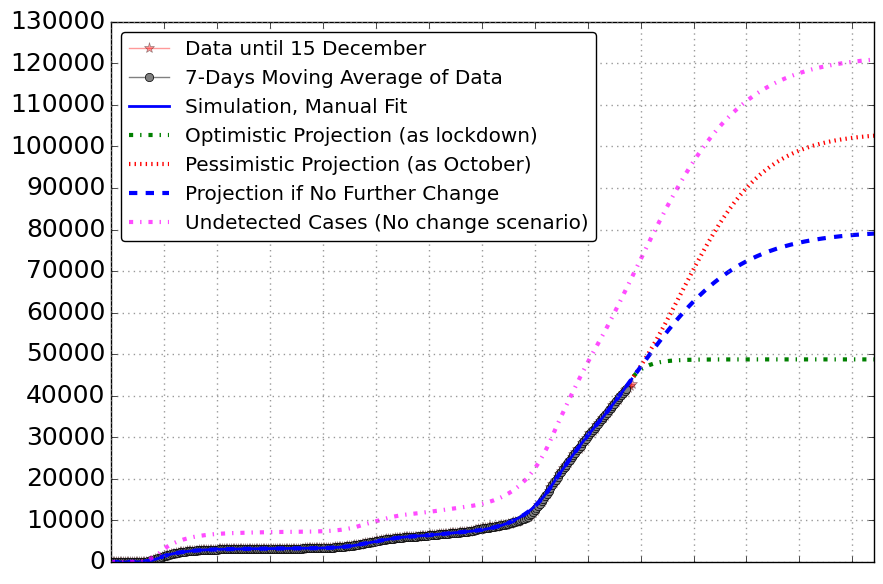

In [45]:
#plot cumulative cases
plt.figure(figsize=(9, 6),facecolor="white")

DI=df['new_cases_cum']
SevenDaysMovingAverage_TotalCases = ComputeSevenDaysMovingAverage(DI)
p =len(SevenDaysMovingAverage_TotalCases)

plt.plot(times[0:p],DI,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_TotalCases)-1]),alpha=0.4,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_TotalCases[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t[0:NumberDaysData],(resultsseir[:,2]+resultsseir[:,3]+resultsseir[:,4]+resultsseir[:,6]+resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,9]+resultsseir[:,10]+resultsseir[:,11]+resultsseir[:,15])[0:NumberDaysData]*N, label="Simulation, Manual Fit", linewidth=2,color='blue')

Optimistic = resultsseir_Best[:,2]+resultsseir_Best[:,3]+resultsseir_Best[:,4]+resultsseir_Best[:,6]+resultsseir_Best[:,7]+resultsseir_Best[:,8]+resultsseir_Best[:,9]+resultsseir_Best[:,10]+resultsseir_Best[:,11]+resultsseir_Best[:,15]
Pessimistic = resultsseir_Worst[:,2]+resultsseir_Worst[:,3]+resultsseir_Worst[:,4]+resultsseir_Worst[:,6]+resultsseir_Worst[:,7]+resultsseir_Worst[:,8]+resultsseir_Worst[:,9]+resultsseir_Worst[:,10]+resultsseir_Worst[:,11]+resultsseir_Worst[:,15]
plt.plot(t[NumberDaysData:-1],Optimistic[NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
plt.plot(t[NumberDaysData:-1],Pessimistic[NumberDaysData:-1]*N,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
plt.plot(t,(resultsseir[:,2]+resultsseir[:,3]+resultsseir[:,4]+resultsseir[:,6]+resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,9]+resultsseir[:,10]+resultsseir[:,11]+resultsseir[:,15])*N,'--', label="Projection if No Further Change", linewidth=3,color='blue')

plt.plot(t,(resultsseir[:,12]+resultsseir[:,13]+resultsseir[:,14]+resultsseir[:,5])*N,'-.', label="Undetected Cases (No change scenario)", linewidth=3,color='magenta',alpha=0.7)

UpperY = 130000
plt.xticks(times[only10thindex],'')
plt.yticks(np.arange(0,UpperY+1,10000),fontsize=18)

#plt.title("Luxembourg")

plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Total Detected Cases",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY)
plt.legend(loc='upper left', fancybox=True, numpoints=1)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/TotalCases_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

In [46]:
DETECTED_CASES = (resultsseir[:,2]+resultsseir[:,3]+resultsseir[:,4]+resultsseir[:,6]+resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,9]+resultsseir[:,10]+resultsseir[:,11]+resultsseir[:,15])*N
UNDETECTED_CASES = (resultsseir[:,12]+resultsseir[:,13]+resultsseir[:,14]+resultsseir[:,5])*N
Undetected_Fraction_15Dec = UNDETECTED_CASES[NumberDaysData]/N
print(Undetected_Fraction_15Dec)
Detected_Fraction_15Dec = DETECTED_CASES[NumberDaysData]/N
print(Detected_Fraction_15Dec)
print(Undetected_Fraction_15Dec+Detected_Fraction_15Dec)

0.11119438755994948
0.07159778279326083
0.18279217035321033


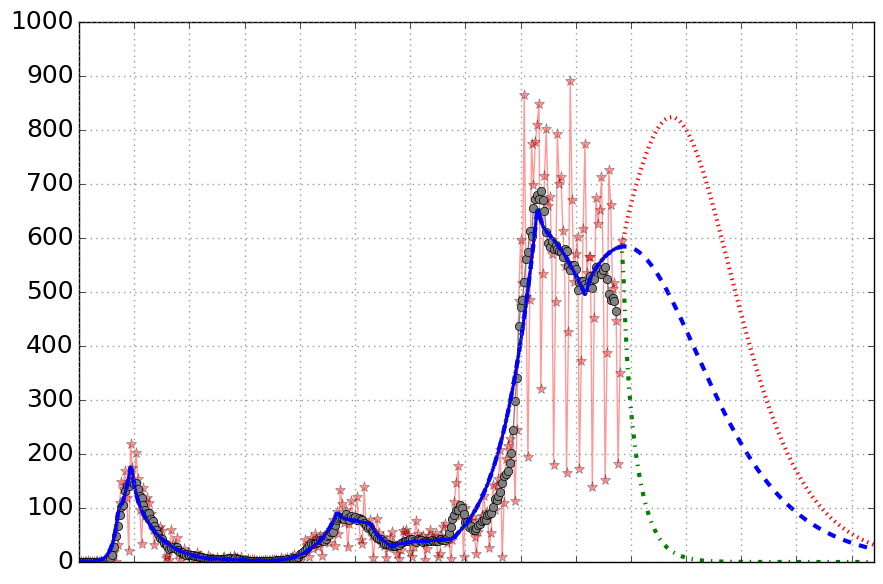

In [47]:
#daily new cases 
plt.figure(figsize=(9, 6),facecolor="white")

DI1=df['new_cases']
SevenDaysMovingAverage_DailyCases = ComputeSevenDaysMovingAverage(DI1)
p =len(SevenDaysMovingAverage_DailyCases)
    
plt.plot(times[0:p],DI1,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_DailyCases)-1]),alpha=0.4,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_DailyCases[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
yoo=(resultsseir[:,2]+resultsseir[:,3]+resultsseir[:,4]+resultsseir[:,6]+resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,9]+resultsseir[:,10]+resultsseir[:,11]+resultsseir[:,15])*N

yooOptimistic = Optimistic*N
yooPessimistic = Pessimistic*N

pp=len(yoo)

yuu=np.zeros(1001)
for ii in range(0,1000):
    yuu[ii]= yoo[ii+1]-yoo[ii]
plt.plot(np.arange(0,1001,1)[0:NumberDaysData],yuu[0:NumberDaysData],label="Simulation, Manual Fit", linewidth=2,color='blue')

yuuOptimistic=np.zeros(1001)
for ii in range(0,1000):
    yuuOptimistic[ii]= yooOptimistic[ii+1]-yooOptimistic[ii]
plt.plot(np.arange(0,1001,1)[0:pp+1],yuuOptimistic,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')

yuuPessimistic=np.zeros(1001)
for ii in range(0,1000):
    yuuPessimistic[ii]= yooPessimistic[ii+1]-yooPessimistic[ii]
plt.plot(np.arange(0,1001,1)[0:pp+1],yuuPessimistic,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')

plt.plot(np.arange(0,1001,1)[0:NumberDaysData],yuu[0:NumberDaysData], linewidth=2,color='blue')

plt.plot(np.arange(0,1001,1)[0:pp+1],yuu,'--', label="Projection if No Further Change", linewidth=3)

UpperY1 = 1000
#plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.xticks(times[only10thindex], '')
plt.yticks(np.arange(0,UpperY1+1,100),fontsize=18)

#plt.title("Luxembourg")

#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Daily New Detected Cases",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY1)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/DailyNewCases_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

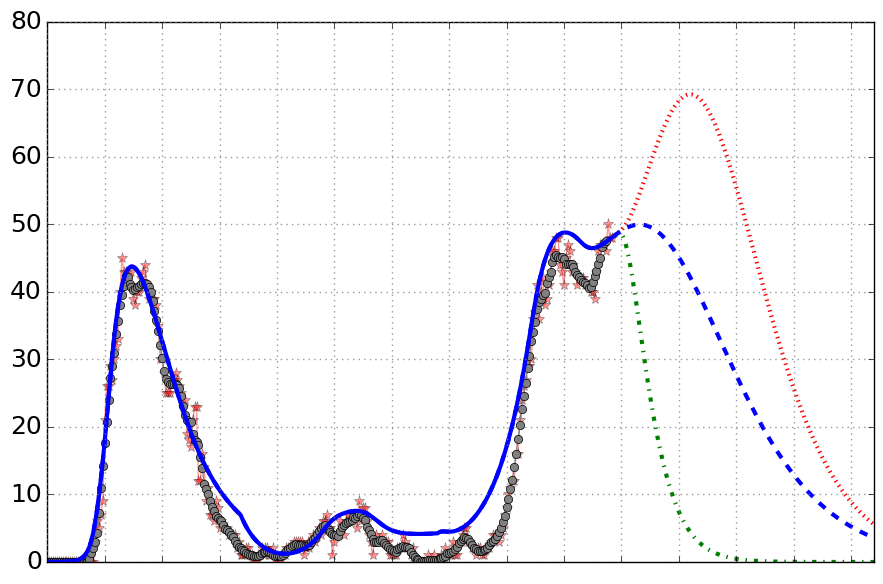

In [48]:
#Icu plot
plt.figure(figsize=(9, 6),facecolor="white")

icu1=df['COVIDensoinsintensifs']
SevenDaysMovingAverage_ICU = ComputeSevenDaysMovingAverage(icu1)
p =len(SevenDaysMovingAverage_ICU)
    
plt.plot(times[0:p],icu1,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_ICU)-1]),alpha=0.4,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_ICU[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t[0:NumberDaysData],(resultsseir[:,9])[0:NumberDaysData]*N, label="Simulation Manual Fit", linewidth=3,color='blue')
#plt.axhline(y=70, color='orange', linestyle=':',lw=5,label="Critical ICU threshold",alpha=0.7)
#plt.axhline(y=90, color='r', linestyle=':',lw=5,label="Max ICU capacity",alpha=0.7)

plt.plot(t[NumberDaysData:-1],resultsseir_Best[:,9][NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
plt.plot(t[NumberDaysData:-1],resultsseir_Worst[:,9][NumberDaysData:-1]*N,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
plt.plot(t,resultsseir[:,9]*N,'--', label="Projection if No Further Change", linewidth=3)

UpperY2 = 80
#plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.xticks(times[only10thindex], '')
plt.yticks(np.arange(0,UpperY2+1,10),fontsize=18)

#plt.title("Luxembourg")

#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("People in ICU",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY2)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/ICU_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

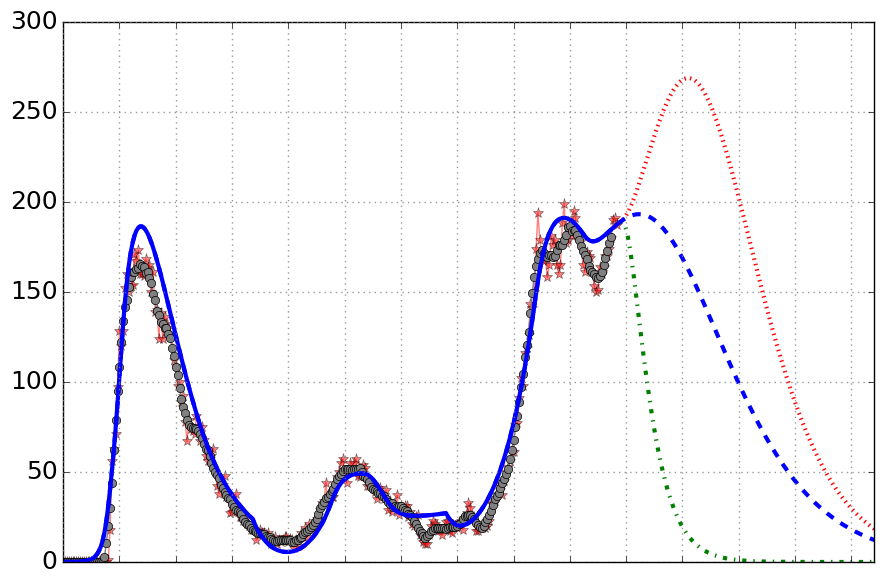

In [49]:
#Hospital bed plot
plt.figure(figsize=(9, 6),facecolor="white")

H=df['COVIDsoinsnormaux']
SevenDaysMovingAverage_Hos = ComputeSevenDaysMovingAverage(H)
p =len(SevenDaysMovingAverage_Hos)
    
plt.plot(times[0:p],H,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_Hos-1)]),alpha=0.5,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_Hos[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t[0:NumberDaysData],(resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,10])[0:NumberDaysData]*N, label="Simulation Manual Fit", linewidth=3,color='blue')
#plt.axhline(y=280, color='orange', linestyle=':',lw=5,label="Critical Hospital threshold",alpha=0.7)
#plt.axhline(y=350, color='r', linestyle=':',lw=5,label="Max Hospital bed capacity",alpha=0.7)

plt.plot(t[NumberDaysData:-1],(resultsseir_Best[:,7]+resultsseir_Best[:,8]+resultsseir_Best[:,10])[NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
plt.plot(t[NumberDaysData:-1],(resultsseir_Worst[:,7]+resultsseir_Worst[:,8]+resultsseir_Worst[:,10])[NumberDaysData:-1]*N,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
plt.plot(t,(resultsseir[:,7]+resultsseir[:,8]+resultsseir[:,10])*N,'--', label="Projection if No Further Change", linewidth=3)

UpperY3 = 300
#plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.xticks(times[only10thindex], '')
plt.yticks(np.arange(0,UpperY3+1,50),fontsize=18)

#plt.title("Luxembourg")

#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("People in Hospital",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/Hospital_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

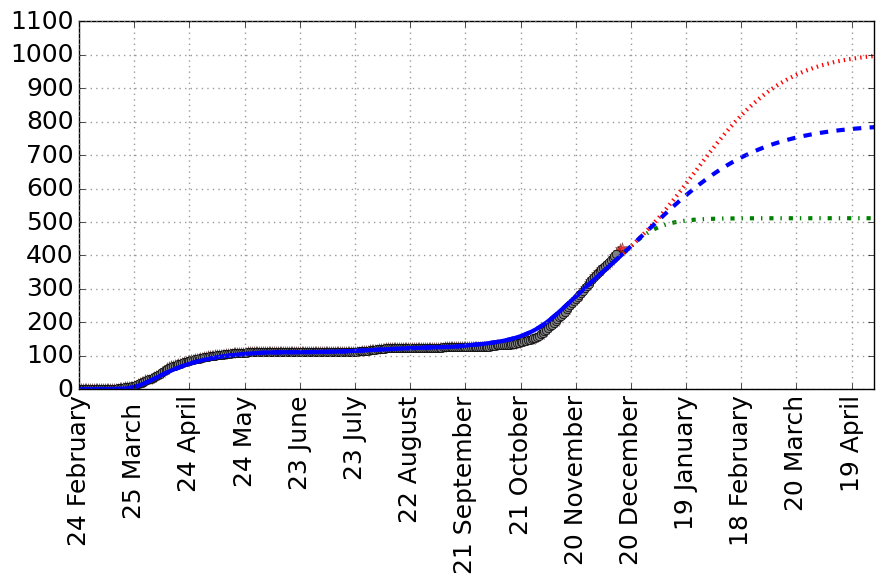

In [50]:
#plot dead
plt.figure(figsize=(9, 6),facecolor="white")

dead=df['dead']
SevenDaysMovingAverage_deadtot = ComputeSevenDaysMovingAverage(dead)
p =len(SevenDaysMovingAverage_deadtot)
    
plt.plot(times[0:p],dead,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_deadtot)-1]),alpha=0.5,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_deadtot[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t[0:NumberDaysData],(resultsseir[:,6]+resultsseir[:,15])[0:NumberDaysData]*N, label="Simulation Manual Fit", linewidth=3,color='blue')

plt.plot(t[NumberDaysData:-1],(resultsseir_Best[:,6]+resultsseir_Best[:,15])[NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
plt.plot(t[NumberDaysData:-1],(resultsseir_Worst[:,6]+resultsseir_Worst[:,15])[NumberDaysData:-1]*N,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
plt.plot(t,(resultsseir[:,6]+resultsseir[:,15])*N,'--', label="Projection if No Further Change", linewidth=3,color='blue')

UpperY3 = 1100
plt.xticks(times[only10thindex], MyListOfDates[only10thindex],fontsize=18, rotation=90)
plt.yticks(np.arange(0,UpperY3+1,100),fontsize=18)

#plt.title("Luxembourg")

#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Dead People",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/Dead_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

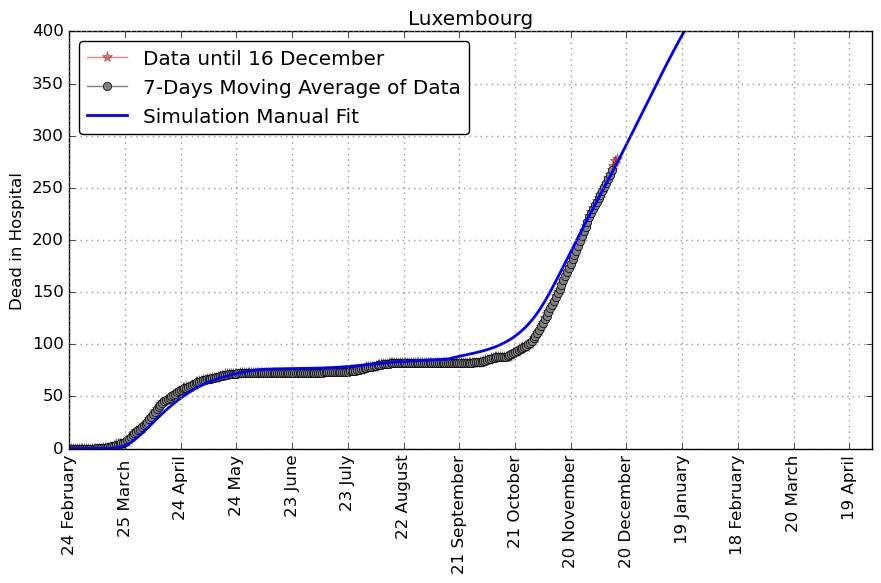

In [51]:
#plot dead in hospital

plt.figure(figsize=(9, 6),facecolor="white")

dead=df['dead_hos']
SevenDaysMovingAverage_deadhos = ComputeSevenDaysMovingAverage(dead)
p =len(SevenDaysMovingAverage_deadhos)
    
plt.plot(times[0:p],dead,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_deadhos)]),alpha=0.5,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_deadhos[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t,(resultsseir[:,6])*N, label="Simulation Manual Fit", linewidth=2,color='blue')

UpperY3 = 400
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,UpperY3+1,50))

plt.title("Luxembourg")

plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
plt.ylabel("Dead in Hospital",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/Dead_in_hos_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

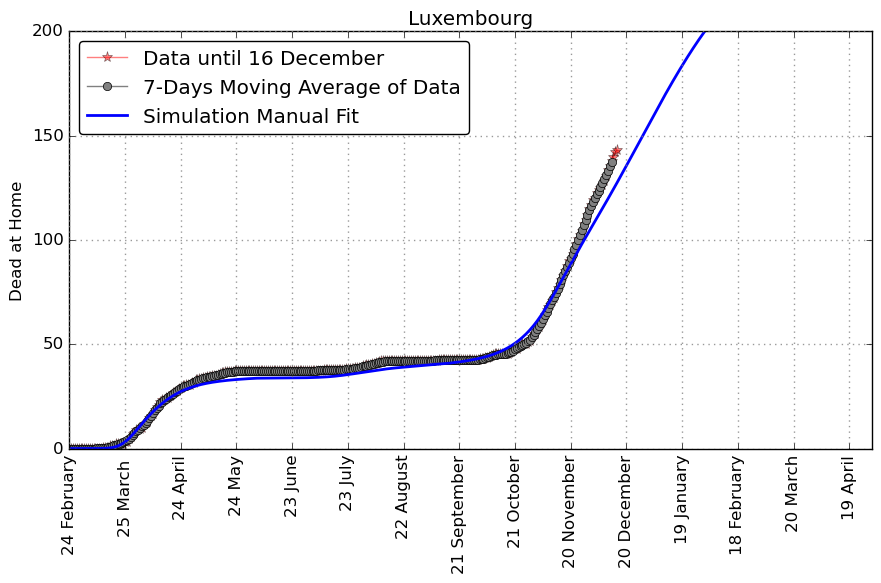

In [52]:
#plot dead at home
plt.figure(figsize=(9, 6),facecolor="white")

dead=df['dead_autre']
SevenDaysMovingAverage_deadautre = ComputeSevenDaysMovingAverage(dead)
p =len(SevenDaysMovingAverage_deadautre)
    
plt.plot(times[0:p],dead,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_deadautre)]),alpha=0.5,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_deadautre[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
plt.plot(t,(resultsseir[:,15])*N, label="Simulation Manual Fit", linewidth=2,color='blue')

UpperY3 = 200
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,UpperY3+1,50))

plt.title("Luxembourg")

plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
plt.ylabel("Dead at Home",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/Dead_at_home_SEIR-ICU_Luxembourg' + FileFormatOfFigures)

In [53]:
#############################
########## Reff(t) ##########
#############################

In [54]:
def R_eff(MyTimes,My_cases_sim,ListOfRhos):
    RhosList = rhoAsFunctionforLuxembourg(MyTimes,ListOfRhos)
    R_eff=np.zeros(len(MyTimes))
    for i in range(0, len(MyTimes)):
        rho = RhosList[i]
        R_eff[i]= beta*rho*((1-p1)*1/tau8+p1/tau1)*(My_cases_sim[i])/N
    return R_eff

In [55]:
cases_sim=(resultsseir[:,0])*N
cases_sim_Optimistic=(resultsseir_Best[:,0])*N
cases_sim_Pessimistic=(resultsseir_Worst[:,0])*N

print(cases_sim)
print(cases_sim_Optimistic)
print(cases_sim_Pessimistic)

[623179.     623178.7754 623178.2231 ... 421424.1298 421424.1298
 421424.1298]
[623179.     623178.7754 623178.2231 ... 498931.2987 498931.2987
 498931.2987]
[623179.     623178.7754 623178.2231 ... 362407.7546 362407.7546
 362407.7546]


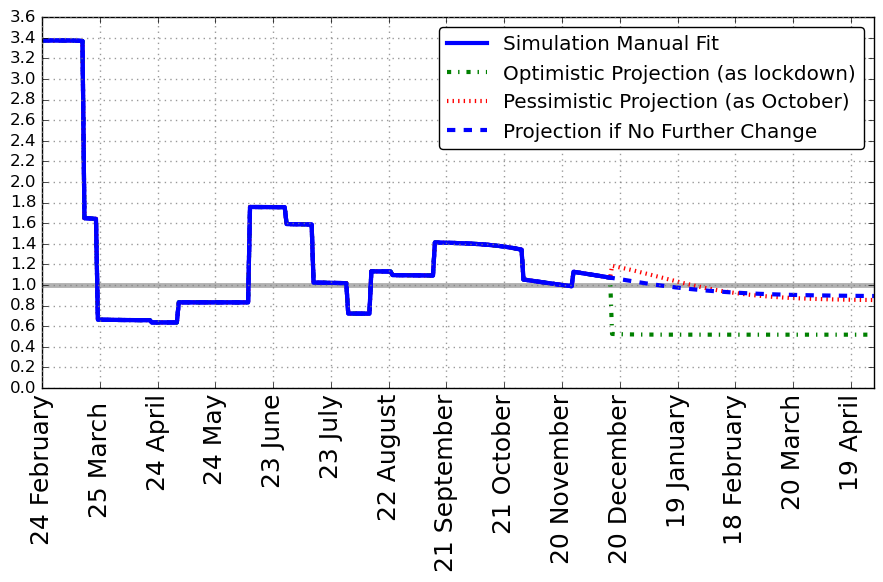

In [56]:
Reff = R_eff(times, cases_sim, ListOfRhos)
Reff_Opt = R_eff(times, cases_sim_Optimistic, List_Rho_BestScenario)
Reff_Pess = R_eff(times, cases_sim_Pessimistic, List_Rho_WorstScenario)

plt.figure(figsize=(9, 6),facecolor='white')

plt.axhline(y=1,color='gray',linewidth=3.5, alpha = 0.6)

plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-', label="Simulation Manual Fit", linewidth=3,color='blue')
plt.plot(times,Reff_Opt,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
plt.plot(times,Reff_Pess,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
plt.plot(times,Reff,'--', label="Projection if No Further Change", linewidth=3,color='blue')
plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-',linewidth=3,color='blue')

UpperY3 = 3.6

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90,fontsize=18)
plt.yticks(np.arange(0,UpperY3+1,0.2))

#plt.title('Luxembourg')

plt.legend(loc='upper right', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel(“Time”)
#plt.ylabel(r'$R_{eff}(t)$',size=18)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/R_eff_LUXEMBOURG' + FileFormatOfFigures)

In [57]:
Reff[NumberDaysData]

1.0689

0.36


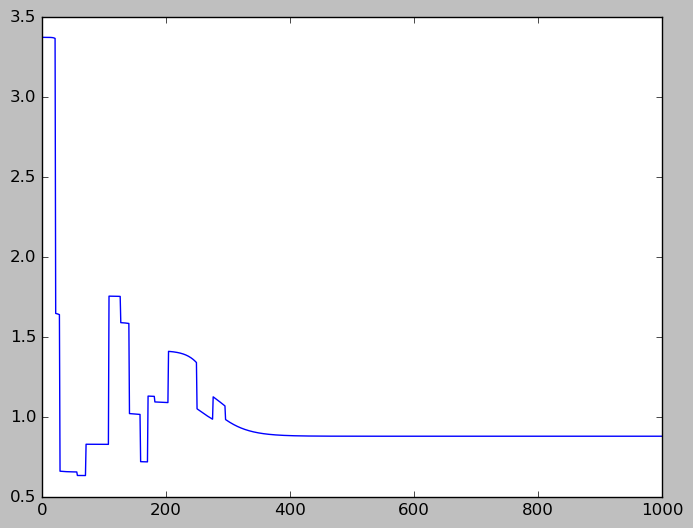

In [58]:
ListReffTODAY = []
TentativeRhosList = np.arange(0,1.01,0.01)
ListFullRefft = []
for ThisRho in TentativeRhosList:
    List_Rho_FindMaxRho_SuchThat_Refft_is_1 = list(ListOfRhos) + [ThisRho]
    resultsseir_FindRho=odeint(model_SEIRICUHOS,P2,t,(
        List_Rho_FindMaxRho_SuchThat_Refft_is_1,
        ListOfParametersfirstwave))
    cases_sim_FindRho = (resultsseir_FindRho[:,0])*N
    Reff_FindRho = R_eff(t, cases_sim_FindRho, List_Rho_FindMaxRho_SuchThat_Refft_is_1)
    ListReffTODAY.append(Reff_FindRho[NumberDaysData])
    ListFullRefft.append(Reff_FindRho)
Index_MaxRhoSuchThatRsmallerEq1 = np.where(np.array(ListReffTODAY)<=1)[0][-1]
print(TentativeRhosList[Index_MaxRhoSuchThatRsmallerEq1])
plt.plot(ListFullRefft[Index_MaxRhoSuchThatRsmallerEq1])

In [41]:
#########################################################################
### PROJECTIONS: MCMC FIT FOR ONLY LAST RHO AND SIMULATIONS SCENARIOS ###
#########################################################################

In [42]:
def gpp2_FitRho15(u,t,theta):

    
   
    ListOfRhosEceptRho15 = ListOfRhos
    ListOfRhosEceptRho15[13] = theta[0]
    
    y=model_SEIRICUHOS(u,t,ListOfRhosEceptRho15,ListOfParametersfirstwave)
    
    return y

In [43]:
def errorxy12_FitRho15(theta,data):

    N=623180
    P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
    tt=len(SevenDaysMovingAverage_TotalCases)
    RMS=np.zeros(tt+1)
    startfitRho15 = 276
    t2=np.linspace(0,tt-1,tt)
    y=data1

    resultsseir2=odeint(gpp2_FitRho15,P2,t2,args=(theta,))
    
    # S, E, R ,I ,Q, A, D,H,Hl,ICU, AICU,NI,NI1,R1,D1
    
    cc=(resultsseir2[startfitRho15:tt,2]+resultsseir2[startfitRho15:tt,3]+resultsseir2[startfitRho15:tt,4]+resultsseir2[startfitRho15:tt,6]+resultsseir2[startfitRho15:tt,7]+resultsseir2[startfitRho15:tt,8]+resultsseir2[startfitRho15:tt,9]+resultsseir2[startfitRho15:tt,10]+resultsseir2[startfitRho15:tt,11])*N-y[0,startfitRho15:tt]
    cci=((cc**2).sum(axis=0))
    
    # dead at home -> dead at home
    ai=((resultsseir2[startfitRho15:tt,15])*N-y[4,startfitRho15:tt])
    aai=((ai**2).sum(axis=0))
    
    # icu -> icu
    bi=((resultsseir2[startfitRho15:tt,9])*N- y[1,startfitRho15:tt])
    bbi=((bi**2).sum(axis=0))
    
    # hospital -> hos + aicu
    ee=((resultsseir2[startfitRho15:tt,7]+resultsseir2[startfitRho15:tt,8]+resultsseir2[startfitRho15:tt,10])*N)-y[2,startfitRho15:tt]
    eei=((ee**2).sum(axis=0))
    
    # dead in Hospital/ICU -> dead in Hospital/ICU 
    di=((resultsseir2[startfitRho15:tt,6])*N- y[3,startfitRho15:tt])
    ddi=((di**2).sum(axis=0))

    RMS= cci + eei + aai + bbi + ddi

    return RMS

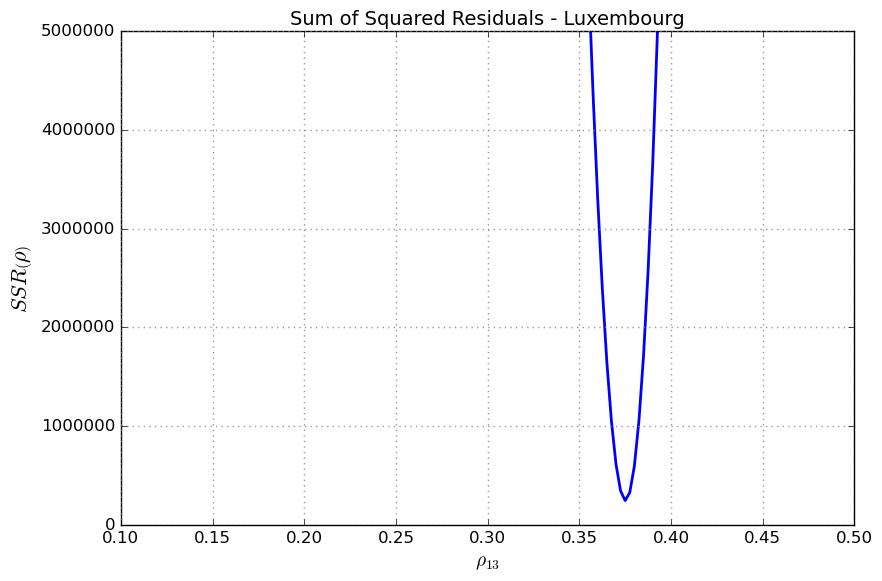

In [45]:
RhoValuesForSSR = np.arange(0.1,0.5,0.0025) 

plt.figure(figsize=(9, 6),facecolor="white")

ListOfSSR = []
for Rho in RhoValuesForSSR:
    SSR = errorxy12_FitRho15([Rho,],"useless")
    ListOfSSR.append(SSR)
ListOfSSR = np.array(ListOfSSR)
    
plt.plot(RhoValuesForSSR,ListOfSSR,'-', linewidth=2,color='blue')

plt.title("Sum of Squared Residuals - Luxembourg",size=14)

plt.xlabel(r"$\rho_{13}$",size=14)
plt.ylabel(r"$SSR\left(\rho\right)$",size=16)

plt.ylim(0,5000000)
#plt.xlim(0,0.6)

plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/SSR_Rho13' + FileFormatOfFigures)

In [ ]:
MyNew_mcstat_Rho15ONLY = MCMC(rngseed=123456789)

MyNew_mcstat_Rho15ONLY.data.add_data_set(x=df2['Date'],y=data1)

MyNew_mcstat_Rho15ONLY.parameters.add_model_parameter(name='rho13', minimum=0, maximum=1)

datestr = datetime.now().strftime('%Y%m%d_%H%M%S')
savedir = 'Saved_MCMC_Chains_Rho15ONLY_' + os.sep + str('{}_{}'.format(datestr, 'parallel_chains'))
MyNew_mcstat_Rho15ONLY.simulation_options.define_simulation_options(nsimu=int(2e3), updatesigma=True, method='dram',
                                                         savedir=savedir, savesize=100, save_to_json=True,
                                                          save_lightly=True, save_to_bin=True)
MyNew_mcstat_Rho15ONLY.model_settings.define_model_settings(sos_function=errorxy12_FitRho15)

In [ ]:
My_Parallel_MCMC_Rho15ONLY = ParallelMCMC()
My_Parallel_MCMC_Rho15ONLY.setup_parallel_simulation(MyNew_mcstat_Rho15ONLY, initial_values=None, num_cores=8, num_chain=8)

In [ ]:
# DO NOT RE-RUN THIS UNLESS YOU WISH A NEW MCMC CHAIN
My_Parallel_MCMC_Rho15ONLY.run_parallel_simulation()

In [ ]:
My_Parallel_MCMC_Rho15ONLY.display_individual_chain_statistics()

In [94]:
# IF YOU DIDN'T RUN NEW MCMC CHAINS, HERE IT IS WHERE YOU CAN LOAD THOSE RUN PREVIOUSLY AND SAVED
#'PUT HERE NAME OF FILE FOR MCMC CHAIN' # 8 chains, 10k each
DirectoryOfPreviousRunMCMC = 'Saved_MCMC_Chains_Rho15ONLY_/20201210_140940_parallel_chains'

pres_Rho15ONLY = CP.load_parallel_simulation_results(DirectoryOfPreviousRunMCMC)
combined_chains_Rho15ONLY, index_Rho15ONLY = CP.generate_combined_chain_with_index(pres_Rho15ONLY)

In [95]:
# NOW COMPUTE AN INDICATOR TO SEE IF THE MULTIPLE CHAINS HAVE CONVERGED TO THE SAME TARGET POSTERIOR DISTRIBUTION 
# OR IF YOU NEED LONGER CHAINS

# Gelman-Rubin Diagnostic (https://github.com/prmiles/pymcmcstat_examples/blob/master/Running_Parallel_Chains.ipynb)

chains_Rho15ONLY = CP.generate_chain_list(pres_Rho15ONLY)
psrf_Rho15ONLY = CS.gelman_rubin(chains=chains_Rho15ONLY, display=True)

# In general, R closer to 1 indicates your chains have converged.

Parameter: $p_{0}$
  R = 1.0128127016347725
  B = 0.0001396402626503317
  W = 5.864047229348582e-06
  V = 6.015278477600857e-06
  neff = 344.6157068703605


In [96]:
print(np.shape(chains_Rho15ONLY))

## Prepare indexes to cut chains, only 1 point every 100

burnin = 0 # 100

# Cut chains and concatenate them
MyChain_Rho15ONLY = chains_Rho15ONLY[0][:,:]
MyChain_BurninRemoved_Rho15ONLY = MyChain_Rho15ONLY[burnin::,:]
ConcatenatedExtractedChains_Rho15ONLY = MyChain_BurninRemoved_Rho15ONLY
print(np.shape(ConcatenatedExtractedChains_Rho15ONLY))
for i in range(7):
    # Take out first 10000 of each chain i.e. burnin of the points left) for burnin
    MyChain_Rho15ONLY = chains_Rho15ONLY[i+1][:,:]
    MyChain_BurninRemoved_Rho15ONLY = MyChain_Rho15ONLY[burnin::,:]
    
    # Than concatenate
    ConcatenatedExtractedChains_Rho15ONLY = np.concatenate((ConcatenatedExtractedChains_Rho15ONLY,MyChain_BurninRemoved_Rho15ONLY),axis=0)
print(np.shape(ConcatenatedExtractedChains_Rho15ONLY))


(8, 1000, 1)
(1000, 1)
(8000, 1)


<Figure size 640x480 with 0 Axes>

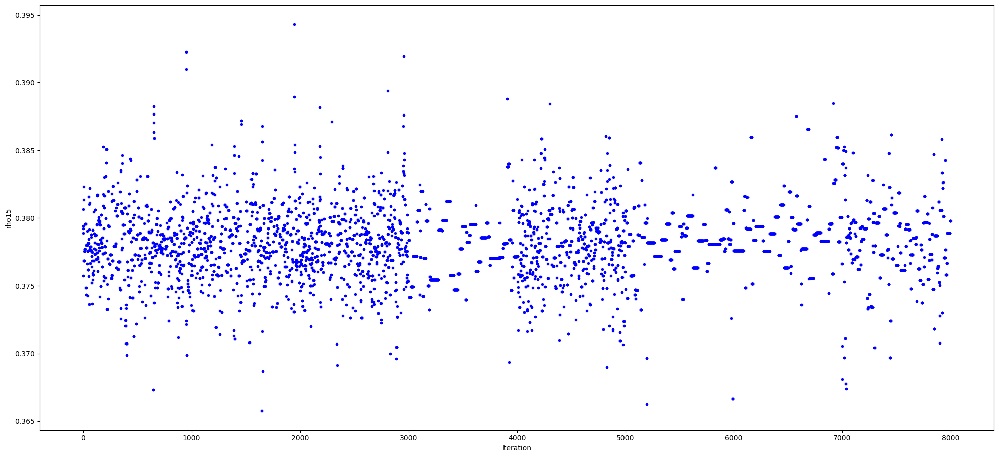

In [97]:
plt.style.use('default') # 'ggplot' Other styles at https://matplotlib.org/3.1.1/gallery/style_sheets/style_sheets_reference.html
plt.figure(facecolor="white")
settings = dict(
    fig=dict(figsize=(20, 10))
)
NamesParamsParallelChains_Rho15ONLY =['rho15']

mcp.plot_chain_panel(ConcatenatedExtractedChains_Rho15ONLY,NamesParamsParallelChains_Rho15ONLY, settings,maxpoints=1000000)
plt.savefig('./Results_Luxembourg/MCMC_Chains_Rho15only' + FileFormatOfFigures)

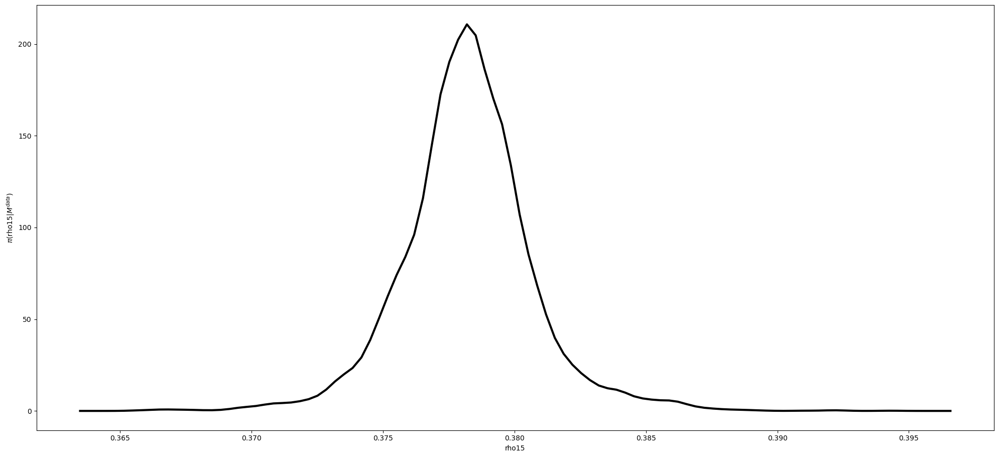

In [98]:
mcp.plot_density_panel(ConcatenatedExtractedChains_Rho15ONLY,NamesParamsParallelChains_Rho15ONLY, settings)
plt.savefig('./Results_Luxembourg/1DPosterior_Rho15only' + FileFormatOfFigures)

In [99]:
np.shape(ConcatenatedExtractedChains_Rho15ONLY)

(8000, 1)

0.3782558713714932


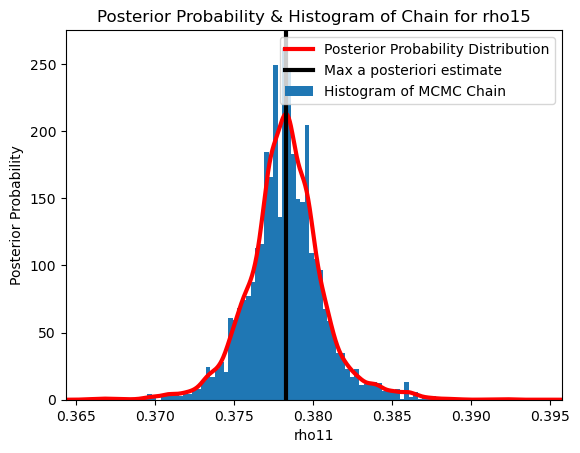

In [100]:
# GET THE MAXIMUM A POSTERIORI ESTIMATE OF THE PARAM RHO_13

plt.figure(facecolor="white")

Chains = ConcatenatedExtractedChains_Rho15ONLY

plt.hist(Chains[:,0], density=True, bins=100, label="Histogram of MCMC Chain")
mn, mx = plt.xlim()
plt.xlim(mn, mx)
kde_xs = np.linspace(mn, mx, 1000)
kde = st.gaussian_kde(Chains[:,0])
plt.plot(kde_xs,kde.pdf(kde_xs),label="Posterior Probability Distribution",linewidth=3,color='red')
plt.ylabel('Posterior Probability')
plt.xlabel('rho11')
plt.title("Posterior Probability & Histogram of Chain for rho15")
posterior=list(kde.pdf(kde_xs))
a=posterior.index(max(posterior))
plt.axvline(x=kde_xs[a],linewidth=3,color='black',label='Max a posteriori estimate')
plt.legend(loc="best")

MaxEstimate_Rho15ONLY = kde_xs[a]
print(MaxEstimate_Rho15ONLY)

In [101]:
# GET THE MEAN A POSTERIORI ESTIMATE OF THE PARAM RHO_11
MeanEstimate_Rho15ONLY = statistics.mean(Chains[:,0])
print(MeanEstimate_Rho15ONLY)

0.37821675121627435


In [102]:
import pymc3
from scipy.stats import norm

##### Example CREDIBLE INTERVAL 1D #####

# to extract Credible Intervals from a 1D distribution of values (i.e. a 1D chain for 1 parameter from MCMC)
# Default provides the 94% Credible Interval
CredibleInterval_Default = pymc3.stats.hpd(ConcatenatedExtractedChains_Rho15ONLY)

# Calculate boundaries of credible intervals for highest posterior density (HPD) of array for given probability. 
# The HPD is the minimum width Bayesian credible interval (BCI).

### 90% Credible Intervals ###
CredibleInterval_50 = pymc3.stats.hpd(ConcatenatedExtractedChains_Rho15ONLY,credible_interval=0.5)

### 90% Credible Intervals ###
CredibleInterval_90 = pymc3.stats.hpd(ConcatenatedExtractedChains_Rho15ONLY,credible_interval=0.9)

### 95% Credible Intervals ###
CredibleInterval_95 = pymc3.stats.hpd(ConcatenatedExtractedChains_Rho15ONLY,credible_interval=0.95)

### 99% Credible Intervals ###
CredibleInterval_99 = pymc3.stats.hpd(ConcatenatedExtractedChains_Rho15ONLY,credible_interval=0.99)

print(CredibleInterval_Default)
print( )
print(CredibleInterval_50)
print(CredibleInterval_90) 
print(CredibleInterval_95) 
print(CredibleInterval_99) 

[[0.3734 0.3828]]

[[0.3771 0.3796]]
[[0.3747 0.3823]]
[[0.3731 0.3832]]
[[0.3705 0.386 ]]


In [103]:
### Run the model with the Rho15 just obtained###

# Model Best Fit
resultsseirRho15=odeint(gpp2_FitRho15,P2,t,([MaxEstimate_Rho15ONLY],)) 

# Models Uncertainties / Credible Intervals
resultsseirUp99perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_99[0][1]],))
resultsseirLow99perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_99[0][0]],))
resultsseirUp90perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_90[0][1]],))
resultsseirLow90perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_90[0][0]],))
resultsseirUp50perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_50[0][1]],))
resultsseirLow50perc=odeint(gpp2_FitRho15,P2,t,([CredibleInterval_50[0][0]],))


ReferenceRhoOCTOBER = ListOfRhos[11]
resultsseirMEASURES95 = odeint(gpp2_FitRho15,P2,t,([ReferenceRhoOCTOBER],))
resultsseirMEASURES90 = odeint(gpp2_FitRho15,P2,t,([0.9 * ReferenceRhoOCTOBER],))
resultsseirMEASURES80 = odeint(gpp2_FitRho15,P2,t,([0.8 * ReferenceRhoOCTOBER],))
resultsseirMEASURES70 = odeint(gpp2_FitRho15,P2,t,([0.7 * ReferenceRhoOCTOBER],))
resultsseirMEASURES60 = odeint(gpp2_FitRho15,P2,t,([0.6 * ReferenceRhoOCTOBER],))
resultsseirMEASURES50 = odeint(gpp2_FitRho15,P2,t,([0.5 * ReferenceRhoOCTOBER],))

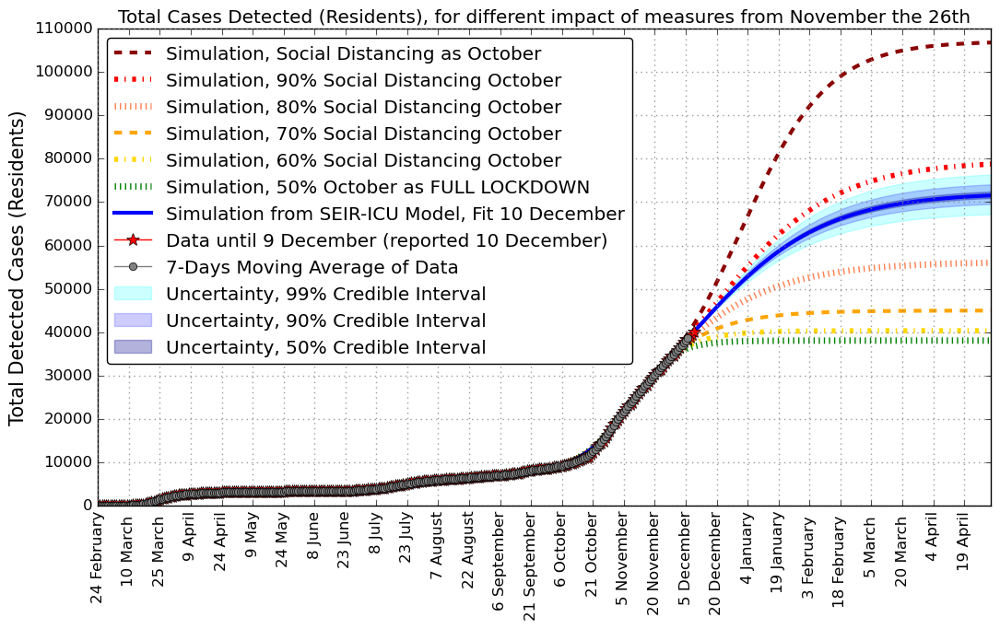

In [104]:
### PLOT TOTAL CASES ###

plt.style.use('ggplot')

mpl.rc("figure", facecolor="white")
mpl.style.use('classic')

plt.figure(figsize=(11, 7),facecolor="white")

DI = df['new_cases_cum']
SevenDaysMovingAverageOf_NewDailyCases_DataII = ComputeSevenDaysMovingAverage(DI)
p=len(SevenDaysMovingAverageOf_NewDailyCases_DataII)

TotalCases_Up99perc = (resultsseirUp99perc[:,2]+resultsseirUp99perc[:,3]+resultsseirUp99perc[:,4]+resultsseirUp99perc[:,6]+resultsseirUp99perc[:,7]+resultsseirUp99perc[:,8]+resultsseirUp99perc[:,9]+resultsseirUp99perc[:,10]+resultsseirUp99perc[:,11])*N
TotalCases_Low99perc = (resultsseirLow99perc[:,2]+resultsseirLow99perc[:,3]+resultsseirLow99perc[:,4]+resultsseirLow99perc[:,6]+resultsseirLow99perc[:,7]+resultsseirLow99perc[:,8]+resultsseirLow99perc[:,9]+resultsseirLow99perc[:,10]+resultsseirLow99perc[:,11])*N
plt.fill_between(t, TotalCases_Up99perc, TotalCases_Low99perc, color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')

TotalCases_Up90perc = (resultsseirUp90perc[:,2]+resultsseirUp90perc[:,3]+resultsseirUp90perc[:,4]+resultsseirUp90perc[:,6]+resultsseirUp90perc[:,7]+resultsseirUp90perc[:,8]+resultsseirUp90perc[:,9]+resultsseirUp90perc[:,10]+resultsseirUp90perc[:,11])*N
TotalCases_Low90perc = (resultsseirLow90perc[:,2]+resultsseirLow90perc[:,3]+resultsseirLow90perc[:,4]+resultsseirLow90perc[:,6]+resultsseirLow90perc[:,7]+resultsseirLow90perc[:,8]+resultsseirLow90perc[:,9]+resultsseirLow90perc[:,10]+resultsseirLow90perc[:,11])*N
plt.fill_between(t, TotalCases_Up90perc, TotalCases_Low90perc, color='blue', alpha=0.2, label='Uncertainty, 90% Credible Interval')

TotalCases_Up50perc = (resultsseirUp50perc[:,2]+resultsseirUp50perc[:,3]+resultsseirUp50perc[:,4]+resultsseirUp50perc[:,6]+resultsseirUp50perc[:,7]+resultsseirUp50perc[:,8]+resultsseirUp50perc[:,9]+resultsseirUp50perc[:,10]+resultsseirUp50perc[:,11])*N
TotalCases_Low50perc = (resultsseirLow50perc[:,2]+resultsseirLow50perc[:,3]+resultsseirLow50perc[:,4]+resultsseirLow50perc[:,6]+resultsseirLow50perc[:,7]+resultsseirLow50perc[:,8]+resultsseirLow50perc[:,9]+resultsseirLow50perc[:,10]+resultsseirLow50perc[:,11])*N
plt.fill_between(t, TotalCases_Up50perc, TotalCases_Low50perc, color='darkblue', alpha=0.3, label='Uncertainty, 50% Credible Interval')

plt.plot(t,(resultsseirMEASURES95[:,2]+resultsseirMEASURES95[:,3]+resultsseirMEASURES95[:,4]+resultsseirMEASURES95[:,6]+resultsseirMEASURES95[:,7]+resultsseirMEASURES95[:,8]+resultsseirMEASURES95[:,9]+resultsseirMEASURES95[:,10]+resultsseirMEASURES95[:,11])*N, label=r"Simulation, Social Distancing as October", color = 'darkred',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES90[:,2]+resultsseirMEASURES90[:,3]+resultsseirMEASURES90[:,4]+resultsseirMEASURES90[:,6]+resultsseirMEASURES90[:,7]+resultsseirMEASURES90[:,8]+resultsseirMEASURES90[:,9]+resultsseirMEASURES90[:,10]+resultsseirMEASURES90[:,11])*N, label=r"Simulation, 90% Social Distancing October", color = 'red',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES80[:,2]+resultsseirMEASURES80[:,3]+resultsseirMEASURES80[:,4]+resultsseirMEASURES80[:,6]+resultsseirMEASURES80[:,7]+resultsseirMEASURES80[:,8]+resultsseirMEASURES80[:,9]+resultsseirMEASURES80[:,10]+resultsseirMEASURES80[:,11])*N, label=r"Simulation, 80% Social Distancing October", color = 'coral',linewidth=5,linestyle=':')
plt.plot(t,(resultsseirMEASURES70[:,2]+resultsseirMEASURES70[:,3]+resultsseirMEASURES70[:,4]+resultsseirMEASURES70[:,6]+resultsseirMEASURES70[:,7]+resultsseirMEASURES70[:,8]+resultsseirMEASURES70[:,9]+resultsseirMEASURES70[:,10]+resultsseirMEASURES70[:,11])*N, label=r"Simulation, 70% Social Distancing October", color = 'orange',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES60[:,2]+resultsseirMEASURES60[:,3]+resultsseirMEASURES60[:,4]+resultsseirMEASURES60[:,6]+resultsseirMEASURES60[:,7]+resultsseirMEASURES60[:,8]+resultsseirMEASURES60[:,9]+resultsseirMEASURES60[:,10]+resultsseirMEASURES60[:,11])*N, label=r"Simulation, 60% Social Distancing October", color = 'gold',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES50[:,2]+resultsseirMEASURES50[:,3]+resultsseirMEASURES50[:,4]+resultsseirMEASURES50[:,6]+resultsseirMEASURES50[:,7]+resultsseirMEASURES50[:,8]+resultsseirMEASURES50[:,9]+resultsseirMEASURES50[:,10]+resultsseirMEASURES50[:,11])*N, label=r"Simulation, 50% October as FULL LOCKDOWN", color = 'green',linewidth=5,linestyle=':')

plt.plot(t,(resultsseirRho15[:,2]+resultsseirRho15[:,3]+resultsseirRho15[:,4]+resultsseirRho15[:,6]+resultsseirRho15[:,7]+resultsseirRho15[:,8]+resultsseirRho15[:,9]+resultsseirRho15[:,10]+resultsseirRho15[:,11])*N, label="Simulation from SEIR-ICU Model, Fit "+ str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)]), color = 'blue',linewidth=3)

plt.plot(times[0:p],DI,'-*',ms=10,color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])+" (reported " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)])+")",alpha=1)#0.3)
plt.plot(times[0:p-3],SevenDaysMovingAverageOf_NewDailyCases_DataII[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')#+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1]))

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,120001,10000))
plt.ylabel("Total Detected Cases (Residents)",size=15)
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,110000)

plt.title('Total Cases Detected (Residents), for different impact of measures from November the 26th')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.tight_layout()

#plt.ylim(6000,45000)
#plt.xlim(200,300)

plt.savefig('./Results_Luxembourg/TotalCases_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

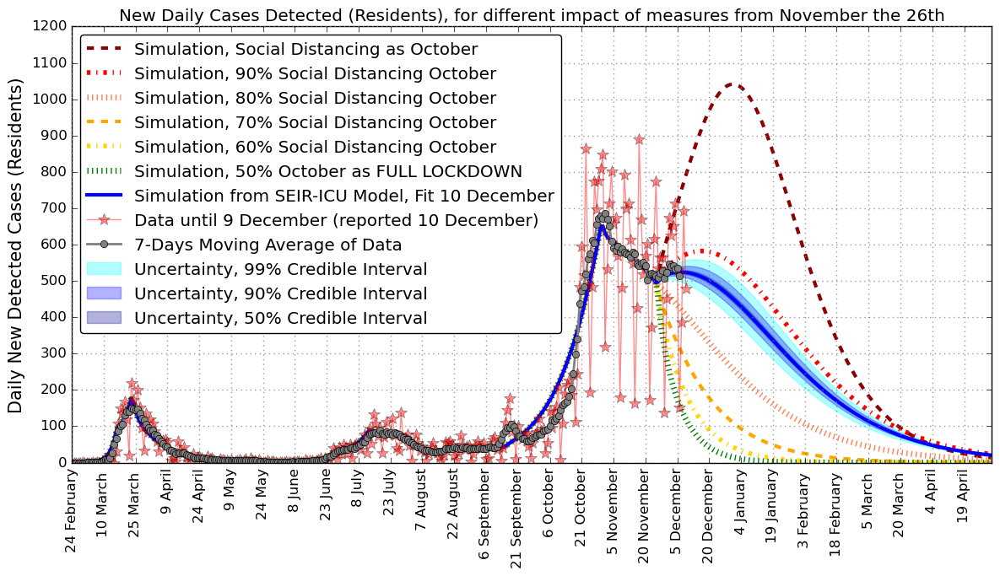

In [105]:
### PLOT NEW DAILY CASES ###

plt.figure(figsize=(12, 7),facecolor="white")

resultsseirTotCases = (resultsseirRho15[:,2]+resultsseirRho15[:,3]+resultsseirRho15[:,4]+resultsseirRho15[:,6]+resultsseirRho15[:,7]+resultsseirRho15[:,8]+resultsseirRho15[:,9]+resultsseirRho15[:,10]+resultsseirRho15[:,11])*N

TotalCases95 = (resultsseirMEASURES95[:,2]+resultsseirMEASURES95[:,3]+resultsseirMEASURES95[:,4]+resultsseirMEASURES95[:,6]+resultsseirMEASURES95[:,7]+resultsseirMEASURES95[:,8]+resultsseirMEASURES95[:,9]+resultsseirMEASURES95[:,10]+resultsseirMEASURES95[:,11])*N
TotalCases90 = (resultsseirMEASURES90[:,2]+resultsseirMEASURES90[:,3]+resultsseirMEASURES90[:,4]+resultsseirMEASURES90[:,6]+resultsseirMEASURES90[:,7]+resultsseirMEASURES90[:,8]+resultsseirMEASURES90[:,9]+resultsseirMEASURES90[:,10]+resultsseirMEASURES90[:,11])*N
TotalCases80 = (resultsseirMEASURES80[:,2]+resultsseirMEASURES80[:,3]+resultsseirMEASURES80[:,4]+resultsseirMEASURES80[:,6]+resultsseirMEASURES80[:,7]+resultsseirMEASURES80[:,8]+resultsseirMEASURES80[:,9]+resultsseirMEASURES80[:,10]+resultsseirMEASURES80[:,11])*N
TotalCases70 = (resultsseirMEASURES70[:,2]+resultsseirMEASURES70[:,3]+resultsseirMEASURES70[:,4]+resultsseirMEASURES70[:,6]+resultsseirMEASURES70[:,7]+resultsseirMEASURES70[:,8]+resultsseirMEASURES70[:,9]+resultsseirMEASURES70[:,10]+resultsseirMEASURES70[:,11])*N
TotalCases60 = (resultsseirMEASURES60[:,2]+resultsseirMEASURES60[:,3]+resultsseirMEASURES60[:,4]+resultsseirMEASURES60[:,6]+resultsseirMEASURES60[:,7]+resultsseirMEASURES60[:,8]+resultsseirMEASURES60[:,9]+resultsseirMEASURES60[:,10]+resultsseirMEASURES60[:,11])*N
TotalCases50 = (resultsseirMEASURES50[:,2]+resultsseirMEASURES50[:,3]+resultsseirMEASURES50[:,4]+resultsseirMEASURES50[:,6]+resultsseirMEASURES50[:,7]+resultsseirMEASURES50[:,8]+resultsseirMEASURES50[:,9]+resultsseirMEASURES50[:,10]+resultsseirMEASURES50[:,11])*N

ListOfDailyCases = []
for yo in [resultsseirTotCases,TotalCases_Up50perc,TotalCases_Low50perc,TotalCases_Up90perc,TotalCases_Low90perc,TotalCases95,TotalCases90,TotalCases80,TotalCases70,TotalCases60,TotalCases50,TotalCases_Up99perc,TotalCases_Low99perc]:
    yo[0]
    pp=len(yo)
    i1=np.arange(0,1001,1)
    yu=np.zeros(1001)
    for ii in range(0,1000):    
        yu[ii]= yo[ii+1]-yo[ii]
    ListOfDailyCases.append(yu)
    
plt.fill_between(t, ListOfDailyCases[11], ListOfDailyCases[12], color='cyan', alpha=0.3, label='Uncertainty, 99% Credible Interval')
plt.fill_between(t, ListOfDailyCases[3], ListOfDailyCases[4], color='blue', alpha=0.3, label='Uncertainty, 90% Credible Interval')
plt.fill_between(t, ListOfDailyCases[1], ListOfDailyCases[2], color='darkblue', alpha=0.3, label='Uncertainty, 50% Credible Interval')

plt.plot(i1[0:pp+1],ListOfDailyCases[5],label=r"Simulation, Social Distancing as October", color = 'darkred',linewidth=3,linestyle='--')
plt.plot(i1[0:pp+1],ListOfDailyCases[6],label=r"Simulation, 90% Social Distancing October", color = 'red',linewidth=4,linestyle='-.')
plt.plot(i1[0:pp+1],ListOfDailyCases[7],label=r"Simulation, 80% Social Distancing October", color = 'coral',linewidth=5,linestyle=':')
plt.plot(i1[0:pp+1],ListOfDailyCases[8],label=r"Simulation, 70% Social Distancing October", color = 'orange',linewidth=3,linestyle='--')
plt.plot(i1[0:pp+1],ListOfDailyCases[9],label=r"Simulation, 60% Social Distancing October", color = 'gold',linewidth=4,linestyle='-.')
plt.plot(i1[0:pp+1],ListOfDailyCases[10],label=r"Simulation, 50% October as FULL LOCKDOWN", color = 'green',linewidth=5,linestyle=':')

plt.plot(i1[0:pp+1],ListOfDailyCases[0],label="Simulation from SEIR-ICU Model, Fit "+ str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)]), color = 'blue',linewidth=3)

DI1 = df['new_cases']
SevenDaysMovingAverageOf_NewDailyCases_DataII1 = ComputeSevenDaysMovingAverage(DI1)
p=len(SevenDaysMovingAverageOf_NewDailyCases_DataII1)

plt.plot(times[0:p],DI1,'-*',ms=10,color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])+" (reported " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)])+")",alpha=0.45)#0.3)
plt.plot(times[0:p-3],SevenDaysMovingAverageOf_NewDailyCases_DataII1[0:p-3],'o-',linewidth=2,color='grey',label="7-Days Moving Average of Data")

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,1501,100))
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,1200)
plt.ylabel("Daily New Detected Cases (Residents)",size=15)

plt.title('New Daily Cases Detected (Residents), for different impact of measures from November the 26th')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc = 'upper left', fancybox=True, numpoints=1)
plt.tight_layout()

#plt.yticks(np.arange(0,2501,100))
#plt.xticks(np.arange(0,300,1))
#plt.ylim(0,1000)
#plt.xlim(150,305)

plt.savefig('./Results_Luxembourg/DailyCases_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

In [106]:
list_of_tuples = list(zip(MyListOfDates,ListOfDailyCases[0],ListOfDailyCases[6],ListOfDailyCases[7],ListOfDailyCases[8],ListOfDailyCases[9]))
df2 = pd.DataFrame(list_of_tuples,columns=['Date','Cases_with_rho_best_fit_to_data','Cases_with_rho_before_measures_reduced_to_90%','Cases_with_rho_before_measures_reduced_to_80%','Cases_with_rho_before_measures_reduced_to_70%','Cases_with_rho_before_measures_reduced_to_60%'])
df2.to_csv(r'dataframe_daily_cases_with_different_rhos_results_model.csv', index = False)

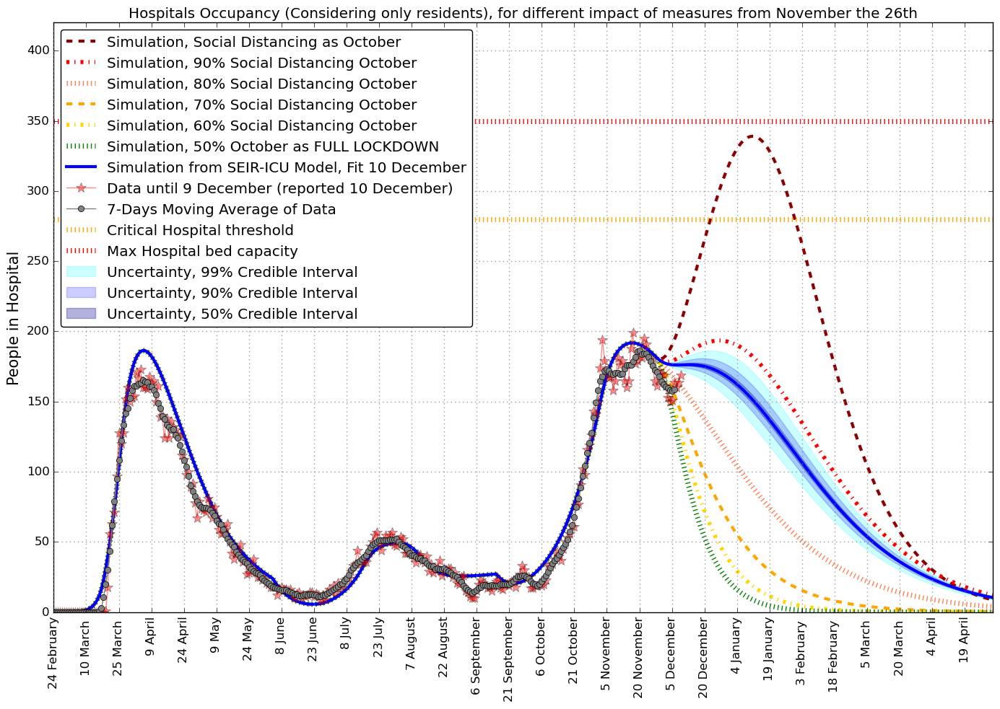

In [107]:
### PLOT HOSPITALS ###

plt.figure(figsize=(14, 10),facecolor="white")

H = df['COVIDsoinsnormaux']
SevenDaysMovingAverageOf_NewDailyCases_hos = ComputeSevenDaysMovingAverage(H)
o=len(SevenDaysMovingAverageOf_NewDailyCases_hos)

plt.fill_between(t, (resultsseirUp99perc[:,7]+resultsseirUp99perc[:,8]+resultsseirUp99perc[:,10])*N, (resultsseirLow99perc[:,7]+resultsseirLow99perc[:,8]+resultsseirLow99perc[:,10])*N, color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')
plt.fill_between(t, (resultsseirUp90perc[:,7]+resultsseirUp90perc[:,8]+resultsseirUp90perc[:,10])*N, (resultsseirLow90perc[:,7]+resultsseirLow90perc[:,8]+resultsseirLow90perc[:,10])*N, color='blue', alpha=0.2, label='Uncertainty, 90% Credible Interval')
plt.fill_between(t, (resultsseirUp50perc[:,7]+resultsseirUp50perc[:,8]+resultsseirUp50perc[:,10])*N, (resultsseirLow50perc[:,7]+resultsseirLow50perc[:,8]+resultsseirLow50perc[:,10])*N, color='darkblue', alpha=0.3, label='Uncertainty, 50% Credible Interval')

#plt.fill_between(t, (resultsseirUp50perc[:,7]+resultsseirUp50perc[:,8]+resultsseirUp50perc[:,10])*N, (resultsseirLow50perc[:,7]+resultsseirLow50perc[:,8]+resultsseirLow50perc[:,10])*N, color='blue', alpha=0.15, label='Uncertainty, 50% Credible Interval')

plt.plot(t,(resultsseirMEASURES95[:,7]+resultsseirMEASURES95[:,8]+resultsseirMEASURES95[:,10])*N,label=r"Simulation, Social Distancing as October", color = 'darkred',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES90[:,7]+resultsseirMEASURES90[:,8]+resultsseirMEASURES90[:,10])*N,label=r"Simulation, 90% Social Distancing October", color = 'red',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES80[:,7]+resultsseirMEASURES80[:,8]+resultsseirMEASURES80[:,10])*N,label=r"Simulation, 80% Social Distancing October", color = 'coral',linewidth=5,linestyle=':')
plt.plot(t,(resultsseirMEASURES70[:,7]+resultsseirMEASURES70[:,8]+resultsseirMEASURES70[:,10])*N,label=r"Simulation, 70% Social Distancing October", color = 'orange',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES60[:,7]+resultsseirMEASURES60[:,8]+resultsseirMEASURES60[:,10])*N,label=r"Simulation, 60% Social Distancing October", color = 'gold',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES50[:,7]+resultsseirMEASURES50[:,8]+resultsseirMEASURES50[:,10])*N,label=r"Simulation, 50% October as FULL LOCKDOWN", color = 'green',linewidth=5,linestyle=':')

plt.plot(t,(resultsseirRho15[:,7]+resultsseirRho15[:,8]+resultsseirRho15[:,10])*N,label="Simulation from SEIR-ICU Model, Fit " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)]), color = 'blue',linewidth=3)

plt.plot(times[0:p],H,'-*',ms=10,color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])+" (reported " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)])+")",alpha=0.45)#0.3)
plt.plot(range(o-3),SevenDaysMovingAverageOf_NewDailyCases_hos[0:-3],'-o',color='grey',label="7-Days Moving Average of Data")    

plt.axhline(y=280, color='orange', linestyle=':',lw=5,label="Critical Hospital threshold")
plt.axhline(y=350, color='r', linestyle=':',lw=5,label="Max Hospital bed capacity")

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,1001,50))
plt.ylabel("People in Hospital",size=15)
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,420) 

plt.title('Hospitals Occupancy (Considering only residents), for different impact of measures from November the 26th')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.tight_layout()

#plt.xticks(np.arange(0,300,1))
#plt.ylim(100,600)
#plt.xlim(250,265)

plt.savefig('./Results_Luxembourg/Hospitals_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

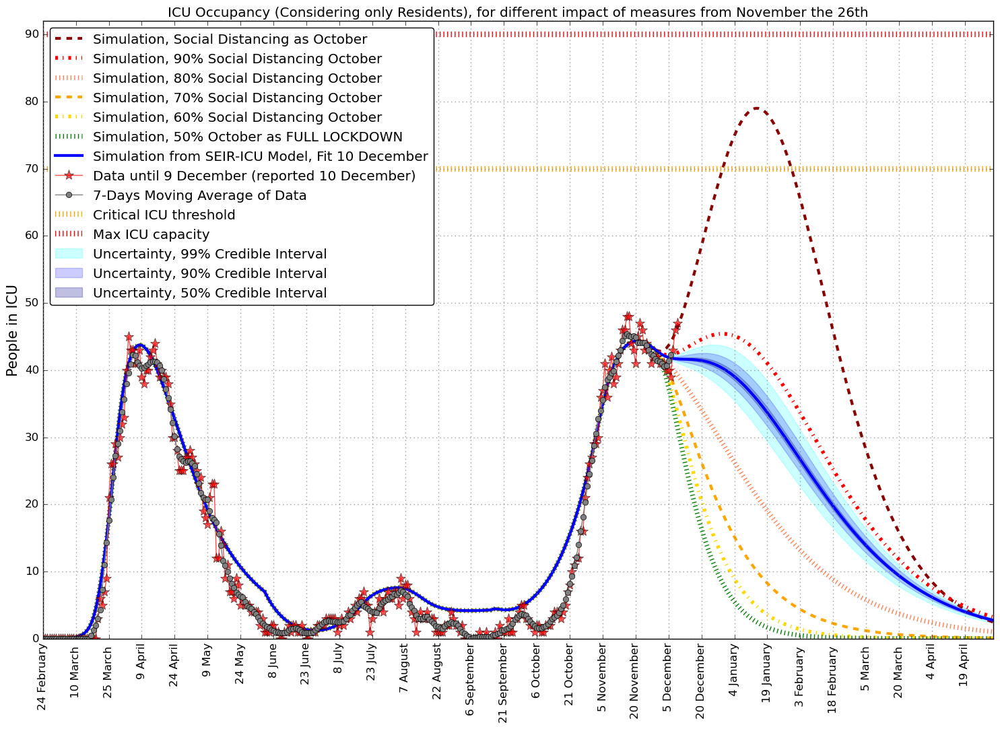

In [113]:
### PLOT ICUs ###

plt.figure(figsize=(15, 11),facecolor="white")

icu1 = df['COVIDensoinsintensifs']
SevenDaysMovingAverageOf_NewDailyCases_Da = ComputeSevenDaysMovingAverage(icu1)
o=len(SevenDaysMovingAverageOf_NewDailyCases_Da)
    
plt.fill_between(t, (resultsseirUp99perc[:,9])*N, (resultsseirLow99perc[:,9])*N, color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')
plt.fill_between(t, (resultsseirUp90perc[:,9])*N, (resultsseirLow90perc[:,9])*N, color='blue', alpha=0.2, label='Uncertainty, 90% Credible Interval')
plt.fill_between(t, (resultsseirUp50perc[:,9])*N, (resultsseirLow50perc[:,9])*N, color='darkblue', alpha=0.25, label='Uncertainty, 50% Credible Interval')

#plt.fill_between(t, (resultsseirUp50perc[:,9])*N, (resultsseirLow50perc[:,9])*N, color='blue', alpha=0.15, label='Uncertainty, 50% Credible Interval')

plt.plot(t,(resultsseirMEASURES95[:,9])*N,label=r"Simulation, Social Distancing as October", color = 'darkred',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES90[:,9])*N,label=r"Simulation, 90% Social Distancing October", color = 'red',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES80[:,9])*N,label=r"Simulation, 80% Social Distancing October", color = 'coral',linewidth=5,linestyle=':')
plt.plot(t,(resultsseirMEASURES70[:,9])*N,label=r"Simulation, 70% Social Distancing October", color = 'orange',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES60[:,9])*N,label=r"Simulation, 60% Social Distancing October", color = 'gold',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES50[:,9])*N,label=r"Simulation, 50% October as FULL LOCKDOWN", color = 'green',linewidth=5,linestyle=':')

plt.plot(t,(resultsseirRho15[:,9])*N,label="Simulation from SEIR-ICU Model, Fit " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)]), color = 'blue',linewidth=3)

plt.plot(times[0:p],icu1,'-*',ms=11,color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])+" (reported " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)])+")",alpha=0.7)#,alpha=0.45)#0.45)#0.3)
plt.plot(range (len(icu1)-3),SevenDaysMovingAverageOf_NewDailyCases_Da[0:-3],'-o',color='grey',label="7-Days Moving Average of Data") #+ str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])

plt.axhline(y=70, color='orange', linestyle=':',lw=6,label="Critical ICU threshold")
plt.axhline(y=90, color='r', linestyle=':',lw=6,label="Max ICU capacity")
 
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,151,10))
plt.ylabel("People in ICU",size=15)
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,92)#100)

plt.title('ICU Occupancy (Considering only Residents), for different impact of measures from November the 26th')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc = 'upper left', fancybox=True, numpoints=1)
plt.tight_layout()

#plt.yticks(np.arange(0,1101,10))
#plt.xticks(np.arange(0,300,1))
#plt.ylim(0,70)
#plt.xlim(200,280)

plt.savefig('./Results_Luxembourg/ICU_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

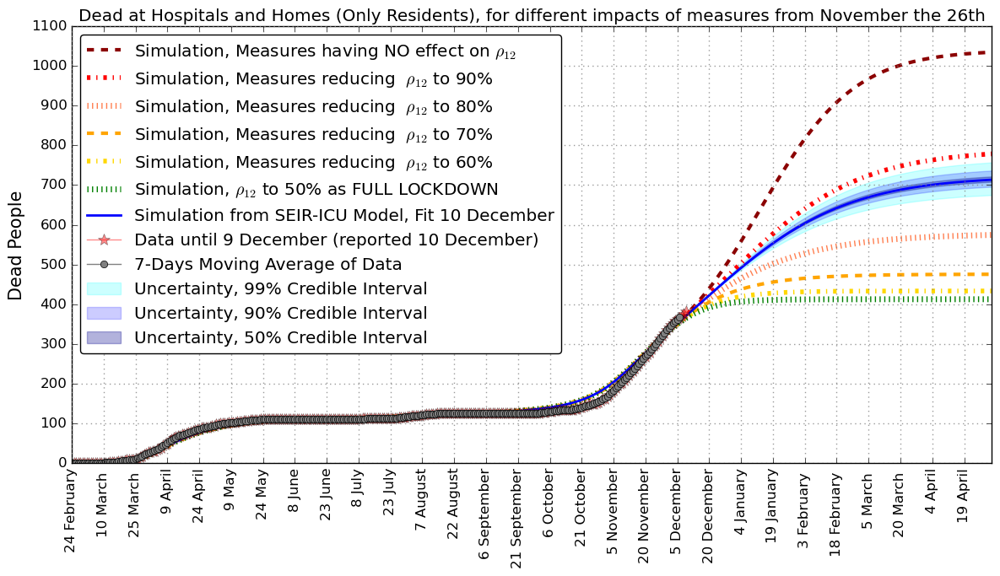

In [114]:
### PLOT DEAD TOTAL ###

plt.figure(figsize=(12, 7),facecolor="white")

dead = df['dead']
SevenDaysMovingAverageOf_NewDailyCases_Dat = ComputeSevenDaysMovingAverage(dead)
q=len(SevenDaysMovingAverageOf_NewDailyCases_Dat)

plt.fill_between(t, (resultsseirUp99perc[:,6]+resultsseirUp99perc[:,15])*N, (resultsseirLow99perc[:,6]+resultsseirLow99perc[:,15])*N, color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')
plt.fill_between(t, (resultsseirUp90perc[:,6]+resultsseirUp90perc[:,15])*N, (resultsseirLow90perc[:,6]+resultsseirLow90perc[:,15])*N, color='blue', alpha=0.2, label='Uncertainty, 90% Credible Interval')
plt.fill_between(t, (resultsseirUp50perc[:,6]+resultsseirUp50perc[:,15])*N, (resultsseirLow50perc[:,6]+resultsseirLow50perc[:,15])*N, color='darkblue', alpha=0.3, label='Uncertainty, 50% Credible Interval')

# plt.fill_between(t, (resultsseirUp50perc[:,6]+resultsseirUp50perc[:,15])*N, (resultsseirLow50perc[:,6]+resultsseirLow50perc[:,15])*N, color='blue', alpha=0.15, label='Uncertainty, 50% Credible Interval')

plt.plot(t,(resultsseirMEASURES95[:,6]+resultsseirMEASURES95[:,15])*N,label=r"Simulation, Measures having NO effect on $\rho_{12}$", color = 'darkred',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES90[:,6]+resultsseirMEASURES90[:,15])*N,label=r"Simulation, Measures reducing  $\rho_{12}$ to 90%", color = 'red',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES80[:,6]+resultsseirMEASURES80[:,15])*N,label=r"Simulation, Measures reducing  $\rho_{12}$ to 80%", color = 'coral',linewidth=5,linestyle=':')
plt.plot(t,(resultsseirMEASURES70[:,6]+resultsseirMEASURES70[:,15])*N,label=r"Simulation, Measures reducing  $\rho_{12}$ to 70%", color = 'orange',linewidth=3,linestyle='--')
plt.plot(t,(resultsseirMEASURES60[:,6]+resultsseirMEASURES60[:,15])*N,label=r"Simulation, Measures reducing  $\rho_{12}$ to 60%", color = 'gold',linewidth=4,linestyle='-.')
plt.plot(t,(resultsseirMEASURES50[:,6]+resultsseirMEASURES50[:,15])*N,label=r"Simulation, $\rho_{12}$ to 50% as FULL LOCKDOWN", color = 'green',linewidth=5,linestyle=':')

plt.plot(t,(resultsseirRho15[:,6]+resultsseirRho15[:,15])*N,label="Simulation from SEIR-ICU Model, Fit " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)]), color = 'blue',linewidth=2)

plt.plot(times[0:p],dead,'-*',ms=10,color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)-1])+" (reported " + str(MyListOfDates[len(SevenDaysMovingAverageOf_NewDailyCases_DataII)])+")",alpha=0.45)#0.3)
plt.plot(range(q-3),SevenDaysMovingAverageOf_NewDailyCases_Dat[0:-3],'-o',color='grey',label="7-Days Moving Average of Data")

plt.ylabel("Dead People",size=15)
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,1101,100))
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,1100)

plt.title('Dead at Hospitals and Homes (Only Residents), for different impacts of measures from November the 26th')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc = 'upper left', fancybox=True, numpoints=1)
plt.tight_layout()

#plt.yticks(np.arange(0,1101,10))
#plt.xticks(np.arange(0,300,1))
#plt.ylim(140,250)
#plt.xlim(200,280)

plt.savefig('./Results_Luxembourg/DeadTotal_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

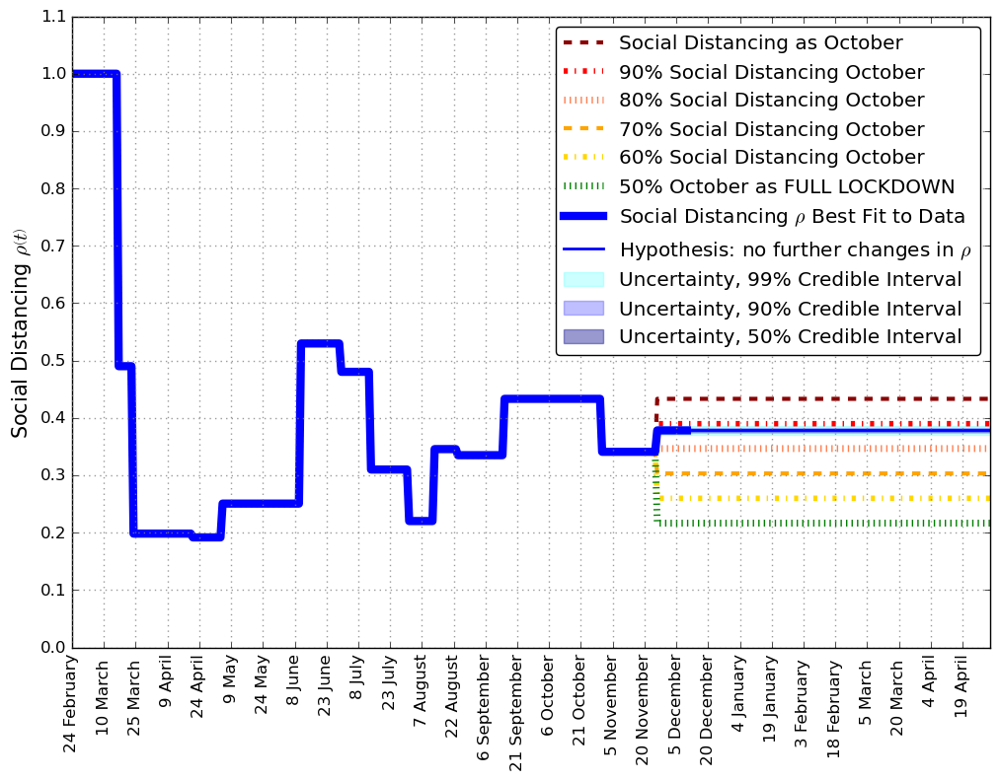

In [142]:
#################################
### Make a plot of rho values ###
#################################

# Put here the values of rho coming from fits
ListOfRhosBestMANUALFit = ListOfRhos
ListOfRhosBestMANUALFit[13] = MaxEstimate_Rho15ONLY
#ListOfRhosBestMANUALFit = [1,0.4902,0.1984,0.1918,0.2507,0.5298,0.4804,0.3101,0.2203,0.3457,0.3351,0.435,0.42,MaxEstimate_rho13]

plt.figure(facecolor="white",figsize=(12, 8))

ListOfRhosBestMANUALFitMOD = cp.deepcopy(ListOfRhosBestMANUALFit)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_99[0][1]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_99[0][1]
UpperBound99Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Up99 = R_eff(times, resultsseirUp99perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_99[0][0]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_99[0][0]
LowerBound99Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Down99 = R_eff(times, resultsseirLow99perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_90[0][1]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_90[0][1]
UpperBound90Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Up90 = R_eff(times, resultsseirUp90perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_90[0][0]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_90[0][0]
LowerBound90Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Down90 = R_eff(times, resultsseirLow90perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_50[0][1]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_50[0][1]
UpperBound50Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Up50 = R_eff(times, resultsseirUp50perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_50[0][0]
ListOfRhosBestMANUALFitMOD[13] = CredibleInterval_50[0][0]
LowerBound50Rho = rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD)
Reff_Down50 = R_eff(times, resultsseirLow50perc[:,0]*N, ListOfRhosBestMANUALFitMOD)

plt.fill_between(times, UpperBound99Rho, LowerBound99Rho, color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')
plt.fill_between(times, UpperBound90Rho, LowerBound90Rho, color='blue', alpha=0.25, label='Uncertainty, 90% Credible Interval')
plt.fill_between(times, UpperBound50Rho, LowerBound50Rho, color='darkblue', alpha=0.4, label='Uncertainty, 50% Credible Interval')

#ListOfRhosBestMANUALFitMOD[13] = 1 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 1 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),'--',color='darkred',lw=3,label=r'Social Distancing as October')
Reff_MEASURES95 = R_eff(times, resultsseirMEASURES95[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = 0.9 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 0.9 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),'-.',color='red',lw=4,label=r'90% Social Distancing October')
Reff_MEASURES90 = R_eff(times, resultsseirMEASURES90[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = 0.8 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 0.8 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),':',color='coral',lw=5,label=r'80% Social Distancing October')
Reff_MEASURES80 = R_eff(times, resultsseirMEASURES80[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = 0.7 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 0.7 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),'--',color='orange',lw=3,label=r'70% Social Distancing October')
Reff_MEASURES70 = R_eff(times, resultsseirMEASURES70[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = 0.6 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 0.6 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),'-.',color='gold',lw=4,label=r'60% Social Distancing October')
Reff_MEASURES60 = R_eff(times, resultsseirMEASURES60[:,0]*N, ListOfRhosBestMANUALFitMOD)

#ListOfRhosBestMANUALFitMOD[13] = 0.5 * ReferenceRhoOCTOBER
ListOfRhosBestMANUALFitMOD[13] = 0.5 * ReferenceRhoOCTOBER
plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFitMOD),':',color='green',lw=5,label=r'50% October as FULL LOCKDOWN')
Reff_MEASURES50 = R_eff(times, resultsseirMEASURES50[:,0]*N, ListOfRhosBestMANUALFitMOD)

times2=np.arange(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+1,1)
plt.plot(times2,rhoAsFunctionforLuxembourg(times2,ListOfRhosBestMANUALFit[0:len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+1]),'-',color='blue',lw=6,label=r'Social Distancing $\rho$ Best Fit to Data')

plt.plot(times,rhoAsFunctionforLuxembourg(times,ListOfRhosBestMANUALFit),'-',color='blue',lw=2,label=r'Hypothesis: no further changes in $\rho$')

plt.ylabel(r"Social Interaction $\rho\left(t\right)$",size=15)
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,1.21,0.1))
plt.xlim(0,len(SevenDaysMovingAverageOf_NewDailyCases_DataII)+LenghtOfForecast)
plt.ylim(0,1.1)

plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)
plt.legend(loc='upper right', fancybox=True, numpoints=1)

plt.savefig('./Results_Luxembourg/SocialDistancingRhoValues_SEIR-ICU_ResidentsOnly_WithUncert_MEASURES' + FileFormatOfFigures)

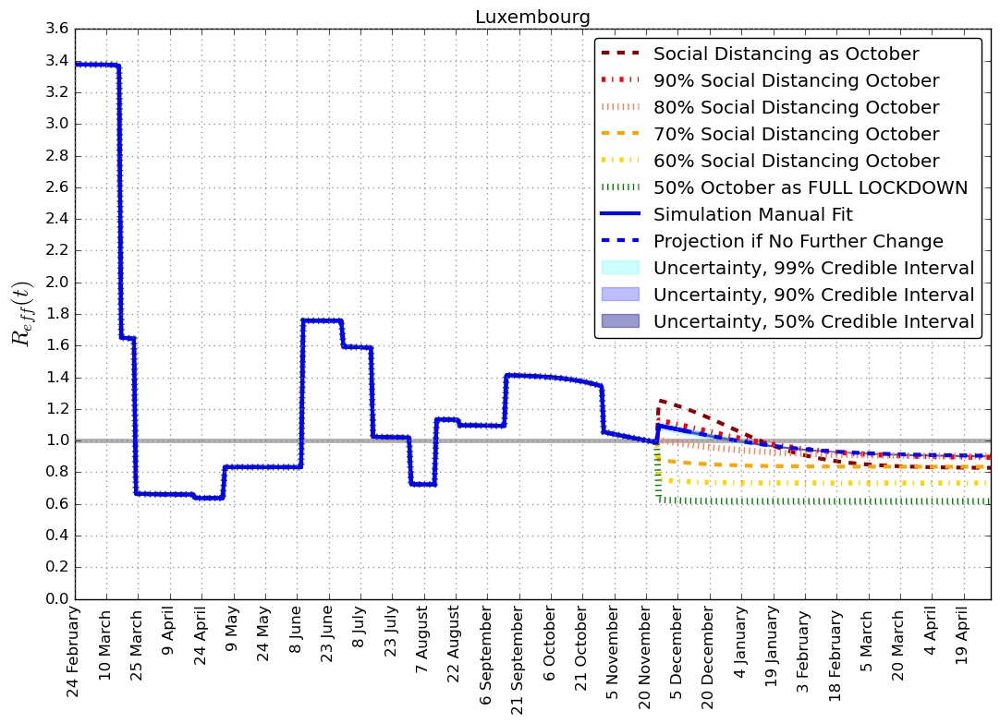

In [146]:
#plot for Reff under different scenarios
#Reff = R_eff(times, cases_sim, ListOfRhos)


Reff_Best = R_eff(times, resultsseirRho15[:,0]*N, ListOfRhosBestMANUALFit)
#Reff_Opt = R_eff(times, cases_sim_Optimistic, List_Rho_BestScenario)
#Reff_Pess = R_eff(times, cases_sim_Pessimistic, List_Rho_WorstScenario)

plt.figure(figsize=(11, 8),facecolor='white')

plt.axhline(y=1,color='gray',linewidth=3.5, alpha = 0.6)

plt.plot(times,Reff_MEASURES95,'--',color='darkred',lw=3,label=r'Social Distancing as October')
plt.plot(times,Reff_MEASURES90,'-.',color='red',lw=4,label=r'90% Social Distancing October')
plt.plot(times,Reff_MEASURES80,':',color='coral',lw=5,label=r'80% Social Distancing October')
plt.plot(times,Reff_MEASURES70,'--',color='orange',lw=3,label=r'70% Social Distancing October')
plt.plot(times,Reff_MEASURES60,'-.',color='gold',lw=4,label=r'60% Social Distancing October')
plt.plot(times,Reff_MEASURES50,':',color='green',lw=5,label=r'50% October as FULL LOCKDOWN')

plt.fill_between(times[0:NumberDaysData+150], Reff_Down99[0:NumberDaysData+150], Reff_Up99[0:NumberDaysData+150], color='cyan', alpha=0.2, label='Uncertainty, 99% Credible Interval')
plt.fill_between(times[0:NumberDaysData+150], Reff_Down90[0:NumberDaysData+150], Reff_Up90[0:NumberDaysData+150], color='blue', alpha=0.25, label='Uncertainty, 90% Credible Interval')
plt.fill_between(times[0:NumberDaysData+150], Reff_Down50[0:NumberDaysData+150], Reff_Up50[0:NumberDaysData+150], color='darkblue', alpha=0.4, label='Uncertainty, 50% Credible Interval')

plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-', label="Simulation Manual Fit", linewidth=3,color='blue')
#plt.plot(times,Reff_Opt,'-.', label="Optimistic Projection (as lockdown)", linewidth=3,color='green')
#plt.plot(times,Reff_Pess,':', label="Pessimistic Projection (as October)", linewidth=3,color='red')
#plt.plot(times,Reff,'--', label="Projection if No Further Change", linewidth=3,color='blue')

plt.plot(times,Reff_Best,'--', label="Projection if No Further Change", linewidth=3,color='blue')

plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-',linewidth=3,color='blue')

UpperY3 = 3.6

plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)
plt.yticks(np.arange(0,UpperY3+1,0.2))

plt.title('Luxembourg')

plt.legend(loc='upper right', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel(“Time”)
plt.ylabel(r'$R_{eff}(t)$',size=18)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

#plt.ylim(0.6,2)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/R_eff_LUXEMBOURG_WithUncert_MEASURES' + FileFormatOfFigures)

In [32]:

################################################################################
#####   NOW PREPARE SUM OF SQUARE RESIDUALS FUNCTION FOR MCMC - 1st WAVE   #####
################################################################################


In [26]:
def gpp2_1stWave(u,t,theta):

    rho1=theta[0]
    rho2=theta[1]
    rho3=theta[2]
    rho4=theta[3]
    tau1=theta[4]
    tau2=theta[5]
    tau3=theta[6]
    p3=theta[7]
    p2=theta[8]
    p4=theta[9]
    p5=theta[10]
    p6=theta[11]
    alpha=theta[12]
    beta=theta[13]
    p7=theta[14]
    tau7=theta[15]
    tau6=theta[16]
    tau5=theta[17]
    tau4=theta[18]
    tau8=1/(1/tau1+1/tau2)

    p9=p7
    tau9=tau7
    
    rho5=ListOfRhos[5]
    rho6=ListOfRhos[6]
    rho7=ListOfRhos[7]
    rho8=ListOfRhos[8]
    rho9=ListOfRhos[9]
    rho10=ListOfRhos[10]
    rho11=ListOfRhos[11]
    rho12=ListOfRhos[12]
    rho13=ListOfRhos[13]

    ListOfRhostrial=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]#,rho14,rho15]
 

    # 2nd Wave

    p2prim=ListOfParametersfirstwave[19]
    p3prim=ListOfParametersfirstwave[20]
    p4prim=ListOfParametersfirstwave[21]
    p5prim=ListOfParametersfirstwave[22]
    p6prim=ListOfParametersfirstwave[23]
    p7prim=ListOfParametersfirstwave[24]
    p9prim=ListOfParametersfirstwave[25]
    tau3prim=ListOfParametersfirstwave[26]
    tau4prim=ListOfParametersfirstwave[27]
    tau5prim=ListOfParametersfirstwave[28]
    tau6prim=ListOfParametersfirstwave[29]
    tau7prim=ListOfParametersfirstwave[30]
    tau8prim=ListOfParametersfirstwave[31]
    tau9prim=ListOfParametersfirstwave[32]
    p1prim=ListOfParametersfirstwave[33]
    
    # 3rd Wave
    
    p2prim2=ListOfParametersfirstwave[34]
    p3prim2=ListOfParametersfirstwave[35]
    p4prim2=ListOfParametersfirstwave[36]
    p5prim2=ListOfParametersfirstwave[37]
    p6prim2=ListOfParametersfirstwave[38]
    p7prim2=ListOfParametersfirstwave[39]
    p9prim2=ListOfParametersfirstwave[40]
    tau3prim2=ListOfParametersfirstwave[41]
    tau4prim2=ListOfParametersfirstwave[42]
    tau5prim2=ListOfParametersfirstwave[43]
    tau6prim2=ListOfParametersfirstwave[44]
    tau7prim2=ListOfParametersfirstwave[45]
    tau8prim2=ListOfParametersfirstwave[46]
    tau9prim2=ListOfParametersfirstwave[47]
    
    ListOfParametersfirstwave_MOD=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2])
    
    y=model_SEIRICUHOS(u,t,ListOfRhostrial,ListOfParametersfirstwave_MOD)
    return y

In [27]:
def errorxy12_1stWave(theta,data):
    RMS=np.zeros(102)
    N=623180
    P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
    tt=len(SevenDaysMovingAverage_TotalCases)
    endfirstwave=101
    t2=np.linspace(0,endfirstwave-1,endfirstwave)
    y=data1

    resultsseir2=odeint(gpp2_1stWave,P2,t2,args=(theta,))
    
    # S, E, R ,I ,Q, A, D,H,Hl,ICU, AICU,NI,NI1,R1,D1
    
    # detected -> dead + recovered + icu + hos + icu + qua
    cc=(resultsseir2[:,2]+resultsseir2[:,3]+resultsseir2[:,4]+resultsseir2[:,6]+resultsseir2[:,7]+resultsseir2[:,8]+resultsseir2[:,9]+resultsseir2[:,10]+resultsseir2[:,11]+resultsseir2[:,15])*N-y[0,0:endfirstwave]
    cci=((cc**2).sum(axis=0))
    
    # dead at home -> dead at home
    ai=((resultsseir2[:,15])*N-y[4,0:endfirstwave])
    aai=((ai**2).sum(axis=0))
    
    # icu -> icu
    bi=((resultsseir2[:,9])*N- y[1,0:endfirstwave])
    bbi=((bi**2).sum(axis=0))
    
    # hospital -> hos + aicu
    ee=((resultsseir2[:,7]+resultsseir2[:,8]+resultsseir2[:,10])*N)-y[2,0:endfirstwave]
    eei=((ee**2).sum(axis=0))
    
    # dead in Hospital/ICU -> dead in Hospital/ICU 
    di=((resultsseir2[:,6])*N- y[3,0:endfirstwave])
    ddi=((di**2).sum(axis=0))

    RMS= cci + eei + aai + bbi + ddi

    return RMS

In [355]:

################################################################################
#####   NOW PREPARE SUM OF SQUARE RESIDUALS FUNCTION FOR MCMC - 2nd WAVE   #####
################################################################################


In [ ]:
def gpp2_2ndWave(u,t,theta):

    # 1st Wave

    rho1 = ListOfRhos[1]
    rho2 = ListOfRhos[2]    
    rho3 = ListOfRhos[3]    
    rho4 = ListOfRhos[4]
    
    ListOfParameters = ListOfParametersfirstwave
    
    alpha=ListOfParameters[0] 
    beta=ListOfParameters[1]
    p1=ListOfParameters[2]
    p2=ListOfParameters[3]
    p3=ListOfParameters[4]
    p4=ListOfParameters[5]
    p5=ListOfParameters[6]
    p6=ListOfParameters[7]
    p7=ListOfParameters[8]
    p9=ListOfParameters[9]
    tau1 = ListOfParameters[10]
    tau2 = ListOfParameters[11]
    tau3 = ListOfParameters[12]
    tau4 = ListOfParameters[13]
    tau5 = ListOfParameters[14]
    tau6 = ListOfParameters[15]
    tau7 = ListOfParameters[16]
    tau8 = ListOfParameters[17]
    tau9 = ListOfParameters[18]
    
    # PARAMETERS SECOND WAVE
    
    rho5=theta[0]
    rho6=theta[1]
    rho7=theta[2]
    rho8=theta[3]
    rho9=theta[4]
    rho10=theta[5]
    
    tau1prim=tau1
    tau2prim=tau2
    tau3prim=theta[6]
    
    p3prim=theta[7]
    p2prim=theta[8]
    p4prim=theta[9]
    p5prim=theta[10]
    p6prim=theta[11]
    p7prim=theta[12]
    
    tau7prim=theta[13]
    tau6surprim=theta[14]
    
    tau5surprim=theta[15]
    
    tau4surprim=theta[16]
    
    tau8prim=1/(1/tau1prim+1/tau2prim)
    p9prim=p7prim
    tau9prim=tau7prim
    
    rho11 = ListOfRhos[11]
    rho12 = ListOfRhos[12]    
    rho13 = ListOfRhos[13]    

    ListOfRhostrial=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]

    # 3rd Wave
    
    p2prim2=ListOfParameters[34]
    p3prim2=ListOfParameters[35]
    p4prim2=ListOfParameters[36]
    p5prim2=ListOfParameters[37]
    p6prim2=ListOfParameters[38]
    p7prim2=ListOfParameters[39]
    p9prim2=ListOfParameters[40]
    tau3prim2=ListOfParameters[41]
    tau4prim2=ListOfParameters[42]
    tau5prim2=ListOfParameters[43]
    tau6prim2=ListOfParameters[44]
    tau7prim2=ListOfParameters[45]
    tau8prim2=ListOfParameters[46]
    tau9prim2=ListOfParameters[47]
    
    ListOfParametersfirstwave_MOD=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2])
    
    y=model_SEIRICUHOS(u,t,ListOfRhostrial,ListOfParametersfirstwave)
    return y



In [ ]:
def errorxy12_2ndWave(theta,data):
    
    N=623180
    P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
    tt=len(SevenDaysMovingAverage_TotalCases)
    RMS=np.zeros(tt+1)
    endfirstwave=101
    t2=np.linspace(0,tt-1,tt)
    y=data1

    resultsseir2=odeint(gpp2_2ndWave,P2,t2,args=(theta,))
    
    # S, E, R ,I ,Q, A, D,H,Hl,ICU, AICU,NI,NI1,R1,D1
    
    cc=(resultsseir2[endfirstwave:tt,2]+resultsseir2[endfirstwave:tt,3]+resultsseir2[endfirstwave:tt,4]+resultsseir2[endfirstwave:tt,6]+resultsseir2[endfirstwave:tt,7]+resultsseir2[endfirstwave:tt,8]+resultsseir2[endfirstwave:tt,9]+resultsseir2[endfirstwave:tt,10]+resultsseir2[endfirstwave:tt,11]+resultsseir2[endfirstwave:tt,15])*N-y[0,endfirstwave:tt]
    cci=((cc**2).sum(axis=0))
    
    
    # dead at home -> dead at home
    ai=((resultsseir2[endfirstwave:tt,15])*N-y[4,endfirstwave:tt])
    aai=((ai**2).sum(axis=0))
    
    # icu -> icu
    bi=((resultsseir2[endfirstwave:tt,9])*N- y[1,endfirstwave:tt])
    bbi=((bi**2).sum(axis=0))
    
    # hospital -> hos + aicu
    ee=((resultsseir2[endfirstwave:tt,7]+resultsseir2[endfirstwave:tt,8]+resultsseir2[endfirstwave:tt,10])*N)-y[2,endfirstwave:tt]
    eei=((ee**2).sum(axis=0))
    
    # dead in Hospital/ICU -> dead in Hospital/ICU 
    di=((resultsseir2[endfirstwave:tt,6])*N- y[3,endfirstwave:tt])
    ddi=((di**2).sum(axis=0))

    RMS= cci + eei + aai + bbi + ddi
    
    return RMS



In [37]:
#####################################################################################
##### NOW WE ADD HERE MCMC FOR 1ST AND 2ND WAVE AND ALL WHAT'S NEEDED TO RUN IT #####
#####################################################################################

In [38]:
##############################
### PARALLEL MCMC 1st WAVE ###
##############################

# MAIN IMPROVEMENTS W.R.T. PREVIOUS SETUP:

# 1) REMOVE MYSTERIUS SECOND CHAIN
# 2) PARALLEL MCMC x 8 chains
# 3) ALL PARAMETER SPACE
# 4) RANDOM CI, different for every chain
# 5) KEEP ONLY ONE POINT EVERY 100
# 6) LONGER CHAINS 500000
# 7) COMPUTE CONVERGENCE STATISTICS

# X) ALL CHAINS STILL HAVE SAME RANDOM SEED, SHOULD MAKE IT DIFGFERENT FOR EVERY CHAIN (HOW?) OR IRRELEVANT?


In [31]:
### FIRST WE CREATE SETUP FOR ONE CHAIN AS WE WERE DOING BEFORE ###

# initialize MCMC object
MyNew_mcstat = MCMC(rngseed=123456789)

# initialize data structure 
MyNew_mcstat.data.add_data_set(x=df2['Date'],y=data1)

# Set Boundaries of Parameter Space
MyNew_mcstat.parameters.add_model_parameter(name='rho1', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='rho2', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='rho3', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='rho4', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='tau1', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='tau2', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='tau3', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='p3', minimum=0.5, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='p2', minimum=0, maximum=0.5)
MyNew_mcstat.parameters.add_model_parameter(name='p4', minimum=0.5, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='p5', minimum=0.5, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='p6', minimum=0.5, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='alpha', minimum=0, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='beta', minimum=0, maximum=2)
MyNew_mcstat.parameters.add_model_parameter(name='p7', minimum=0.5, maximum=1)
MyNew_mcstat.parameters.add_model_parameter(name='tau7', minimum=0, maximum=0.5)
MyNew_mcstat.parameters.add_model_parameter(name='tau6', minimum=0, maximum=0.5)
MyNew_mcstat.parameters.add_model_parameter(name='tau5', minimum=0, maximum=0.5)
MyNew_mcstat.parameters.add_model_parameter(name='tau4', minimum=0, maximum=0.5)

# Define options
datestr = datetime.now().strftime('%Y%m%d_%H%M%S')
savedir = 'Saved_MCMC_Chains' + os.sep + str('{}_{}'.format(datestr, 'parallel_chains'))
MyNew_mcstat.simulation_options.define_simulation_options(nsimu=int(500e3), updatesigma=True, method='dram',
                                                         savedir=savedir, savesize=1000, save_to_json=True,
                                                          save_lightly=True, save_to_bin=True)
MyNew_mcstat.model_settings.define_model_settings(sos_function=errorxy12_1stWave)




In [32]:
My_Parallel_MCMC = ParallelMCMC()
My_Parallel_MCMC.setup_parallel_simulation(MyNew_mcstat, initial_values=None, num_cores=8, num_chain=8)

In [33]:
# DO NOT RE-RUN THIS UNLESS YOU WISH A NEW MCMC CHAIN (CAN TAKE 8 HOURS WITH 500000 ITERATIONS)
My_Parallel_MCMC.run_parallel_simulation()

Processing: Saved_MCMC_Chains/20201217_032805_parallel_chains/chain_0
Processing: Saved_MCMC_Chains/20201217_032805_parallel_chains/chain_1
Processing: Saved_MCMC_Chains/20201217_032805_parallel_chains/chain_2
Processing: Saved_MCMC_Chains/20201217_032805_parallel_chains/chain_3

Sampling these parameters:
Sampling these parameters:
Sampling these parameters:
Sampling these parameters:



      name      start [      min,       max] N(       mu,   sigma^2)
      name      start [      min,       max] N(       mu,   sigma^2)
      name      start [      min,       max] N(       mu,   sigma^2)
      name      start [      min,       max] N(       mu,   sigma^2)
      rho1:      0.53 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
      rho1:      0.79 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
      rho1:      0.40 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
      rho1:      0.45 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
      rho2:      0.53 [ 0.00e+00,      1.00] N( 0.00e+00,   

        p4:      0.91 [     0.50,      1.00] N( 0.00e+00,      inf)
        p5:      0.73 [     0.50,      1.00] N( 0.00e+00,      inf)
        p6:      0.77 [     0.50,      1.00] N( 0.00e+00,      inf)
     alpha:      0.68 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
      beta:      0.99 [ 0.00e+00,      2.00] N( 0.00e+00,      inf)
        p7:      0.85 [     0.50,      1.00] N( 0.00e+00,      inf)
      tau7:      0.35 [ 0.00e+00,      0.50] N( 0.00e+00,      inf)
      tau6:      0.22 [ 0.00e+00,      0.50] N( 0.00e+00,      inf)
      tau5:      0.10 [ 0.00e+00,      0.50] N( 0.00e+00,      inf)
      tau4:      0.21 [ 0.00e+00,      0.50] N( 0.00e+00,      inf)
 [--                6%                  ] 32840 of 500000 complete in 952.3 secsecProcessing: Saved_MCMC_Chains/20201217_032805_parallel_chains/chain_6

Sampling these parameters:
      name      start [      min,       max] N(       mu,   sigma^2)
      rho1:      0.80 [ 0.00e+00,      1.00] N( 0.00e+00,      inf)
   

In [ ]:
My_Parallel_MCMC.display_individual_chain_statistics()

In [33]:
# Loading saved MCMC Chains
DirectoryOfPreviousRunMCMC = 'Saved_MCMC_Chains/20201217_032805_parallel_chains_1stWave_Lux'
pres = CP.load_parallel_simulation_results(DirectoryOfPreviousRunMCMC)
combined_chains, index = CP.generate_combined_chain_with_index(pres)
np.shape(combined_chains) # 8 chains x 500k/2 = 2 Millions points

(2000000, 19)

In [34]:
### RUN DIAGNOStiC TO ASSESS IN A QUANTITATIVE MANNER IF THE MULTIPLE EMCMC CHAINS CONVERGED ###

# Gelman-Rubin Diagnostic (https://github.com/prmiles/pymcmcstat_examples/blob/master/Running_Parallel_Chains.ipynb)

chains = CP.generate_chain_list(pres)
psrf = CS.gelman_rubin(chains=chains, display=True)

# In general, R closer to 1 indicates your chains have converged.


Parameter: $p_{0}$
  R = 1.0020983698531991
  B = 46.993374071004816
  W = 0.05028846587078524
  V = 0.05049973490024129
  neff = 2149.227881528086
Parameter: $p_{1}$
  R = 1.0062560351428975
  B = 50.60127892300956
  W = 0.018136358267486382
  V = 0.018363991477206857
  neff = 725.8311200057962
Parameter: $p_{2}$
  R = 1.0029002298595449
  B = 52.47279276091977
  W = 0.040621504468015365
  V = 0.040857469549421634
  neff = 1557.282065606049
Parameter: $p_{3}$
  R = 1.0102961630287355
  B = 176.2203843368629
  W = 0.03830445462965511
  V = 0.03909729314135248
  neff = 443.73178833402255
Parameter: $p_{4}$
  R = 1.0124823511969956
  B = 277.5475434837234
  W = 0.049710974336863244
  V = 0.050959739438642654
  neff = 367.21448728391397
Parameter: $p_{5}$
  R = 1.0092953487621172
  B = 220.03678951594298
  W = 0.05300359711565766
  V = 0.05399355065409095
  neff = 490.7683917118668
Parameter: $p_{6}$
  R = 1.0226234999819317
  B = 803.607828800329
  W = 0.079021245085758
  V = 0.082637164

In [35]:
if np.shape(chains)[1] <= 10000:
    OneStepEveryNinChains = 1
elif np.shape(chains)[1] > 10000 and np.shape(chains)[1] <= 100000:
    OneStepEveryNinChains = 10
elif np.shape(chains)[1] >= 100000:
    OneStepEveryNinChains = 100

Indexes1OutOf100 = np.arange(0,np.shape(chains)[1],OneStepEveryNinChains) # np.arange(0,500,1) # np.linspace(0,250000,2501)[0:-1]
Indexes1OutOf100 = Indexes1OutOf100.astype(int)
print(np.shape(chains[0][Indexes1OutOf100,:]))

(2500, 19)


In [36]:
print(np.shape(chains))

## Prepare indexes to cut chains, only 1 point every 100
#Indexes1OutOf100 = np.linspace(0,250000,2501)[0:-1]
#Indexes1OutOf100 = Indexes1OutOf100.astype(int)
print(np.shape(chains[0][Indexes1OutOf100,:]))

# NO, FOR PLOTTING TOO LONG. Based on the paper from Link and Eaton (2012), we decide instead to keep all points of the chain

# Cut chains and concatenate them
MyChain = chains[0][Indexes1OutOf100,:]
#MyChain = chains[0][:,:]
#MyChain_BurninRemoved = MyChain[100::,:]
MyChain_BurninRemoved = MyChain[:,:]

ConcatenatedExtractedChains = MyChain_BurninRemoved
print(np.shape(ConcatenatedExtractedChains))
for i in range(7):
    # Take out first 10000 of each chain i.e. 100 of the points left) for burnin
    MyChain = chains[i+1][Indexes1OutOf100,:]
    #MyChain = chains[i+1][:,:]
    #MyChain_BurninRemoved = MyChain[100::,:]
    MyChain_BurninRemoved = MyChain[:,:]

    # Than concatenate
    ConcatenatedExtractedChains = np.concatenate((ConcatenatedExtractedChains,MyChain_BurninRemoved),axis=0)
print(np.shape(ConcatenatedExtractedChains))


(8, 250000, 19)
(2500, 19)
(2500, 19)
(20000, 19)


<Figure size 640x480 with 0 Axes>

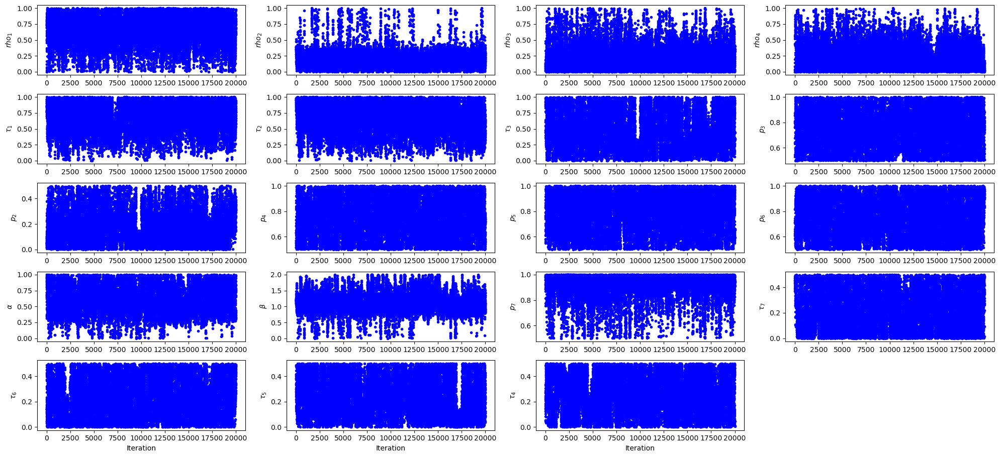

In [37]:
plt.style.use('default') # 'ggplot' Other styles at https://matplotlib.org/3.1.1/gallery/style_sheets/style_sheets_reference.html
plt.figure(facecolor="white")
settings = dict(
    fig=dict(figsize=(20, 10))
)

NamesParamsParallelChains = [r'$rho_1$',r'$rho_2$',r'$rho_3$',r'$rho_4$',r'$\tau_1$',r'$\tau_2$',r'$\tau_3$',
                             r'$p_3$',r'$p_2$',r'$p_4$', r'$p_5$',r'$p_6$',r'$\alpha$',
                             r'$\beta$',r'$p_7$',r'$\tau_7$',r'$\tau_{6}$',
                             r'$\tau_{5}$',r'$\tau_{4}$']

mcp.plot_chain_panel(ConcatenatedExtractedChains,NamesParamsParallelChains, settings,maxpoints=1000000)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_1D_1stWave.png')
# One can save the figure directly on computer as a pdf (or any other format), just uncomment the following
# pdf quality is better, but reduce the number of points in plot (maxpoints above) 
# otherwise too heavy and slow to visualize!!!
# plt.savefig('./Results/MCMC_2ndWave/Chains_1D_2ndWave_2ndWave.pdf')

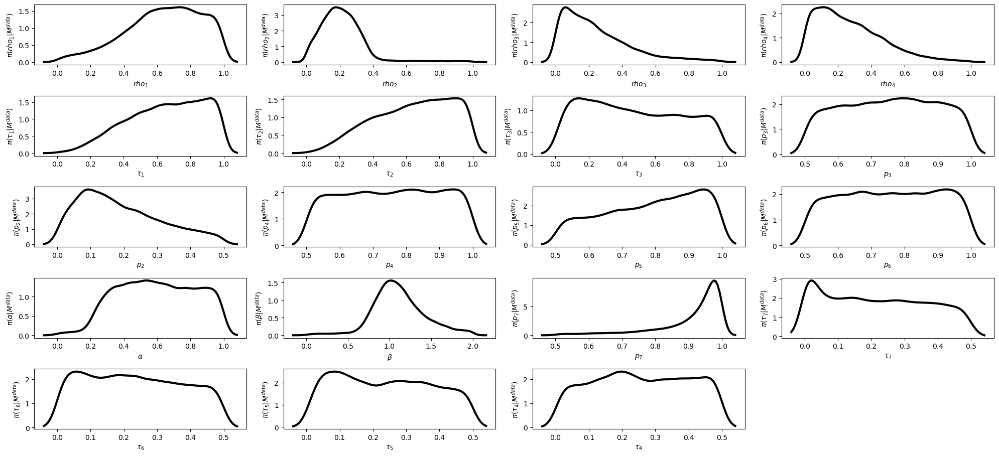

In [38]:
mcp.plot_density_panel(ConcatenatedExtractedChains,NamesParamsParallelChains, settings)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_Posteriors_1D_1stWave' + FileFormatOfFigures)

In [71]:
# We here need to define once and for all the function to make the nice colorful plot 
# of 2D posterior densities for all paramerters with blue and red colormap

# IF TOO SLOW, REDUCE THE NUMBER OF BINS, nbins = 20 IS ENOUGH AND GOES FASTER
# IF YOU WANT MORE RESOLUTION (NOT NEEDED), INCREASE THE NUMBER OF BINS, e.g. nbins = 50, NEGLIGIBLE IMPROVEMENT BUT SLOWER

def PlotDensityPosteriorWithContours(axes,My_chain,i,j): # ,MyNLevels):
    
    from scipy.stats import kde

    nbins = 30 # This can be changed to make more smooth or more granular densities
    # Evaluate a gaussian kde on a regular grid of nbins x nbins over data extents
    data = My_chain[:,[j,i]]
    x, y = data.T
    k = kde.gaussian_kde(data.T)
    xi, yi = np.mgrid[x.min():x.max():nbins*1j, y.min():y.max():nbins*1j]
    zi = k(np.vstack([xi.flatten(), yi.flatten()]))
    # Added to make Credible Intervals
    zi_Norm=zi/sum(zi)
    # Order zis
    zi_Norm_Sorted_Reverted = sorted(zi_Norm, reverse=True)
    # sum them up in decreasing order
    IntegralOverPosterior = 0
    CounterContours = 0
    for ThisZi in zi_Norm_Sorted_Reverted:
        IntegralOverPosterior = IntegralOverPosterior + ThisZi
        if CounterContours == 0 and IntegralOverPosterior >= 0.25: # 25%
            ContourValue25 = ThisZi
            CounterContours = 1
        elif CounterContours == 1 and IntegralOverPosterior >= 0.5: # 50%
            ContourValue50 = ThisZi
            CounterContours = 2
        elif CounterContours == 2 and IntegralOverPosterior >= 0.90: # 90%
            ContourValue90 = ThisZi
            CounterContours = 3
    
    im = axes[i,j].pcolormesh(xi, yi, zi_Norm.reshape(xi.shape), shading='gouraud', cmap='coolwarm')
    im = axes[i,j].contour(xi, yi, zi_Norm.reshape(xi.shape), colors='k',levels=[ContourValue90,ContourValue50,ContourValue25]) # MyNLevels
 
    
def Plot_Multiple_2D_Densities(My_chain,My_names,FileNameForSaving):
    
    MyMarkersSize = 20#16

    NumberOfParameters = len(My_names)
        
    plt.style.use('default') # 'ggplot' Other styles at https://matplotlib.org/3.1.1/gallery/style_sheets/style_sheets_reference.html
    plt.figure(facecolor="white")
    
    fig, axes = plt.subplots(nrows=NumberOfParameters, ncols=NumberOfParameters, subplot_kw=dict(facecolor='white'))
    
    for ax in axes.flat:
        # Hide all ticks and labels
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        # Set up ticks only on one side for the "edge" subplots...
        if ax.is_first_col():
            ax.yaxis.set_ticks_position('left')
        if ax.is_last_col():
            ax.yaxis.set_ticks_position('right')
            ax.yaxis.set_label_position('right')
        if ax.is_first_row():
            ax.xaxis.set_ticks_position('top')
            ax.xaxis.set_label_position('top')
        if ax.is_last_row():
            ax.xaxis.set_ticks_position('bottom')
    
    ListOfParametersNamesForLegend = My_names
    # NLevels = 3 # Number of (black) Contour Lines in each plot
    
    for i in range(NumberOfParameters):
        for j in range(NumberOfParameters):
            DotSize = 1#14
            if i>j:
                if (i % 2) != 0:
                    if (j % 2) != 0:
                        # im = axes[i,j].scatter(My_chain[:,j], My_chain[:,i])#, s=DotSize, c='b', edgecolor = '')#, cmap=plt.cm.rainbow_r)
                        PlotDensityPosteriorWithContours(axes,My_chain,i,j)#,NLevels)
                elif (i % 2) == 0:
                    if  (j % 2) == 0:
                        PlotDensityPosteriorWithContours(axes,My_chain,i,j)#,NLevels)
            elif i<j:
                if (i % 2) != 0:
                    if (j % 2) == 0:
                        PlotDensityPosteriorWithContours(axes,My_chain,i,j)#,NLevels)
                elif (i % 2) == 0:
                    if (j % 2) != 0:
                        PlotDensityPosteriorWithContours(axes,My_chain,i,j)#,NLevels)
            elif i==j:
                # Label the diagonal subplots...
                axes[i,j].annotate(ListOfParametersNamesForLegend[i].split(" ", 1)[0], (0.5, 0.5), xycoords='axes fraction', ha='center', va='center',size=MyMarkersSize)
                #axes[i,j].scatter(ListOfOutputArrays[2+i], ListOfOutputArrays[0], s=8)               
    
            axes[i,j].set_xlim(min(My_chain[:,j]),max(My_chain[:,j]))
            axes[i,j].set_ylim(min(My_chain[:,i]),max(My_chain[:,i]))
            plt.setp(axes[i,j].get_xticklabels(), rotation=45, horizontalalignment='left')

    #cbar = fig.colorbar(im,ax=axes.ravel().tolist())
    #cbar.set_label('Marginal Posterior Probability')
    
    for k in range(round(NumberOfParameters/2)):
    
        axes[NumberOfParameters-1,2*k].xaxis.set_visible(True)
        axes[NumberOfParameters-1,2*k].locator_params(axis='x',nbins=5)
        plt.setp(axes[NumberOfParameters-1,2*k].get_xticklabels(), rotation=45, horizontalalignment='right')
        axes[NumberOfParameters-1,2*k].set_xlabel(ListOfParametersNamesForLegend[2*k],size=MyMarkersSize)
        axes[NumberOfParameters-1,2*k].get_xaxis().set_tick_params(direction='out')
    
        axes[2*k,0].yaxis.set_visible(True)
        axes[2*k,0].locator_params(axis='y',nbins=5)
        axes[2*k,0].set_ylabel(ListOfParametersNamesForLegend[2*k],size=MyMarkersSize)
        axes[2*k,0].get_yaxis().set_tick_params(direction='out')

    Remaining = NumberOfParameters % 2 
    
    if Remaining > 0: # then NumberOfParameters was an odd number
        
        for k in range(round(NumberOfParameters/2)):

            axes[0,2*k+1].xaxis.set_visible(True)
            axes[0,2*k+1].locator_params(axis='x',nbins=5)
            plt.setp(axes[0,2*k+1].get_xticklabels(), rotation=45, horizontalalignment='left')
            axes[0,2*k+1].set_xlabel(ListOfParametersNamesForLegend[2*k+1],size=MyMarkersSize)
            axes[0,2*k+1].get_xaxis().set_tick_params(direction='out')

            axes[2*k+1,NumberOfParameters-1].yaxis.set_visible(True)
            axes[2*k+1,NumberOfParameters-1].locator_params(axis='y',nbins=5)
            axes[2*k+1,NumberOfParameters-1].set_ylabel(ListOfParametersNamesForLegend[2*k+1],size=MyMarkersSize)
            axes[2*k+1,NumberOfParameters-1].get_yaxis().set_tick_params(direction='out')

    elif Remaining == 0: # then NumberOfParameters was an odd number

        for k in range(round(NumberOfParameters/2)):

            axes[0,2*k+1].xaxis.set_visible(True)
            axes[0,2*k+1].locator_params(axis='x',nbins=5)
            plt.setp(axes[0,2*k+1].get_xticklabels(), rotation=45, horizontalalignment='left')
            axes[0,2*k+1].set_xlabel(ListOfParametersNamesForLegend[2*k+1],size=MyMarkersSize)
            axes[0,2*k+1].get_xaxis().set_tick_params(direction='out')

            axes[2*k+1,NumberOfParameters-1].yaxis.set_visible(True)
            axes[2*k+1,NumberOfParameters-1].locator_params(axis='y',nbins=5)
            axes[2*k+1,NumberOfParameters-1].set_ylabel(ListOfParametersNamesForLegend[2*k+1],size=MyMarkersSize)
            axes[2*k+1,NumberOfParameters-1].get_yaxis().set_tick_params(direction='out')
    
    fig.set_figheight(25)
    fig.set_figwidth(25)
    plt.subplots_adjust(wspace=0, hspace=0)
               
    fig.savefig(FileNameForSaving)

    plt.show()
    

<Figure size 640x480 with 0 Axes>

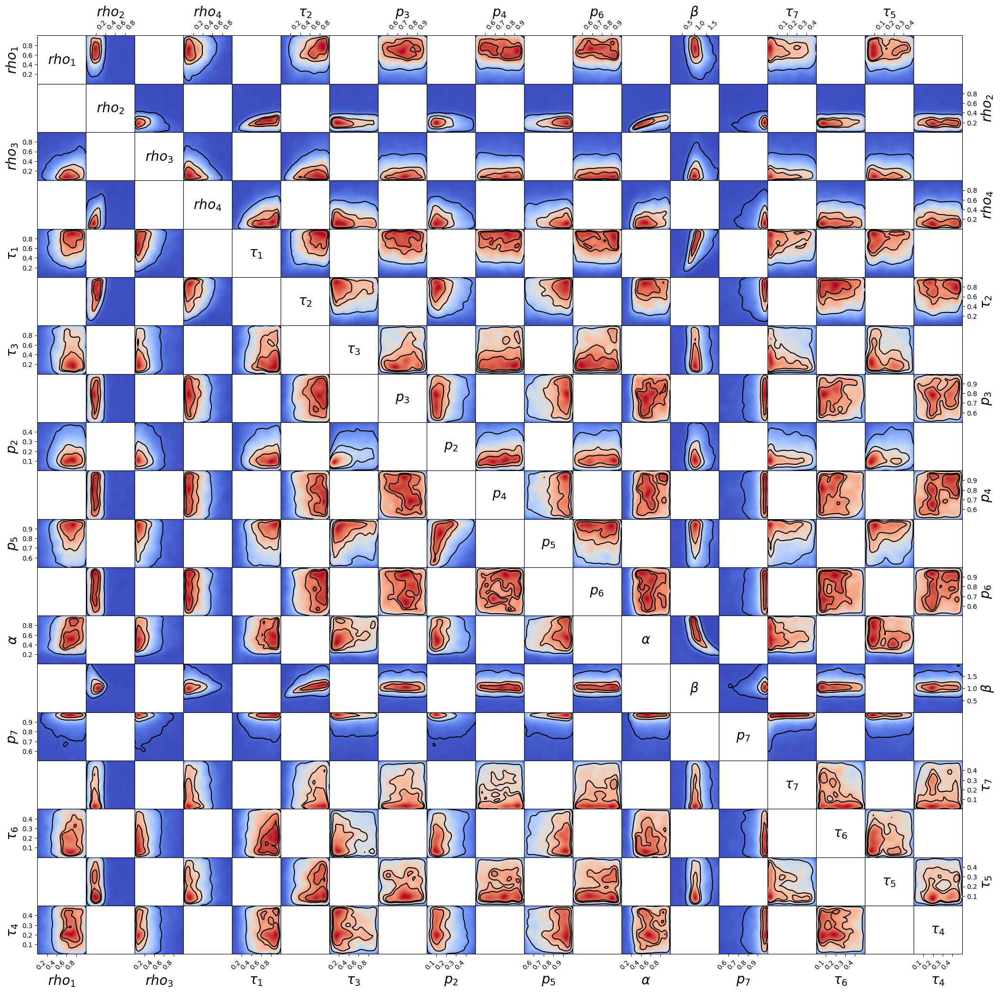

In [40]:
Plot_Multiple_2D_Densities(ConcatenatedExtractedChains, NamesParamsParallelChains, FileNameForSaving='./Results_Luxembourg/Parallel8CutChains_Posteriors_2D_1stWave' + FileFormatOfFigures)

In [34]:
# SO LET'S PLOT ONLY A SUBSET OF THESE MULTIPLE CHAINS

Indexes1OutOf100_For2000000 = np.linspace(0,2000000,20001)[0:-1]
Indexes1OutOf100_For2000000 = Indexes1OutOf100_For2000000.astype(int)

combined_chains_CUT = combined_chains[Indexes1OutOf100_For2000000,:]
index = np.array(index)
index_CUT = index[Indexes1OutOf100_For2000000]

In [ ]:
# VERY COOL, BUT CAN TAKE LONG TO RUN...!!!
# PLOT ONLY IF YOU CAN WAIT ONE HOUR!!!

# Please remember that this is an inbuilt function from pymcmcstat so no need to define anything above

settings = dict(
    pairgrid=dict(height=3.75, hue='index', despine=False),
    ld_type=sns.kdeplot,
    ld=dict(n_levels=5, shade=True, shade_lowest=False),
    md=dict(lw=3))
sns.set_context('talk')
fpg = mcp.plot_paired_density_matrix(
    chains=combined_chains_CUT,
    settings=settings,
    index=index_CUT)
tmp = fpg.add_legend()

plt.savefig('./Results_Luxembourg/ParallelChainsDensityPlots_1stWave_Luxembourg.png')

In [ ]:
##############################
### PARALLEL MCMC 2nd WAVE ###
##############################

In [ ]:
# initialize MCMC object
MyNew_mcstat_2ndWave = MCMC(rngseed=123456789)

# initialize data structure 
MyNew_mcstat_2ndWave.data.add_data_set(x=df2['Date'],y=data1)

MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho5', minimum=0, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho6', minimum=0, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho7', minimum=0, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho8', minimum=0, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho9', minimum=0, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='rho10', minimum=0, maximum=1)

MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau3prim', minimum=0, maximum=1)

MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p3prim', minimum=0.5, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p2prim', minimum=0, maximum=0.5)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p4prim', minimum=0.5, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p5prim', minimum=0.5, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p6prim', minimum=0.5, maximum=1)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='p7prim', minimum=0.5, maximum=1)

MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau7prim', minimum=0, maximum=0.5)
#MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau6surprim', minimum=0, maximum=0.5)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau6prim', minimum=0, maximum=0.5)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau5prim', minimum=0, maximum=0.5)
#MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau5dieprim', minimum=0, maximum=0.5)
#MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau4surprim', minimum=0, maximum=0.5)
MyNew_mcstat_2ndWave.parameters.add_model_parameter(name='tau4prim', minimum=0, maximum=0.5)

# Define options
datestr = datetime.now().strftime('%Y%m%d_%H%M%S')
savedir = 'Saved_MCMC_Chains' + os.sep + str('{}_{}'.format(datestr, 'parallel_chains'))
MyNew_mcstat_2ndWave.simulation_options.define_simulation_options(nsimu=int(500e3), updatesigma=True, method='dram',
                                                         savedir=savedir, savesize=1000, save_to_json=True,
                                                          save_lightly=True, save_to_bin=True)
MyNew_mcstat_2ndWave.model_settings.define_model_settings(sos_function=errorxy12_2ndWave)



In [80]:
My_Parallel_MCMC_2ndWave = ParallelMCMC()
My_Parallel_MCMC_2ndWave.setup_parallel_simulation(MyNew_mcstat_2ndWave, initial_values=None, num_cores=8, num_chain=8)

In [81]:
# DO NOT RE-RUN THIS UNLESS YOU WISH A NEW MCMC CHAIN (CAN TAKE 8 HOURS WITH 500000 ITERATIONS)
My_Parallel_MCMC_2ndWave.run_parallel_simulation()

Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_0Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_3Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_1Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_2
Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_5
Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_4Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_6

Processing: Saved_MCMC_Chains/20201119_002933_parallel_chains/chain_7




Sampling these parameters:
Sampling these parameters:
Sampling these parameters:
Sampling these parameters:



Sampling these parameters:
Sampling these parameters:
Sampling these parameters:

Sampling these parameters:      name      start [      min,       max] N(       mu,   sigma^2)      name      start [      min,       max] N(       mu,   sigma^2)
      name      start [      min,       max] N(       mu,   sigma^2)
      name    

In [75]:
My_Parallel_MCMC_2ndWave.display_individual_chain_statistics()


****************************************
Displaying results for chain 0
Files: Saved_MCMC_Chains/20201119_002156_parallel_chains/chain_0


------------------------------
name      :       mean        std     MC_err        tau     geweke
rho5      :     0.3204     0.0669     0.0147    54.3558     0.5164
rho6      :     0.2540     0.0600     0.0132    45.8204     0.3746
rho7      :     0.6936     0.1439     0.0320   130.1632     0.7883
rho8      :     0.5600     0.1326     0.0286   124.7865     0.6538
rho9      :     0.2015     0.0329     0.0070   111.6072     0.8444
rho10     :     0.3133     0.1014     0.0208    64.7429     0.6463
tau3prim  :     0.8864     0.0677     0.0149   114.9768     0.9061
p3prim    :     0.5778     0.0424     0.0066    25.7556     0.9355
p2prim    :     0.3328     0.0756     0.0157    45.2190     0.4471
p4prim    :     0.7328     0.1019     0.0216   132.0267     0.9451
p5prim    :     0.9249     0.0485     0.0086    47.1970     0.9257
p6prim    :     0.8404   

In [41]:
DirectoryOfPreviousRunMCMC = 'Saved_MCMC_Chains/20201219_123540_parallel_chains_2ndWave_Lux'

pres_2ndWave = CP.load_parallel_simulation_results(DirectoryOfPreviousRunMCMC)
combined_chains_2ndWave, index_2ndWave = CP.generate_combined_chain_with_index(pres_2ndWave)

In [42]:
# NOW COMPUTE AN INDICATOR TO SEE IF THE MULTIPLE CHAINS HAVE CONVERGED TO THE SAME TARGET POSTERIOR DISTRIBUTION 
# OR IF YOU NEED LONGER CHAINS

# Gelman-Rubin Diagnostic (https://github.com/prmiles/pymcmcstat_examples/blob/master/Running_Parallel_Chains.ipynb)

chains_2ndWave = CP.generate_chain_list(pres_2ndWave)
psrf_2ndWave = CS.gelman_rubin(chains=chains_2ndWave, display=True)

# In general, R closer to 1 indicates your chains have converged.

Parameter: $p_{0}$
  R = 1.0081958512112896
  B = 182.1321411316546
  W = 0.04978441888067459
  V = 0.05060381437809151
  neff = 555.6824189697791
Parameter: $p_{1}$
  R = 1.003581260020935
  B = 122.18706951062423
  W = 0.07658662136575861
  V = 0.07713615683207097
  neff = 1262.5911586391544
Parameter: $p_{2}$
  R = 1.004528958370623
  B = 137.53109867736524
  W = 0.06814146284095621
  V = 0.06876008021915299
  neff = 999.9204671585959
Parameter: $p_{3}$
  R = 1.0083362898835238
  B = 268.0522563530084
  W = 0.07203092437589459
  V = 0.07323687140578564
  neff = 546.4372686297195
Parameter: $p_{4}$
  R = 1.0022246510499497
  B = 77.34771804758783
  W = 0.07807203268067231
  V = 0.07841978512375573
  neff = 2027.7207163502437
Parameter: $p_{5}$
  R = 1.0067180038491983
  B = 83.38161026271318
  W = 0.027824499143473402
  V = 0.02819960509165904
  neff = 676.398668790627
Parameter: $p_{6}$
  R = 1.0016272388765035
  B = 60.275234513765916
  W = 0.08317329156966041
  V = 0.0834441974318

In [43]:
print(np.shape(chains_2ndWave))

## Prepare indexes to cut chains, only 1 point every 100
print(np.shape(chains_2ndWave[0][Indexes1OutOf100,:]))

# Cut chains and concatenate them
MyChain_2ndWave = chains_2ndWave[0][Indexes1OutOf100,:]
#MyChain_2ndWave = chains_2ndWave[0][:,:]
#MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[100::,:]
MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[:,:]
ConcatenatedExtractedChains_2ndWave = MyChain_BurninRemoved_2ndWave
print(np.shape(ConcatenatedExtractedChains_2ndWave))
for i in range(7):
    # Take out first 10000 of each chain i.e. 100 of the points left) for burnin
    MyChain_2ndWave = chains_2ndWave[i+1][Indexes1OutOf100,:]
    #MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[100::,:]
    #MyChain_2ndWave = chains_2ndWave[i+1][:,:]
    MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[:,:]
    
    # Than concatenate
    ConcatenatedExtractedChains_2ndWave = np.concatenate((ConcatenatedExtractedChains_2ndWave,MyChain_BurninRemoved_2ndWave),axis=0)
print(np.shape(ConcatenatedExtractedChains_2ndWave))


(8, 250000, 17)
(2500, 17)
(2500, 17)
(20000, 17)


<Figure size 640x480 with 0 Axes>

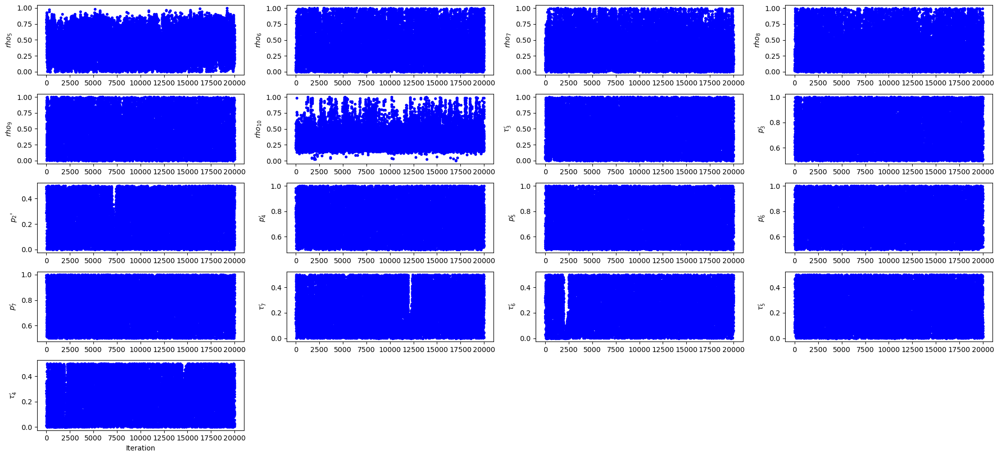

In [44]:
plt.style.use('default') # 'ggplot' Other styles at https://matplotlib.org/3.1.1/gallery/style_sheets/style_sheets_reference.html
plt.figure(facecolor="white")
settings = dict(
    fig=dict(figsize=(20, 10))
)
# Later make this authomatic!!!
NamesParamsParallelChains_2ndWave =[r'$rho_5$',r'$rho_6$',r'$rho_7$',r'$rho_8$',r'$rho_9$',r'$rho_{10}$',
                                    r"$\tau_3'$",r"$p_3'$",r"$p_2$'",r"$p_4'$",r"$p_5'$",
                                    r"$p_6'$",r"$p_7'$",r"$\tau_7'$",r"$\tau_{6}'$",
                                    r"$\tau_{5}'$",r"$\tau_{4}'$"]

mcp.plot_chain_panel(ConcatenatedExtractedChains_2ndWave,NamesParamsParallelChains_2ndWave, settings,maxpoints=2000000)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_1D_2ndWave.png')


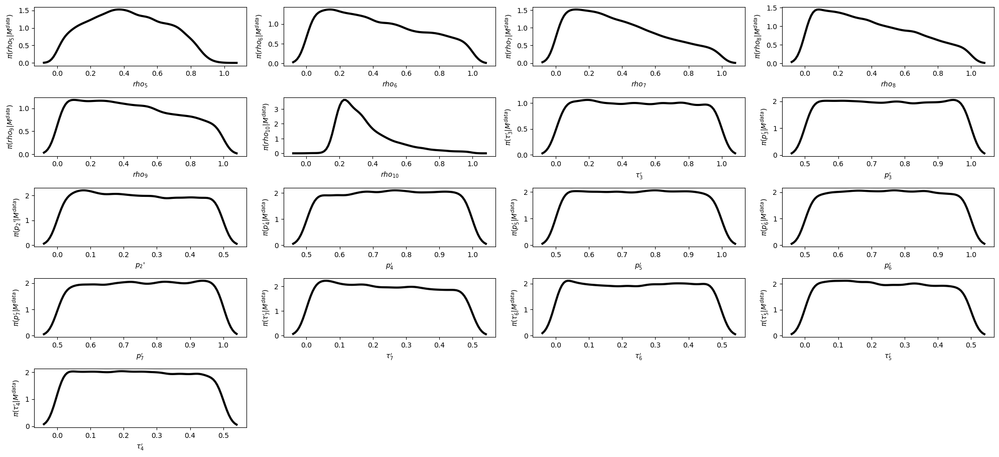

In [45]:
mcp.plot_density_panel(ConcatenatedExtractedChains_2ndWave,NamesParamsParallelChains_2ndWave, settings)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_Posteriors_1D_2ndWave' + FileFormatOfFigures)

In [ ]:
Plot_Multiple_2D_Densities(ConcatenatedExtractedChains_2ndWave, NamesParamsParallelChains_2ndWave, 
                           FileNameForSaving='./Results_Luxembourg/Parallel8CutChains_Posteriors_2D_2ndWave' + FileFormatOfFigures)

In [40]:
# SO LET'S PLOT ONLY A SUBSET OF THESE MULTIPLE CHAINS

combined_chains_CUT_2ndWave = combined_chains_2ndWave[Indexes1OutOf100_For2000000,:]
index_2ndWave = np.array(index_2ndWave)
index_CUT_2ndWave = index_2ndWave[Indexes1OutOf100_For2000000]

In [ ]:
# VERY COOL, BUT CAN TAKE LONG TO RUN...!!! PERHAPS TOO LONG ACTUALLY... :P
# PLOT ONLY IF YOU CAN WAIT HALF AN HOUR!!!

settings = dict(
    pairgrid=dict(height=3.75, hue='index', despine=False),
    ld_type=sns.kdeplot,
    ld=dict(n_levels=5, shade=True, shade_lowest=False),
    md=dict(lw=3))
sns.set_context('talk')
fpg = mcp.plot_paired_density_matrix(
    chains=combined_chains_CUT_2ndWave,
    settings=settings,
    index=index_CUT_2ndWave)
tmp = fpg.add_legend()

plt.savefig('./Results_Luxembourg/ParallelChainsDensityPlots_2ndWave_Luxembourg.png')

In [51]:
##############################
### PARALLEL MCMC 3rd WAVE ###
##############################

In [78]:
def gpp2_3rdWave(u,t,theta):
    
    ListOfParameters = ListOfParametersfirstwave
    
    # 1st Wave

    alpha=ListOfParameters[0] 
    beta=ListOfParameters[1]
    p1=ListOfParameters[2]
    p2=ListOfParameters[3]
    p3=ListOfParameters[4]
    p4=ListOfParameters[5]
    p5=ListOfParameters[6]
    p6=ListOfParameters[7]
    p7=ListOfParameters[8]
    p9=ListOfParameters[9]
    tau1 = ListOfParameters[10]
    tau2 = ListOfParameters[11]
    tau3 = ListOfParameters[12]
    tau4 = ListOfParameters[13]
    tau5 = ListOfParameters[14]
    tau6 = ListOfParameters[15]
    tau7 = ListOfParameters[16]
    tau8 = ListOfParameters[17]
    tau9 = ListOfParameters[18]
    
    # 2nd Wave

    p2prim=ListOfParameters[19]
    p3prim=ListOfParameters[20]
    p4prim=ListOfParameters[21]
    p5prim=ListOfParameters[22]
    p6prim=ListOfParameters[23]
    p7prim=ListOfParameters[24]
    p9prim=ListOfParameters[25]
    tau3prim=ListOfParameters[26]
    tau4prim=ListOfParameters[27]
    tau5prim=ListOfParameters[28]
    tau6prim=ListOfParameters[29]
    tau7prim=ListOfParameters[30]
    tau8prim=ListOfParameters[31]
    tau9prim=ListOfParameters[32]
    p1prim=ListOfParameters[33]
        
    rho1=ListOfRhos[1]
    rho2=ListOfRhos[2]
    rho3=ListOfRhos[3]
    rho4=ListOfRhos[4]
    rho5=ListOfRhos[5]
    rho6=ListOfRhos[6]
    rho7=ListOfRhos[7]
    rho8=ListOfRhos[8]
    rho9=ListOfRhos[9]
    rho10=ListOfRhos[10]
    
    rho11=theta[0]
    rho12=theta[1]
    rho13=theta[2]
    
    ListOfRhostrial=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]
    
    # 3rd Wave
        
    tau3prim2=theta[3]

    p2prim2=theta[4]
    p3prim2=theta[5]
    p4prim2=theta[6]
    p5prim2=theta[7]
    p6prim2=theta[8]
    p7prim2=theta[9]
    p9prim2=p9prim

    tau7prim2=theta[10]
    tau6prim2=theta[11]
    tau5prim2=theta[12]
    tau4prim2=theta[13]
    
    tau8prim2=tau8prim
    tau9prim2=tau9prim
    
    ListOfParametersfirstwave_MOD=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2])
    
    y=model_SEIRICUHOS(u,t,ListOfRhostrial,ListOfParametersfirstwave_MOD)
    return y

In [79]:
def errorxy12_3rdWave(theta,data):

    N=623180
    P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
    tt=len(SevenDaysMovingAverage_TotalCases)
    RMS=np.zeros(tt+1)
    endsecondwave=204
    t2=np.linspace(0,tt-1,tt)
    y=data1

    resultsseir2=odeint(gpp2_3rdWave,P2,t2,args=(theta,))
    
    # S, E, R ,I ,Q, A, D,H,Hl,ICU, AICU,NI,NI1,R1,D1
    
    cc=(resultsseir2[endsecondwave:tt,2]+resultsseir2[endsecondwave:tt,3]+resultsseir2[endsecondwave:tt,4]+resultsseir2[endsecondwave:tt,6]+resultsseir2[endsecondwave:tt,7]+resultsseir2[endsecondwave:tt,8]+resultsseir2[endsecondwave:tt,9]+resultsseir2[endsecondwave:tt,10]+resultsseir2[endsecondwave:tt,11]+resultsseir2[endsecondwave:tt,15])*N-y[0,endsecondwave:tt]
    cci=((cc**2).sum(axis=0))
    
    
    # dead at home -> dead at home
    ai=((resultsseir2[endsecondwave:tt,15])*N-y[4,endsecondwave:tt])
    aai=((ai**2).sum(axis=0))
    
    # icu -> icu
    bi=((resultsseir2[endsecondwave:tt,9])*N- y[1,endsecondwave:tt])
    bbi=((bi**2).sum(axis=0))
    
    # hospital -> hos + aicu
    ee=((resultsseir2[endsecondwave:tt,7]+resultsseir2[endsecondwave:tt,8]+resultsseir2[endsecondwave:tt,10])*N)-y[2,endsecondwave:tt]
    eei=((ee**2).sum(axis=0))
    
    # dead in Hospital/ICU -> dead in Hospital/ICU 
    di=((resultsseir2[endsecondwave:tt,6])*N- y[3,endsecondwave:tt])
    ddi=((di**2).sum(axis=0))

    RMS= cci + eei + aai + bbi + ddi
    
    return RMS

In [88]:
# initialize MCMC object
MyNew_mcstat_3rdWave = MCMC(rngseed=123456789)

# initialize data structure 
MyNew_mcstat_3rdWave.data.add_data_set(x=df2['Date'],y=data1)

MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='rho11', minimum=0, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='rho12', minimum=0, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='rho13', minimum=0, maximum=1)

MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='tau3prim2', minimum=0, maximum=1)

MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p2prim2', minimum=0, maximum=0.5)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p3prim2', minimum=0.5, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p4prim2', minimum=0.5, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p5prim2', minimum=0.5, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p6prim2', minimum=0.5, maximum=1)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='p7prim2', minimum=0.5, maximum=1)

MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='tau7prim2', minimum=0, maximum=0.5)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='tau6prim2', minimum=0, maximum=0.5)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='tau5prim2', minimum=0, maximum=0.5)
MyNew_mcstat_3rdWave.parameters.add_model_parameter(name='tau4prim2', minimum=0, maximum=0.5)

# Define options
datestr = datetime.now().strftime('%Y%m%d_%H%M%S')
savedir = 'Saved_MCMC_Chains' + os.sep + str('{}_{}'.format(datestr, 'parallel_chains'))
MyNew_mcstat_3rdWave.simulation_options.define_simulation_options(nsimu=int(500e3), updatesigma=True, method='dram',
                                                         savedir=savedir, savesize=10000, save_to_json=True,
                                                          save_lightly=True, save_to_bin=True)
MyNew_mcstat_3rdWave.model_settings.define_model_settings(sos_function=errorxy12_3rdWave)


In [89]:
My_Parallel_MCMC_3rdWave = ParallelMCMC()
My_Parallel_MCMC_3rdWave.setup_parallel_simulation(MyNew_mcstat_3rdWave, initial_values=None, num_cores=8, num_chain=8)

In [90]:
# DO NOT RE-RUN THIS UNLESS YOU WISH A NEW MCMC CHAIN (CAN TAKE 8 HOURS WITH 500000 ITERATIONS)
My_Parallel_MCMC_3rdWave.run_parallel_simulation()

Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_2Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_0Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_5Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_4Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_6Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_7Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_3

Processing: Saved_MCMC_Chains/20201222_033753_parallel_chains/chain_1






Sampling these parameters:
Sampling these parameters:
Sampling these parameters:
Sampling these parameters:
Sampling these parameters:
Sampling these parameters:

Sampling these parameters:


Sampling these parameters:      name      start [      min,       max] N(       mu,   sigma^2)      name      start [      min,       max] N(       mu,   sigma^2)


      name      start [      min,       max] N(       mu,   sigma^2)
      name   

In [83]:
My_Parallel_MCMC_3rdWave.display_individual_chain_statistics()


****************************************
Displaying results for chain 0
Files: Saved_MCMC_Chains/20201222_033530_parallel_chains/chain_0


------------------------------
name      :       mean        std     MC_err        tau     geweke
rho11     :     0.4209     0.0299     0.0087    10.7707     0.7883
rho12     :     0.3367     0.0595     0.0177     5.9789     0.5648
rho13     :     0.6655     0.0535     0.0166    11.9014     0.7087
tau3prim2 :     0.6536     0.0744     0.0220     7.9994     0.9355
p2prim2   :     0.1328     0.0058     0.0014     5.2056     0.9483
p3prim2   :     0.9176     0.0611     0.0172    11.3995     0.8554
p4prim2   :     0.6784     0.1703     0.0550    12.3042     0.6780
p5prim2   :     0.5984     0.0526     0.0152    12.1467     0.9569
p6prim2   :     0.8669     0.0750     0.0224     7.2402     0.9433
p7prim2   :     0.6608     0.0653     0.0190     6.3703     0.7830
tau7prim2 :     0.3354     0.0351     0.0104    12.3100     0.9364
tau6prim2 :     0.2925   

In [58]:
DirectoryOfPreviousRunMCMC = 'Saved_MCMC_Chains/20201222_033753_parallel_chains_3rdWave_Lux'
# 8 chains, 500k each
pres_3rdWave = CP.load_parallel_simulation_results(DirectoryOfPreviousRunMCMC)
combined_chains_3rdWave, index_3rdWave = CP.generate_combined_chain_with_index(pres_3rdWave)

In [60]:
np.shape(combined_chains_3rdWave)

(2000000, 14)

In [61]:
# NOW COMPUTE AN INDICATOR TO SEE IF THE MULTIPLE CHAINS HAVE CONVERGED TO THE SAME TARGET POSTERIOR DISTRIBUTION 
# OR IF YOU NEED LONGER CHAINS

# Gelman-Rubin Diagnostic (https://github.com/prmiles/pymcmcstat_examples/blob/master/Running_Parallel_Chains.ipynb)

chains_3rdWave = CP.generate_chain_list(pres_3rdWave)
psrf_3rdWave = CS.gelman_rubin(chains=chains_3rdWave, display=True)

# In general, R closer to 1 indicates your chains have converged.

Parameter: $p_{0}$
  R = 1.0031746279614693
  B = 0.6664461108785027
  W = 0.00047129498647496257
  V = 0.0004742921087939699
  neff = 1423.3472175830173
Parameter: $p_{1}$
  R = 1.0006422521394969
  B = 1.7485564101531939
  W = 0.006104741631375775
  V = 0.0061125857162549375
  neff = 6991.579660526255
Parameter: $p_{2}$
  R = 1.0009796596806875
  B = 12.720920143283728
  W = 0.0291425698140802
  V = 0.029199697384445722
  neff = 4590.815295678482
Parameter: $p_{3}$
  R = 1.0014983607436934
  B = 51.07823036799743
  W = 0.0765416567656225
  V = 0.07677120263565143
  neff = 3006.0243701689274
Parameter: $p_{4}$
  R = 1.0015155096664643
  B = 11.641782118981862
  W = 0.017248128863730835
  V = 0.017300447890750803
  neff = 2972.130506126294
Parameter: $p_{5}$
  R = 1.0010698652151022
  B = 9.818429776214
  W = 0.020599304450032708
  V = 0.020643404986807872
  neff = 4205.031854852864
Parameter: $p_{6}$
  R = 1.001325234508248
  B = 12.29531259406435
  W = 0.02082990002544095
  V = 0.020

In [62]:
print(np.shape(chains_3rdWave))

if np.shape(chains_3rdWave)[1] <= 10000:
    OneStepEveryNinChains = 1
elif np.shape(chains_3rdWave)[1] > 10000 and np.shape(chains_3rdWave)[1] <= 100000:
    OneStepEveryNinChains = 10
elif np.shape(chains_3rdWave)[1] >= 100000:
    OneStepEveryNinChains = 100

Indexes1OutOf100 = np.arange(0,np.shape(chains_3rdWave)[1],OneStepEveryNinChains)
Indexes1OutOf100 = Indexes1OutOf100.astype(int)

## Prepare indexes to cut chains, only 1 point every 100
print(np.shape(chains_3rdWave[0][Indexes1OutOf100,:]))

# Cut chains and concatenate them
MyChain_3rdWave = chains_3rdWave[0][Indexes1OutOf100,:]
#MyChain_2ndWave = chains_2ndWave[0][:,:]
#MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[100::,:]
MyChain_BurninRemoved_3rdWave = MyChain_3rdWave[:,:]
ConcatenatedExtractedChains_3rdWave = MyChain_BurninRemoved_3rdWave
print(np.shape(ConcatenatedExtractedChains_3rdWave))
for i in range(7):
    # Take out first 10000 of each chain i.e. 100 of the points left) for burnin
    MyChain_3rdWave = chains_3rdWave[i+1][Indexes1OutOf100,:]
    #MyChain_BurninRemoved_2ndWave = MyChain_2ndWave[100::,:]
    #MyChain_2ndWave = chains_2ndWave[i+1][:,:]
    MyChain_BurninRemoved_3rdWave = MyChain_3rdWave[:,:]
    
    # Than concatenate
    ConcatenatedExtractedChains_3rdWave = np.concatenate((ConcatenatedExtractedChains_3rdWave,MyChain_BurninRemoved_3rdWave),axis=0)
print(np.shape(ConcatenatedExtractedChains_3rdWave))

(8, 250000, 14)
(2500, 14)
(2500, 14)
(20000, 14)


<Figure size 640x480 with 0 Axes>

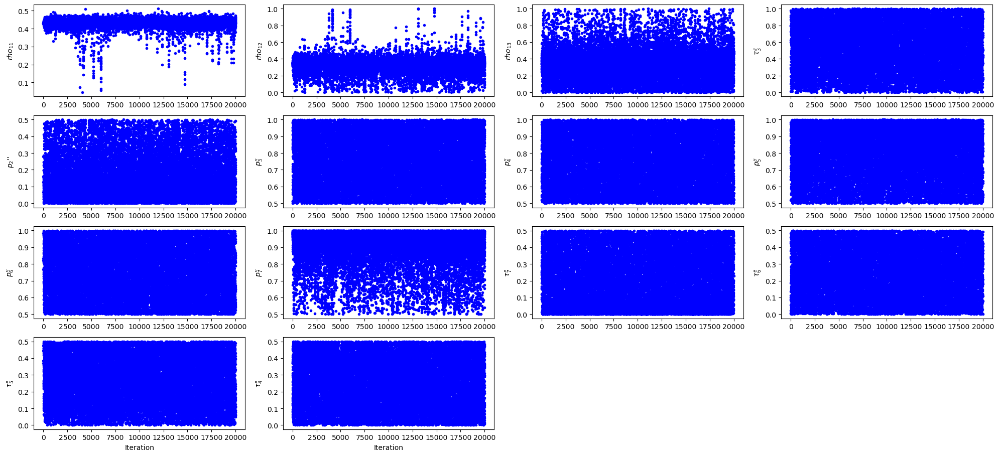

In [63]:
plt.style.use('default') # 'ggplot' Other styles at https://matplotlib.org/3.1.1/gallery/style_sheets/style_sheets_reference.html
plt.figure(facecolor="white")
settings = dict(
    fig=dict(figsize=(20, 10))
)
# Later make this authomatic!!!
NamesParamsParallelChains_3rdWave =[r'$rho_{11}$',r'$rho_{12}$',r'$rho_{13}$',#r'$rho_{14}$',r'$rho_{15}$',
                                    r"$\tau_3''$",r"$p_2$''",r"$p_3''$",r"$p_4''$",r"$p_5''$",
                                    r"$p_6''$",r"$p_7''$",r"$\tau_7''$",r"$\tau_{6}''$",
                                    r"$\tau_{5}''$",r"$\tau_{4}''$"]

mcp.plot_chain_panel(ConcatenatedExtractedChains_3rdWave,NamesParamsParallelChains_3rdWave, settings,maxpoints=2000000)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_1D_3rdWave.png')


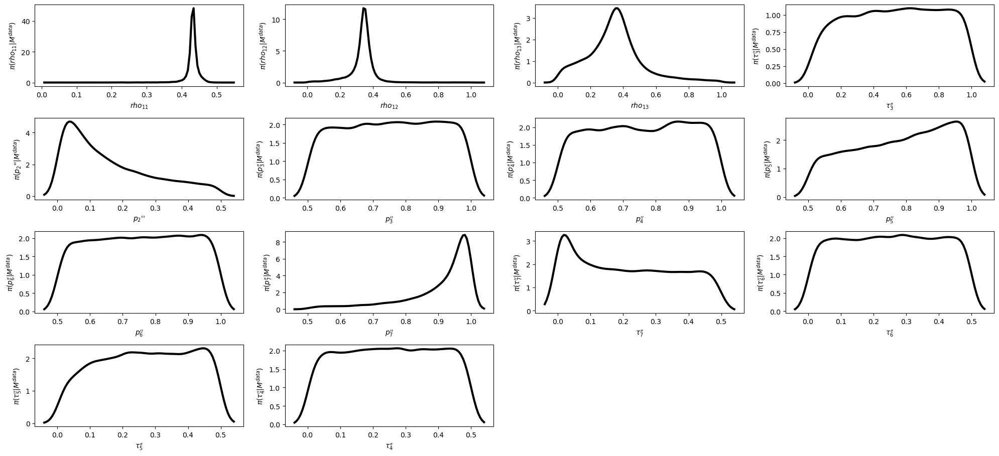

In [64]:
mcp.plot_density_panel(ConcatenatedExtractedChains_3rdWave,NamesParamsParallelChains_3rdWave, settings)
plt.savefig('./Results_Luxembourg/Parallel8CutChains_Posteriors_1D_3rdWave' + FileFormatOfFigures)

In [ ]:
Plot_Multiple_2D_Densities(ConcatenatedExtractedChains_3rdWave, NamesParamsParallelChains_3rdWave, 
                           FileNameForSaving='./Results_Luxembourg/Parallel8CutChains_Posteriors_2D_3rdWave' + FileFormatOfFigures)

In [ ]:
# SO LET'S PLOT ONLY A SUBSET OF THESE MULTIPLE CHAINS

combined_chains_CUT_3rdWave = combined_chains_3rdWave[Indexes1OutOf100_For2000000,:]
index_3rdWave = np.array(index_3rdWave)
index_CUT_3rdWave = index_3rdWave[Indexes1OutOf100_For2000000]

In [ ]:
# VERY COOL, BUT CAN TAKE LONG TO RUN...!!! PERHAPS TOO LONG ACTUALLY... :P
# PLOT ONLY IF YOU CAN WAIT HALF AN HOUR!!!

settings = dict(
    pairgrid=dict(height=3.75, hue='index', despine=False),
    ld_type=sns.kdeplot,
    ld=dict(n_levels=5, shade=True, shade_lowest=False),
    md=dict(lw=3))
sns.set_context('talk')
fpg = mcp.plot_paired_density_matrix(
    chains=combined_chains_CUT_3rdWave,
    settings=settings,
    index=index_CUT_3rdWave)
tmp = fpg.add_legend()

plt.savefig('./Results_Luxembourg/ParallelChainsDensityPlots_3rdWave_Luxembourg.png')

In [66]:

###################################################
### PLOT RHOs FROM MCMC WITH CREDIBLE INTERVALS ###
###################################################


Computing max of posteriors for each given parameter...
0.7362398329850636
0.17570594276658322
0.0567834041434415
0.11510813691741192
Computing max of posteriors for each given parameter...
0.3698683195382167
0.14174777213913647
0.12080603956630469
0.07663759478653981
0.09534620214796122
0.2305111402857339
Computing max of posteriors for each given parameter...
0.432048397202422
0.3478259440946967
0.360311675563066


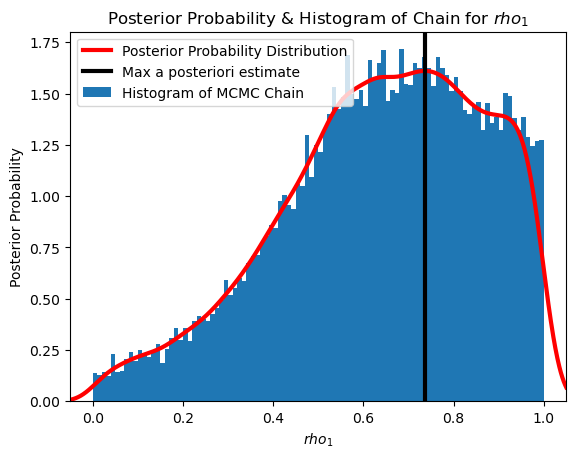

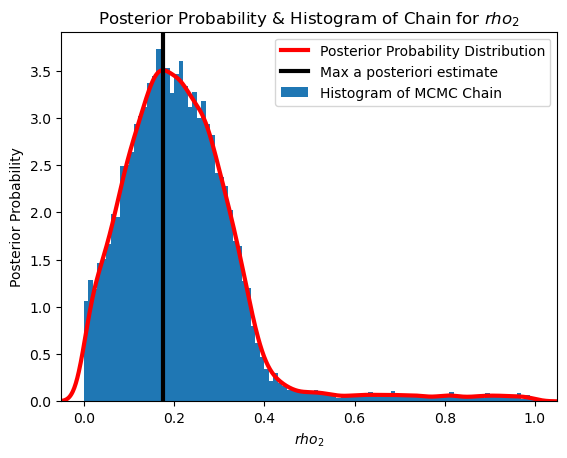

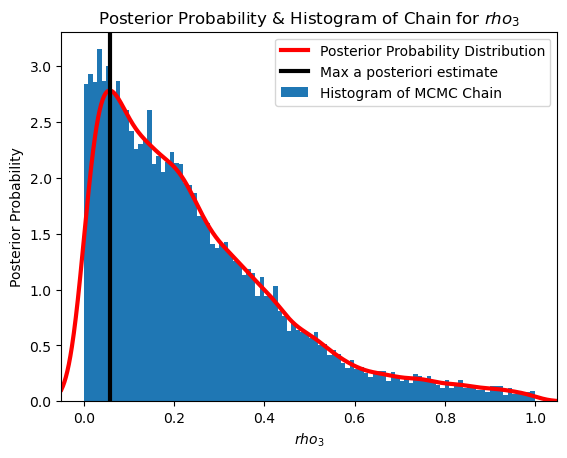

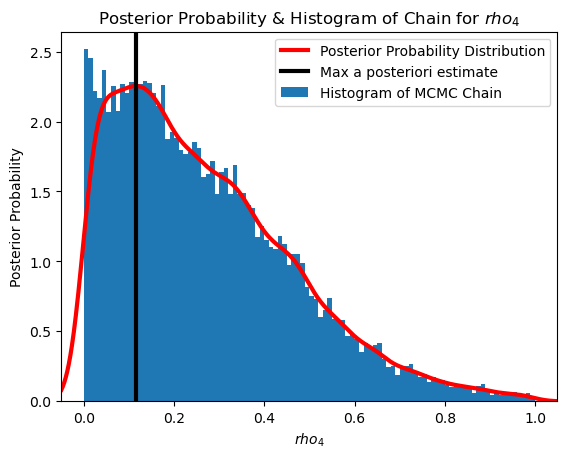

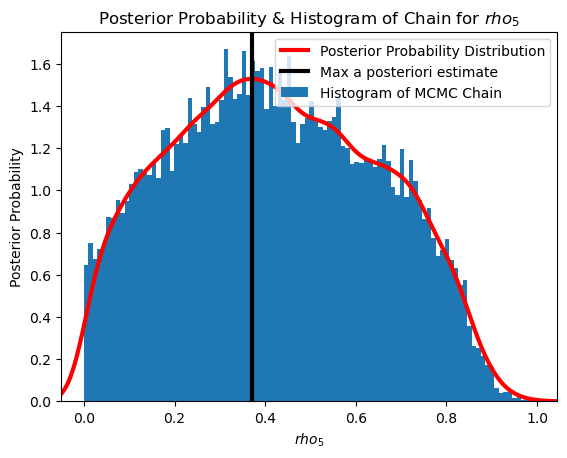

...

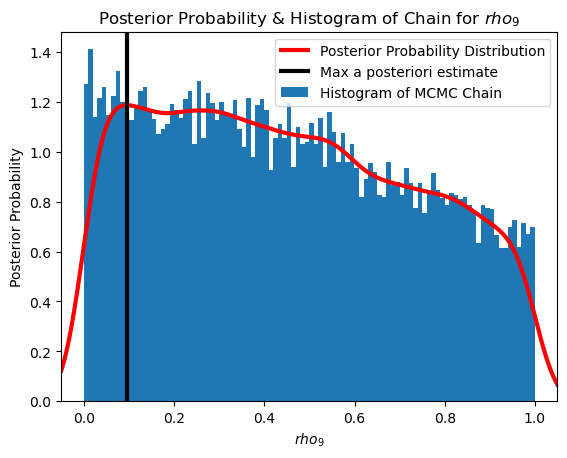

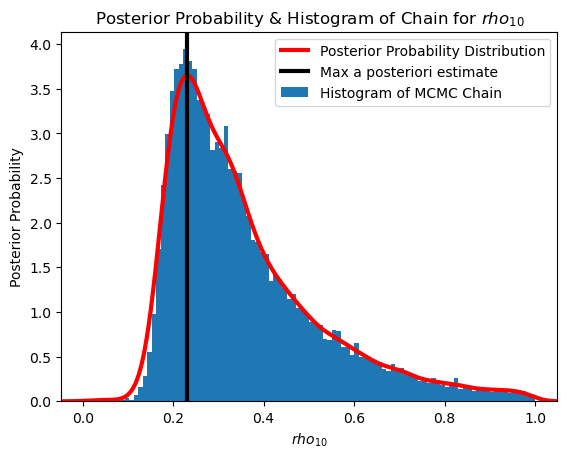

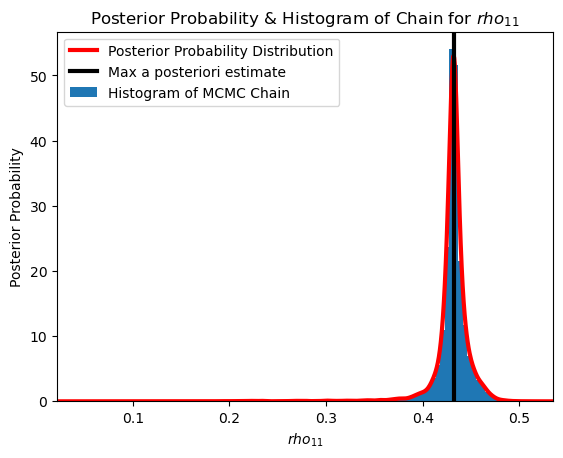

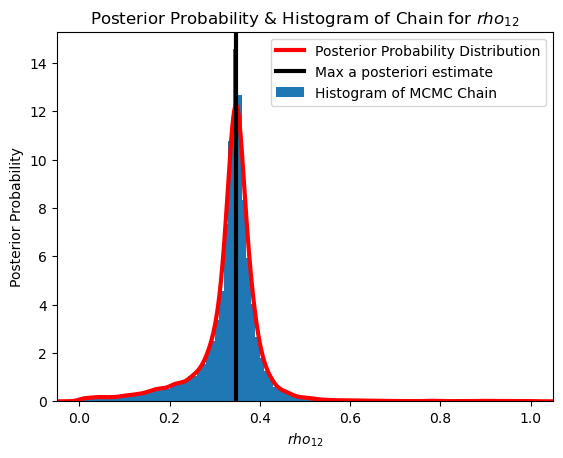

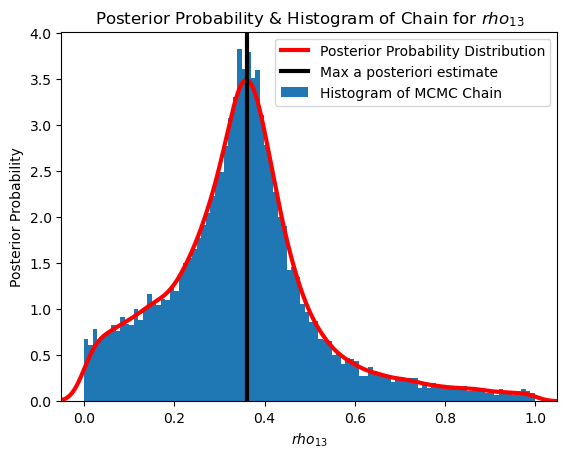

In [67]:
######################################################################
##### LET'S GET MEAN VALUES OF RHOS FROM POSTERIOR DISTRIBUTIONS #####
######################################################################

def GetMeansPosteriorSelectedParams(ListOfRhosNames,Chains,Names):
    ListOfRhos_MCMC_Mean_ThisWave = []
    for name_this_rho in ListOfRhosNames:
        Index_this_rho = Names.index(name_this_rho)
        Chain_this_rho = Chains[:,Index_this_rho]
        Mean_this_chain = statistics.mean(Chain_this_rho)
        ListOfRhos_MCMC_Mean_ThisWave.append(Mean_this_chain)
    return ListOfRhos_MCMC_Mean_ThisWave
    
ListOfRhosNames_1stWave = ['$rho_1$','$rho_2$','$rho_3$','$rho_4$']
ListOfRhosNames_2ndWave = ['$rho_5$','$rho_6$','$rho_7$','$rho_8$','$rho_9$','$rho_{10}$']
ListOfRhosNames_3rdWave = ['$rho_{11}$','$rho_{12}$','$rho_{13}$']

ListOfMeansRhosMCMC_1stWave = GetMeansPosteriorSelectedParams(ListOfRhosNames_1stWave,
                                                              ConcatenatedExtractedChains,
                                                              NamesParamsParallelChains)
ListOfMeansRhosMCMC_2ndWave = GetMeansPosteriorSelectedParams(ListOfRhosNames_2ndWave,
                                                              ConcatenatedExtractedChains_2ndWave,
                                                              NamesParamsParallelChains_2ndWave)
ListOfMeansRhosMCMC_3rdWave = GetMeansPosteriorSelectedParams(ListOfRhosNames_3rdWave,
                                                              ConcatenatedExtractedChains_3rdWave,
                                                              NamesParamsParallelChains_3rdWave)    
# Put here the values of rho coming from Means of MCMC
ListOfRhos_MCMC_MeansPosteriors = [1] + ListOfMeansRhosMCMC_1stWave + ListOfMeansRhosMCMC_2ndWave + ListOfMeansRhosMCMC_3rdWave

############################################################################
##### NOW LET'S GET THE MAX VALUES OF DISTRIBUTIONS VIA A GAUSSIAN KDE #####
############################################################################

def PosteriorsWithMaxFromHisto(ListOfRhosNames,Chains,Names):

    ListIndexesOfParams = []
    for name_this_rho in ListOfRhosNames:
        Index_this_rho = Names.index(name_this_rho)
        ListIndexesOfParams.append(Index_this_rho)
    
    ListOfMaxPosteriorsValues = []
    ListOfKDEs = []
    ListOfPosteriorValuesOnGrid = []
    ListOfGrids = []
    
    print("Computing max of posteriors for each given parameter...")
    for i in ListIndexesOfParams:
        plt.figure(facecolor="white")
        plt.hist(Chains[:,i], density=True, bins=100, label="Histogram of MCMC Chain")
        mn, mx = plt.xlim()
        plt.xlim(mn, mx)
        kde_xs = np.linspace(mn, mx, 1000)
        kde = st.gaussian_kde(Chains[:,i])
        plt.plot(kde_xs,kde.pdf(kde_xs),label="Posterior Probability Distribution",linewidth=3,color='red')
        plt.ylabel('Posterior Probability')
        plt.xlabel(Names[i])
        plt.title("Posterior Probability & Histogram of Chain for " + str(Names[i]));
        posterior=list(kde.pdf(kde_xs))
        a=posterior.index(max(posterior))
        plt.axvline(x=kde_xs[a],linewidth=3,color='black',label='Max a posteriori estimate')
        plt.legend(loc="best")
        print(kde_xs[a])
        ListOfMaxPosteriorsValues.append(kde_xs[a])
        ListOfKDEs.append(kde)
        ListOfPosteriorValuesOnGrid.append(posterior)
        ListOfGrids.append(kde_xs)

    return ListOfMaxPosteriorsValues, ListOfKDEs, ListOfPosteriorValuesOnGrid, ListOfGrids

ListOfMaxPosteriorsValues_1stWave, ListOfKDEs_1stWave,ListOfPosteriorValuesOnGrid_1stWave, ListOfGrids_1stWave = PosteriorsWithMaxFromHisto(ListOfRhosNames_1stWave,
                                                                                   ConcatenatedExtractedChains,
                                                                                   NamesParamsParallelChains)
ListOfMaxPosteriorsValues_2ndWave, ListOfKDEs_2ndWave,ListOfPosteriorValuesOnGrid_2ndWave, ListOfGrids_2ndWave = PosteriorsWithMaxFromHisto(ListOfRhosNames_2ndWave,
                                                                                   ConcatenatedExtractedChains_2ndWave,
                                                                                   NamesParamsParallelChains_2ndWave)
ListOfMaxPosteriorsValues_3rdWave, ListOfKDEs_3rdWave,ListOfPosteriorValuesOnGrid_3rdWave, ListOfGrids_3rdWave = PosteriorsWithMaxFromHisto(ListOfRhosNames_3rdWave,
                                                                                   ConcatenatedExtractedChains_3rdWave,
                                                                                   NamesParamsParallelChains_3rdWave)

# Put here the values of rho coming from Max of MCMC Posterior
ListOfRhos_MCMC_MaxsPosterior = [1] + ListOfMaxPosteriorsValues_1stWave + ListOfMaxPosteriorsValues_2ndWave + ListOfMaxPosteriorsValues_3rdWave


In [68]:

#############################################################
#####  NOW LET'S GET THE 50% and 90% CONFIDENCE BANDS   #####
#############################################################

    # IF TOO SLOW, REDUCE THE NUMBER OF Y VALUES FROM 1000 TO 200 OR 100 OR SO, 
    # IT IS GOING TO BE SLIGHTLY LESS PRECISE BUT MUCH FASTER

def ExtractConfidenceIntervalsFromPosteriors(ListOfGrids, ListOfPosteriorValuesOnGrid, ListOfKDEs, Names):

    MyListOfRhos_MCMC_Lower50 = []
    MyListOfRhos_MCMC_Upper50 = []
    MyListOfRhos_MCMC_Lower90 = []
    MyListOfRhos_MCMC_Upper90 = []

    for IndexMain in np.arange(len(Names)):
        xGrid = ListOfGrids[IndexMain]
        # Create y grid
        MyPosterior = ListOfPosteriorValuesOnGrid[IndexMain]
        yGrid = np.linspace(max(MyPosterior), 0, 1000)
        Found50Perc = False
        Found90Perc = False
        for this_y in yGrid:
            IndexesOfPeak = [MyPosterior >= this_y]
            XsOfPeak = xGrid[IndexesOfPeak[0]]
            xMin = min(XsOfPeak)
            xMax = max(XsOfPeak)
            Integral = ListOfKDEs[IndexMain].integrate_box_1d(xMin, xMax)
            if Found50Perc == False:
                if Integral >= 0.5:
                    print("50% Interval found!!!")
                    Found50Perc = True
                    xMin_50 = xMin
                    xMax_50 = xMax
            elif Found50Perc == True and Found90Perc == False:
                if Integral >= 0.9:
                    print("90% Interval found!!!")
                    Found90Perc = True
                    xMin_90 = xMin
                    xMax_90 = xMax
                    break      
        print()
        print("Min and Max of parameter " + Names[IndexMain] + " for 50% Confidence Interval are: ")
        print(xMin_50)
        print(xMax_50)
        print("Min and Max of parameter " + Names[IndexMain] + " for 90% Confidence Interval are: ")
        print(xMin_90)
        print(xMax_90)
        print()

        MyListOfRhos_MCMC_Lower50.append(xMin_50)
        MyListOfRhos_MCMC_Upper50.append(xMax_50)
        MyListOfRhos_MCMC_Lower90.append(xMin_90)
        MyListOfRhos_MCMC_Upper90.append(xMax_90)
    
    return MyListOfRhos_MCMC_Lower50, MyListOfRhos_MCMC_Upper50, MyListOfRhos_MCMC_Lower90, MyListOfRhos_MCMC_Upper90

ListOfRhos_MCMC_Lower50_1stWave, ListOfRhos_MCMC_Upper50_1stWave, ListOfRhos_MCMC_Lower90_1stWave, ListOfRhos_MCMC_Upper90_1stWave = ExtractConfidenceIntervalsFromPosteriors(ListOfGrids_1stWave,
ListOfPosteriorValuesOnGrid_1stWave,
ListOfKDEs_1stWave,
ListOfRhosNames_1stWave)

ListOfRhos_MCMC_Lower50_2ndWave, ListOfRhos_MCMC_Upper50_2ndWave, ListOfRhos_MCMC_Lower90_2ndWave, ListOfRhos_MCMC_Upper90_2ndWave = ExtractConfidenceIntervalsFromPosteriors(ListOfGrids_2ndWave,
ListOfPosteriorValuesOnGrid_2ndWave,
ListOfKDEs_2ndWave,
ListOfRhosNames_2ndWave)

ListOfRhos_MCMC_Lower50_3rdWave, ListOfRhos_MCMC_Upper50_3rdWave, ListOfRhos_MCMC_Lower90_3rdWave, ListOfRhos_MCMC_Upper90_3rdWave = ExtractConfidenceIntervalsFromPosteriors(ListOfGrids_3rdWave,
ListOfPosteriorValuesOnGrid_3rdWave,
ListOfKDEs_3rdWave,
ListOfRhosNames_3rdWave)

ListOfRhos_MCMC_Lower50 = [1] + ListOfRhos_MCMC_Lower50_1stWave + ListOfRhos_MCMC_Lower50_2ndWave + ListOfRhos_MCMC_Lower50_3rdWave
ListOfRhos_MCMC_Upper50 = [1] + ListOfRhos_MCMC_Upper50_1stWave + ListOfRhos_MCMC_Upper50_2ndWave + ListOfRhos_MCMC_Upper50_3rdWave

ListOfRhos_MCMC_Lower90 = [1] + ListOfRhos_MCMC_Lower90_1stWave + ListOfRhos_MCMC_Lower90_2ndWave + ListOfRhos_MCMC_Lower90_3rdWave
ListOfRhos_MCMC_Upper90 = [1] + ListOfRhos_MCMC_Upper90_1stWave + ListOfRhos_MCMC_Upper90_2ndWave + ListOfRhos_MCMC_Upper90_3rdWave

50% Interval found!!!
90% Interval found!!!

Min and Max of parameter $rho_1$ for 50% Confidence Interval are: 
0.5369896513688815
0.8606335927785915
Min and Max of parameter $rho_1$ for 90% Confidence Interval are: 
0.3025129183067447
1.0059431174931552

50% Interval found!!!
90% Interval found!!!

Min and Max of parameter $rho_2$ for 50% Confidence Interval are: 
0.11956734686552842
0.2714717828330884
Min and Max of parameter $rho_2$ for 90% Confidence Interval are: 
0.01829772288715508
0.36613686611722

50% Interval found!!!
90% Interval found!!!

Min and Max of parameter $rho_3$ for 50% Confidence Interval are: 
0.012762146841629608
0.2218631190252361
Min and Max of parameter $rho_3$ for 90% Confidence Interval are: 
-0.0268569847300011
0.5388161715982818

50% Interval found!!!
90% Interval found!!!

Min and Max of parameter $rho_4$ for 50% Confidence Interval are: 
0.018264536822539243
0.2614740325153445
Min and Max of parameter $rho_4$ for 90% Confidence Interval are: 
-0.0191523

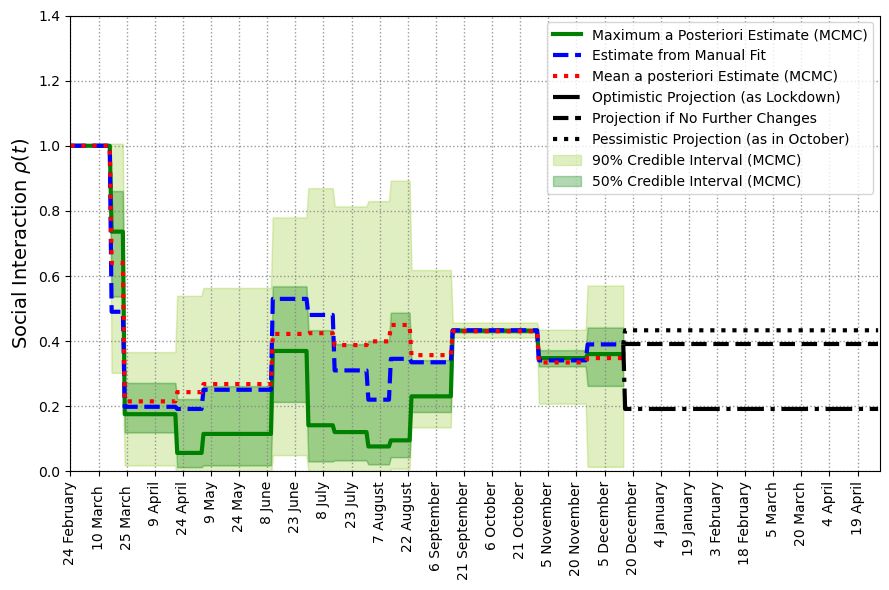

In [87]:
###############################
#####  NOW LET'S PLOT IT  #####
###############################
"""
def rhoAsFunctionforLuxembourgUNTILrho10(time,ListOfRhosUNTILrho10):
    ListOfRhos = ListOfRhosUNTILrho10
    ListOfRhos.append(ListOfRhos[-1])
    ListOfRhos.append(ListOfRhos[-1])
    ListOfRhos.append(ListOfRhos[-1])
    ListOfRhos.append(ListOfRhos[-1])
    Rho = rhoAsFunctionforLuxembourg(time,ListOfRhos)
    return Rho
"""

plt.figure(figsize=(9, 6),facecolor="white")

stop = NumberDaysData # Remember to stop this at the data points used for mcmc

#times=np.arange(0,endofplot+1,1) 
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Upper90)[0:stop],'-',color='yellowgreen', alpha=0.05)#,label='Data')
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Lower90)[0:stop],'-',color='yellowgreen', alpha=0.05)#,label='Data')
plt.fill_between(times[0:stop], rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Upper90)[0:stop], 
                 rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Lower90)[0:stop],color='yellowgreen', alpha=0.3,label=r'90% Credible Interval (MCMC)')
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Upper50)[0:stop],'-',color='green', alpha=0.05)#,label='Data')
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Lower50)[0:stop],'-',color='green', alpha=0.05)#,label='Data')
plt.fill_between(times[0:stop], rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Upper50)[0:stop], 
                 rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_Lower50)[0:stop],color='green', alpha=0.3,label='50% Credible Interval (MCMC)')
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_MaxsPosterior)[0:stop],'-',color='green',linewidth=3,label='Maximum a Posteriori Estimate (MCMC)')
ListOfRhosBestFit = ListOfRhos
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhosBestFit)[0:stop],'--',color='blue',linewidth=3,label='Estimate from Manual Fit')
plt.plot(times[0:stop],rhoAsFunctionforLuxembourg(times,ListOfRhos_MCMC_MeansPosteriors)[0:stop],':',color='red',linewidth=3,label='Mean a posteriori Estimate (MCMC)')

ListOptimistic = Rho_BestScenario*np.ones(len(times))[stop:-1]
ListPessimistic = Rho_WorstScenario*np.ones(len(times))[stop:-1]

ListOptimistic = [ListOfRhos[-1]] + list(ListOptimistic)
ListPessimistic = [ListOfRhos[-1]] + list(ListPessimistic)

plt.plot(times[stop-1:-1],ListOptimistic,'-.',color='black',linewidth=3,label='Optimistic Projection (as Lockdown)')
plt.plot(times[stop:-1],rhoAsFunctionforLuxembourg(times,ListOfRhosBestFit)[stop:-1],'--',color='black',linewidth=3,label='Projection if No Further Changes')
plt.plot(times[stop-1:-1],ListPessimistic,':',color='black',linewidth=3,label='Pessimistic Projection (as in October)')

# plt.title('Luxembourg')

#locs, labels = plt.xticks()
#times=np.arange(0,endofplot+1,1)
#only10thindex=np.arange(0,endofplot+1,10)
#plt.xticks(times[only10thindex])
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90)

#plt.xlabel("Time(days)")
plt.ylabel(r"Social Interaction $\rho\left(t\right)$",size=14)

plt.ylim(0,1.4)
plt.xlim(0,endofplot)

plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

plt.tight_layout()
plt.legend(loc='upper right', fancybox=True, numpoints=1)
plt.savefig('./Results_Luxembourg/ParallelMCMC_RHOsAllEstimates' + FileFormatOfFigures)

0
0.7362398329850636
0.6400310796717313
[0.5263 0.8465]
[0.3271 0.9999]
1
0.17570594276658322
0.21509752562775977
[0.1213 0.2711]
[0.0221 0.3632]
2
0.0567834041434415
0.2433799174588582
[1.3205e-04 1.9409e-01]
[5.9871e-06 5.2131e-01]
3
0.11510813691741192
0.26818771007222525
[7.0081e-05 2.3075e-01]
[6.3168e-06 5.4345e-01]
4
0.9245173709060691
0.6532719209913538
[0.6608 0.9857]
[0.3324 0.9999]
5
0.9091211378155308
0.6404938542552114
[0.6662 0.9998]
[0.3073 1.    ]
6
0.1364605106526724
0.4686408570888673
[0.0392 0.4666]
[0.0237 0.9045]
7
0.7976209024645797
0.755462188432927
[0.6766 0.9098]
[0.5576 0.9993]
8
0.09227558855634163
0.19004862761986624
[0.0356 0.1908]
[1.0659e-05 3.7768e-01]
9
0.9451363795769265
0.7556478870985709
[0.7539 0.9942]
[0.5529 0.9994]
10
0.9457012508553431
0.7885468716930859
[0.8077 0.9999]
[0.5762 1.    ]
11
0.9269711770521507
0.7557219442557753
[0.7431 0.9841]
[0.5536 0.9972]
12
0.5360760990146407
0.600923120146669
[0.3278 0.6982]
[0.2926 0.9938]
13
1.013318056966

/Users/stefano.magni/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


0.14174777213913647
0.4245069158540314
[0.0018 0.3886]
[1.8222e-04 8.3759e-01]
2
0.12080603956630469
0.38786815801574304
[2.7550e-04 3.4486e-01]
[1.5874e-04 7.8680e-01]
3
0.07663759478653981
0.3993655145839892
[7.6772e-05 3.6202e-01]
[7.6772e-05 8.0095e-01]
4
0.09534620214796122
0.4496606393489267
[0.0008 0.4298]
[1.5617e-04 8.5639e-01]
5
0.2305111402857339
0.3570117316675071
[0.1848 0.3361]
[0.144  0.6098]
6
0.1922768400330424
0.4972735504223321
[0.0473 0.5366]
[0.0399 0.9349]
7
0.9478776168623173
0.7495323881802288
[0.5088 0.7581]
[0.5155 0.9664]
8
0.07906722326417173
0.24428108154313713
[0.0019 0.2415]
[0.012  0.4599]
9
0.7651226291126316
0.7523271347803847
[0.6702 0.9132]
[0.5388 0.9848]
10
0.7992817488926076
0.74812620660842
[0.6647 0.9111]
[0.5001 0.9466]
11
0.768990903099046
0.7499623597395914
[0.6384 0.8811]
[0.5513 0.998 ]
12
0.9385613810696423
0.7546929009746408
[0.7556 0.9999]
[0.5539 1.    ]
13
0.05760290245417761
0.2408523914282474
[0.0009 0.2379]
[0.0047 0.45  ]
14
0.0355

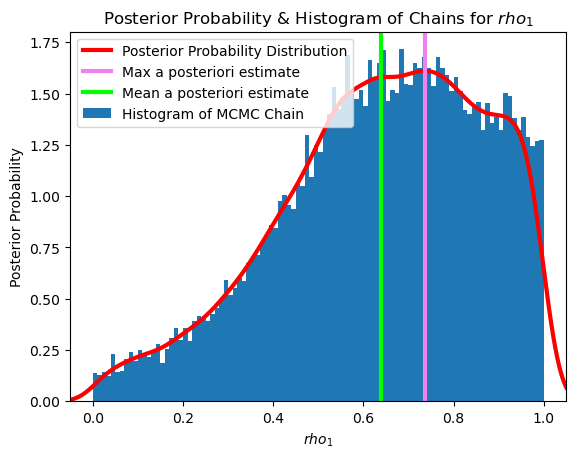

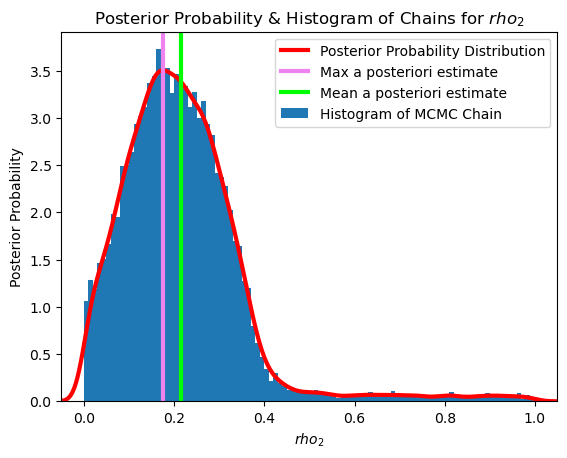

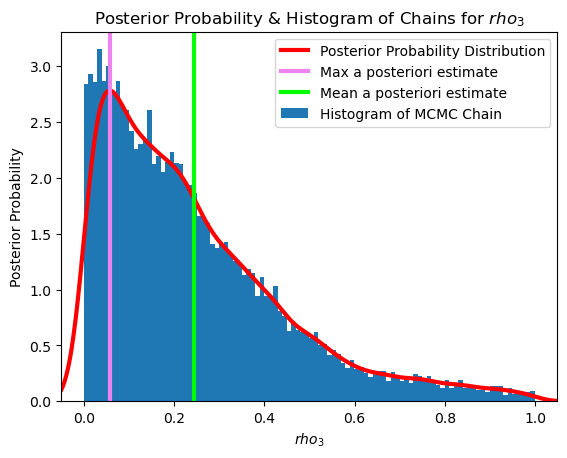

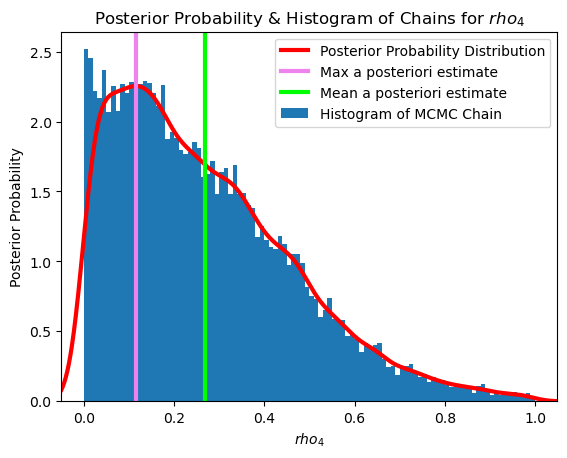

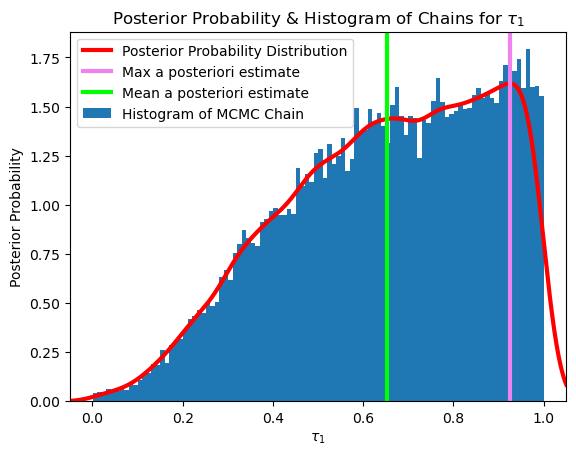

...

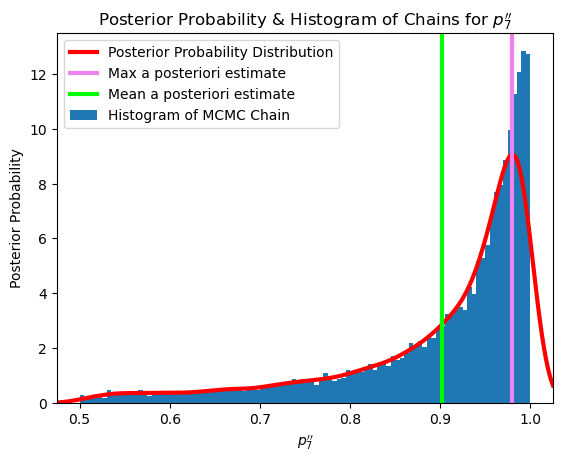

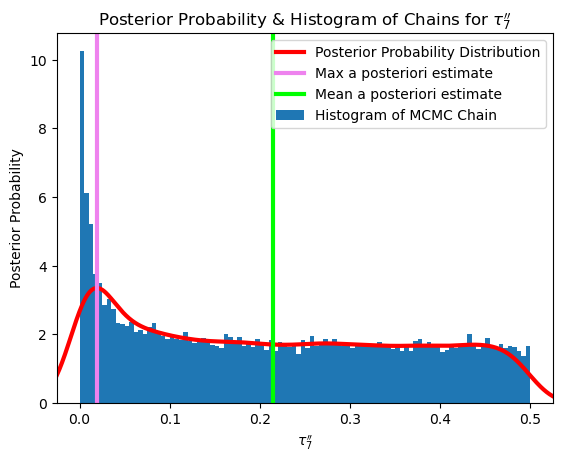

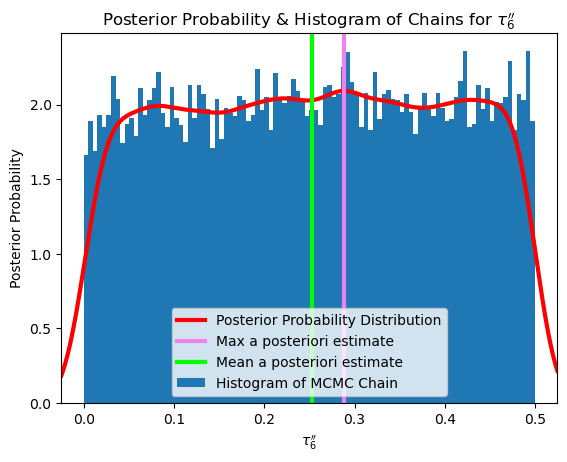

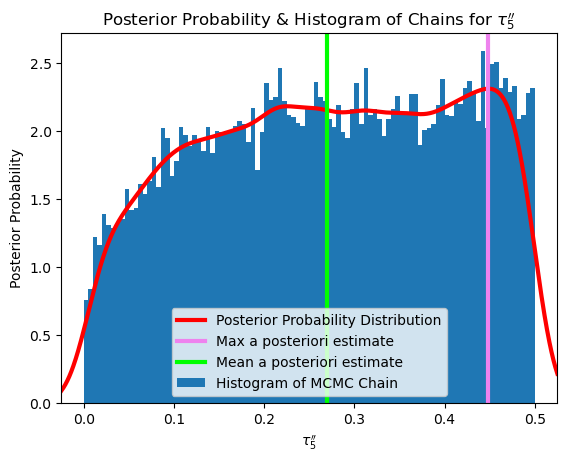

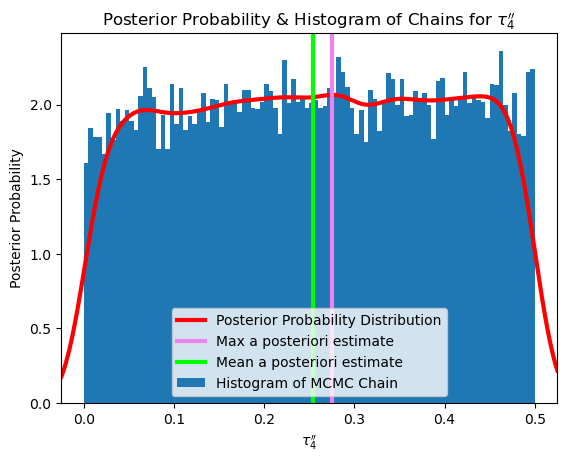

In [70]:
# RUN THIS ONLY IF YOU DO NOT HAVE ALREADY IONSTALLED THE PYMC3 PYTHON PACKAGE
#import sys
#!conda install --yes --prefix {sys.prefix} pymc3

##### Example CREDIBLE INTERVAL 1D #####
#CredibleInterval_50 = pymc3.stats.hpd(MyChain,credible_interval=0.5)### 50% Credible Intervals ###
#CredibleInterval_90 = pymc3.stats.hpd(MyChain,credible_interval=0.9)### 90% Credible Intervals ###
#CredibleInterval_95 = pymc3.stats.hpd(MyChain,credible_interval=0.95)### 95% Credible Intervals ###
#CredibleInterval_99 = pymc3.stats.hpd(MyChain,credible_interval=0.99)### 99% Credible Intervals ###

### 1) Get Chains
AllWavesChains = [ConcatenatedExtractedChains, ConcatenatedExtractedChains_2ndWave, ConcatenatedExtractedChains_3rdWave]
AllWavesNames = [NamesParamsParallelChains, NamesParamsParallelChains_2ndWave, NamesParamsParallelChains_3rdWave]

### Repeat 1st Wave, 2nd Wave

ListOfListsOfMaxs = []
ListOfListsMeans = []
ListOfListsCredibleIntervals50 = []
ListOfListsCredibleIntervals90 = []

for i_Wave in [0,1,2]:

    MyChains = AllWavesChains[i_Wave]
    MyParNames = AllWavesNames[i_Wave]

    ### 2) Get Max and Mean a Posteriori Estimate of each parameter 

    ListOfMaxs = []
    ListOfMeans = []
    ListOfCredibleIntervals50 = []
    ListOfCredibleIntervals90 = []

    for i in np.arange(0,len(MyParNames),1):
        print(i)
        plt.figure(facecolor="white")
        Chains1Par = MyChains[:,i]
        Name1Par = MyParNames[i]

        plt.hist(Chains1Par, density=True, bins=100, label="Histogram of MCMC Chain")

        mn, mx = plt.xlim()
        plt.xlim(mn, mx)
        kde_xs = np.linspace(mn, mx, 1000)
        kde = st.gaussian_kde(Chains1Par)

        plt.plot(kde_xs,kde.pdf(kde_xs),label="Posterior Probability Distribution",linewidth=3,color='red')

        plt.xlabel(Name1Par)
        plt.ylabel('Posterior Probability')
        plt.title("Posterior Probability & Histogram of Chains for " + str(Name1Par))

        posterior=list(kde.pdf(kde_xs))
        a=posterior.index(max(posterior))

        plt.axvline(x=kde_xs[a],linewidth=3,color='violet',label='Max a posteriori estimate')
        plt.axvline(x=statistics.mean(Chains1Par),linewidth=3,color='lime',label='Mean a posteriori estimate')

        plt.legend(loc="best")

        # 2.1) Max a Posteriori Estimate
        MaxEstimate = kde_xs[a]
        print(MaxEstimate)

        # 2.2) Mean a Posteriori Estimate
        MeanEstimate = statistics.mean(Chains1Par)
        print(MeanEstimate)

        # 2.3) 50% Credible Interval
        CredibleInterval_50 = pymc3.stats.hpd(Chains1Par,credible_interval=0.5)
        print(CredibleInterval_50)

        # 2.4) 90% Credible Interval
        CredibleInterval_90 = pymc3.stats.hpd(Chains1Par,credible_interval=0.9)
        print(CredibleInterval_90)

        ListOfMaxs.append(MaxEstimate)
        ListOfMeans.append(MeanEstimate)
        ListOfCredibleIntervals50.append(CredibleInterval_50)
        ListOfCredibleIntervals90.append(CredibleInterval_90)

    ListOfListsOfMaxs.append(ListOfMaxs)
    ListOfListsMeans.append(ListOfMeans)
    ListOfListsCredibleIntervals50.append(ListOfCredibleIntervals50)
    ListOfListsCredibleIntervals90.append(ListOfCredibleIntervals90)


In [74]:
# These are the Manual fits values and the Priors,


Params1stWaveManualAndAutomated = [ListOfRhos[1],ListOfRhos[2],ListOfRhos[3],ListOfRhos[4],
                                  tau1,tau2,tau3,p3,p2,p4,p5,p6,alpha,beta,p7,tau7,tau6,tau5,tau4]
                                   
# Define options
            
Params2ndWaveManualAndAutomated = [ListOfRhos[5],ListOfRhos[6],ListOfRhos[7],ListOfRhos[8],ListOfRhos[9],ListOfRhos[10],
                                  tau3prim, p3prim, p2prim, p4prim, p5prim, p6prim, p7prim, 
                                   tau7prim, tau6prim, tau5prim, tau4prim]

Params3rdWaveManualAndAutomated = [ListOfRhos[11],ListOfRhos[12],ListOfRhos[13],
                                   tau3prim2, p2prim2, p3prim2, p4prim2, p5prim2, p6prim2, p7prim2,
                                   tau7prim2, tau6prim2, tau5prim2, tau4prim2]

ListParamsManualAndAutomated = [Params1stWaveManualAndAutomated,
                                Params2ndWaveManualAndAutomated,
                                Params3rdWaveManualAndAutomated]

ListLow_1stW = np.array([0,0,0,0,0,0,0,0.5,0,0.5,0.5,0.5,0,0.5,0.5,0,0,0,0])
ListLowErr_1stW = ListLow_1stW - ListLow_1stW
ListHigh_1stW = np.array([1,1,1,1,1,1,1,1,0.5,1,1,1,1,2,1,0.5,0.5,0.5,0.5])
ListHighErr_1stW = ListHigh_1stW - ListLow_1stW
Priors_1stW = np.transpose(np.column_stack((ListLowErr_1stW,ListHighErr_1stW)))

ListLow_2ndW = np.array([0,0,0,0,0,0,0,0.5,0,0.5,0.5,0.5,0.5,0,0,0,0])
ListLowErr_2ndW = ListLow_2ndW - ListLow_2ndW
ListHigh_2ndW = np.array([1,1,1,1,1,1,1,1,0.5,1,1,1,1,0.5,0.5,0.5,0.5])
ListHighErr_2ndW = ListHigh_2ndW - ListLow_2ndW
Priors_2ndW = np.transpose(np.column_stack((ListLowErr_2ndW,ListHighErr_2ndW)))
    
ListLow_3rdW = np.array([0,0,0,0,0,0.5,0.5,0.5,0.5,0.5,0,0,0,0]) # 0,0,
ListLowErr_3rdW = ListLow_3rdW - ListLow_3rdW
ListHigh_3rdW = np.array([1,1,1,1,0.5,1,1,1,1,1,0.5,0.5,0.5,0.5]) # 1,1,
ListHighErr_3rdW = ListHigh_3rdW - ListLow_3rdW
Priors_3rdW = np.transpose(np.column_stack((ListLowErr_3rdW,ListHighErr_3rdW)))

ListListsLow = [ListLow_1stW, ListLow_2ndW, ListLow_3rdW]
ListPriors = [Priors_1stW, Priors_2ndW, Priors_3rdW]

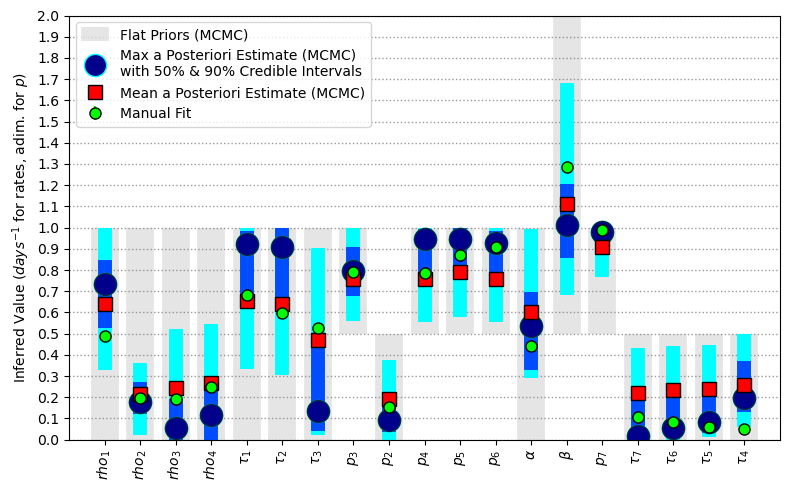

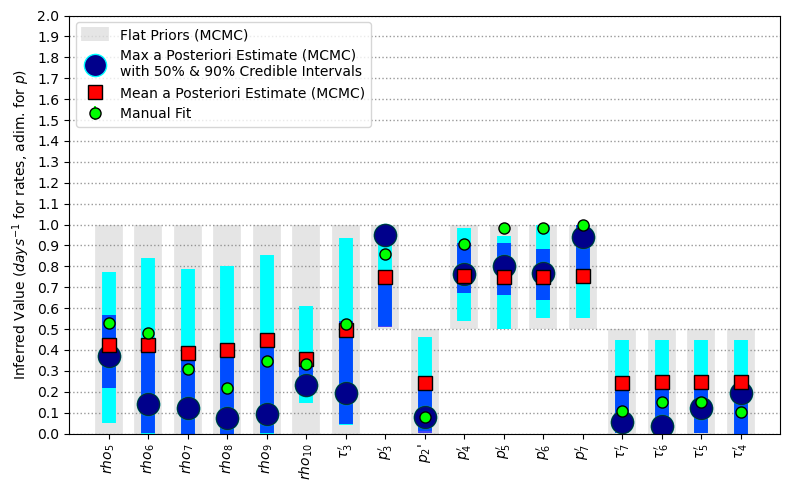

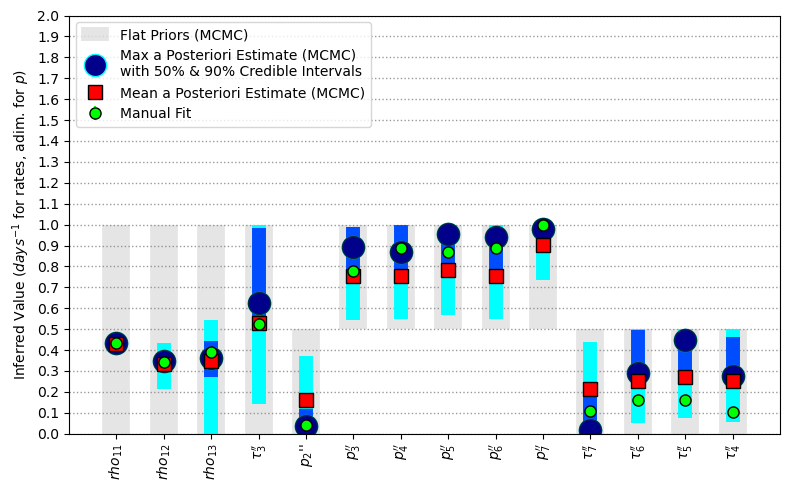

In [88]:
### 6) Plot error / boxplot

def ProduceErrorbarsFromCredibleIntervals(ListOfCredibleIntervals):
    
    TransposedCredInt = np.transpose(np.array(ListOfCredibleIntervals))
    TransposedCredInt_LowerBounds = TransposedCredInt[0,:]
    TransposedCredInt_UpperBounds = TransposedCredInt[1,:]
    ErrMinus = ListOfMaxs - TransposedCredInt_LowerBounds
    ErrPlus = TransposedCredInt_UpperBounds - ListOfMaxs
    errors = np.transpose(np.column_stack((ErrMinus,ErrPlus)))
    
    return errors

# Loop to iterate over waves (1st, 2nd)
for j in [0,1,2]:
    
    ListOfMaxs = ListOfListsOfMaxs[j]
    ListOfMeans = ListOfListsMeans[j]
    ListOfCredibleIntervals50 = ListOfListsCredibleIntervals50[j]
    ListOfCredibleIntervals90 = ListOfListsCredibleIntervals90[j]
    MyParNames = AllWavesNames[j]
    ParamsManualAndAutomated = ListParamsManualAndAutomated[j]
    Priors = ListPriors[j]
    ListLow = ListListsLow[j]

    if j==0:
        WhichWave = '1st' 
    elif j==1:
        WhichWave = '2nd'
    elif j==2:
        WhichWave = '3rd'
        
    x = np.arange(1,len(ListOfMaxs)+1,1)
    y = ListOfMaxs

    errors50 = ProduceErrorbarsFromCredibleIntervals(ListOfCredibleIntervals50)
    errors90 = ProduceErrorbarsFromCredibleIntervals(ListOfCredibleIntervals90)

    plt.figure(figsize=(8, 5),facecolor="white")

    plt.errorbar(x, ListLow, yerr=Priors, fmt = 'o', ms = 0, color = 'gray', elinewidth = 20, alpha = 0.2, label='Flat Priors (MCMC)')
    plt.errorbar(x, y, yerr=errors90, fmt = 'o', ms = 16, markerfacecolor = 'darkblue', color = 'cyan', elinewidth = 10,label='Max a Posteriori Estimate (MCMC)\nwith 50% & 90% Credible Intervals')
    plt.errorbar(x, y, yerr=errors50, fmt = 'o', ms = 16, markerfacecolor = 'darkblue', color = 'blue', elinewidth = 10, alpha = 0.7,markeredgecolor='k')
    plt.errorbar(x, ListOfMeans, yerr=0, fmt = 's', ms=10, color = 'red',label='Mean a Posteriori Estimate (MCMC)',markeredgecolor='k')
    plt.errorbar(x, ParamsManualAndAutomated, yerr=0, fmt = 'o', ms=8, color = 'lime',label='Manual Fit',markeredgecolor='k')

    plt.grid(axis='y', color='gray', linestyle=':', linewidth=1, alpha = 0.8)
    # plt.title('Luxembourg, ' + str(WhichWave) + ' Wave, MCMC Estimate of Paramters')
    plt.legend(loc='upper left')

    plt.xlim(0,len(ListOfMaxs)+1)
    plt.ylim(0,2)

    #plt.xlabel('Parameter')
    plt.ylabel('Inferred Value ($days^{-1}$ for rates, adim. for $p$)')

    plt.xticks(x,MyParNames,rotation=90) 
    plt.yticks(np.arange(0,2.1,0.1)) 

    plt.tight_layout()
    plt.savefig('./Results_Luxembourg/ParallelMCMC_ParameterEstimatesPosteriorsPriors_Wave' + str(j+1) + FileFormatOfFigures)
                
                

In [78]:
def ComputeFoldChange_WithStdError(Chain1ParA,Chain1ParB):
            MeanA = statistics.mean(Chain1ParA) #sum(Chain1ParA)/len(Chain1ParA)
            MeanB = statistics.mean(Chain1ParB) # sum(Chain1ParB)/len(Chain1ParB)
            """            
            print('...I am here...')
            print(MeanA)
            print(MeanB)
            """
            StdDevA = np.std(Chain1ParA)
            StdDevB = np.std(Chain1ParB)
            StandardErrorOfTheMeanA = StdDevA / math.sqrt(len(Chain1ParA))
            StandardErrorOfTheMeanB = StdDevB / math.sqrt(len(Chain1ParB))
            RatioMutOnCtrl = MeanB / MeanA
            MyBase = 2
            if RatioMutOnCtrl != 0:
                FoldChangeCurrentParam = math.log(RatioMutOnCtrl, MyBase)
            else:
                FoldChangeCurrentParam = 0
            Temp1 = StandardErrorOfTheMeanA ** 2 / (MeanA ** 2 * math.log(2) ** 2)
            Temp2 = StandardErrorOfTheMeanB ** 2 / (MeanB ** 2 * math.log(2) ** 2)
            STDDEVofFoldChangeCurrentParam = math.sqrt(Temp1 + Temp2)
            return FoldChangeCurrentParam, STDDEVofFoldChangeCurrentParam
        
def ComputeFoldChange(ValueParam1stWave,ValueParam2ndWave):
            RatioMutOnCtrl = ValueParam2ndWave / ValueParam1stWave
            MyBase = 2
            if RatioMutOnCtrl != 0:
                FoldChangeCurrentParam = math.log(RatioMutOnCtrl, MyBase)
            else:
                FoldChangeCurrentParam = 0
            return FoldChangeCurrentParam

In [79]:
# Indeces indicate the parameters as indicated by commented text above

ListOfIndecesNewOrderFC = [12,3,4,5,6,7,8,16,15,14,13] 
ListOfIndecesNewOrder_2ndWaveFC = [26,19,20,21,22,23,24,30,29,28,27] 
ListOfIndecesNewOrder_3rdWaveFC = [41, 34, 35, 36, 37, 38, 39, 45, 44, 43, 42]

ParametersManualFit_1stWave_forFC = ListOfParametersfirstwave[ListOfIndecesNewOrderFC]
ParametersManualFit_2ndWave_forFC = ListOfParametersfirstwave[ListOfIndecesNewOrder_2ndWaveFC]
ParametersManualFit_3rdWave_forFC = ListOfParametersfirstwave[ListOfIndecesNewOrder_3rdWaveFC]

ListOfFCs_ManualFit_1v2 = []
for k_param in np.arange(0,len(ParametersManualFit_1stWave_forFC),1):
    ValueParam1stWave = ParametersManualFit_1stWave_forFC[k_param]
    ValueParam2ndWave = ParametersManualFit_2ndWave_forFC[k_param]
    FoldChangeCurrentParam = ComputeFoldChange(ValueParam1stWave,ValueParam2ndWave)
    ListOfFCs_ManualFit_1v2.append(FoldChangeCurrentParam)
    
ListOfFCs_ManualFit_2v3 = []
for k_param in np.arange(0,len(ParametersManualFit_1stWave_forFC),1):
    ValueParam2ndWave = ParametersManualFit_2ndWave_forFC[k_param]
    ValueParam3rdWave = ParametersManualFit_3rdWave_forFC[k_param]
    FoldChangeCurrentParam = ComputeFoldChange(ValueParam2ndWave,ValueParam3rdWave)
    ListOfFCs_ManualFit_2v3.append(FoldChangeCurrentParam)

In [80]:
j_ParamForFC_1stW = [6,8,7,9,10,11,14,15,16,17,18] 
ChainsParameters_1stWave_forFC = np.array(AllWavesChains[0])[:,j_ParamForFC_1stW]
NamesParams1stWave = np.array(AllWavesNames[0])[j_ParamForFC_1stW]

j_ParamForFC_2ndW = [6,8,7,9,10,11,12,13,14,15,16]
ChainsParameters_2ndWave_forFC = np.array(AllWavesChains[1])[:,j_ParamForFC_2ndW]
NamesParams2ndWave = np.array(AllWavesNames[1])[j_ParamForFC_2ndW]

j_ParamForFC_3rdW = [3,4,5,6,7,8,9,10,11,12,13]

ChainsParameters_3rdWave_forFC = np.array(AllWavesChains[2])[:,j_ParamForFC_3rdW]
NamesParams3rdWave = np.array(AllWavesNames[2])[j_ParamForFC_3rdW]

ListOfFCs_Means_1v2 = []
ListOfFCs_STDevs_1v2 = []
for k_param in np.arange(0,len(j_ParamForFC_1stW),1):
    Chain1ParA = ChainsParameters_1stWave_forFC[:,k_param]
    Chain1ParB = ChainsParameters_2ndWave_forFC[:,k_param]
    FoldChangeCurrentParam, STDDEVofFoldChangeCurrentParam = ComputeFoldChange_WithStdError(Chain1ParA,Chain1ParB)
    ListOfFCs_Means_1v2.append(FoldChangeCurrentParam)
    ListOfFCs_STDevs_1v2.append(STDDEVofFoldChangeCurrentParam)
    
ListOfFCs_Means_2v3 = []
ListOfFCs_STDevs_2v3 = []
for k_param in np.arange(0,len(j_ParamForFC_1stW),1):
    Chain1ParA = ChainsParameters_2ndWave_forFC[:,k_param]
    Chain1ParB = ChainsParameters_3rdWave_forFC[:,k_param]
    FoldChangeCurrentParam, STDDEVofFoldChangeCurrentParam = ComputeFoldChange_WithStdError(Chain1ParA,Chain1ParB)
    ListOfFCs_Means_2v3.append(FoldChangeCurrentParam)
    ListOfFCs_STDevs_2v3.append(STDDEVofFoldChangeCurrentParam)

In [81]:
ParametersMaxes_1stWave_forFC = np.array(ListOfListsOfMaxs[0])[j_ParamForFC_1stW]
ParametersMaxes_2ndWave_forFC = np.array(ListOfListsOfMaxs[1])[j_ParamForFC_2ndW]
ParametersMaxes_3rdWave_forFC = np.array(ListOfListsOfMaxs[2])[j_ParamForFC_3rdW]

ListOfFCs_MaxEstimate_1v2 = []
for k_param in np.arange(0,len(ParametersMaxes_1stWave_forFC),1):
    ValueParam1stWave = ParametersMaxes_1stWave_forFC[k_param]
    ValueParam2ndWave = ParametersMaxes_2ndWave_forFC[k_param]
    FoldChangeCurrentParam = ComputeFoldChange(ValueParam1stWave,ValueParam2ndWave)
    ListOfFCs_MaxEstimate_1v2.append(FoldChangeCurrentParam)
    
ListOfFCs_MaxEstimate_2v3 = []
for k_param in np.arange(0,len(ParametersMaxes_1stWave_forFC),1):
    ValueParam2ndWave = ParametersMaxes_2ndWave_forFC[k_param]
    ValueParam3rdWave = ParametersMaxes_3rdWave_forFC[k_param]
    FoldChangeCurrentParam = ComputeFoldChange(ValueParam2ndWave,ValueParam3rdWave)
    ListOfFCs_MaxEstimate_2v3.append(FoldChangeCurrentParam)

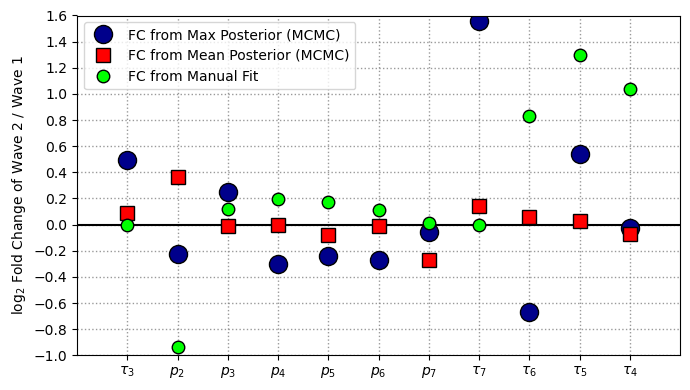

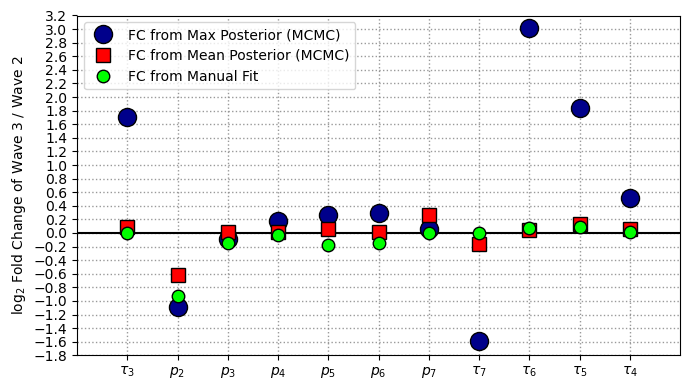

In [86]:
Lists_ListOfFCs_MaxEstimate = [ListOfFCs_MaxEstimate_1v2,ListOfFCs_MaxEstimate_2v3]
Lists_ListOfFCs_Means = [ListOfFCs_Means_1v2,ListOfFCs_Means_2v3]
Lists_ListOfFCs_STDevs = [ListOfFCs_STDevs_1v2,ListOfFCs_STDevs_2v3]
Lists_ListOfFCs_ManualFit = [ListOfFCs_ManualFit_1v2,ListOfFCs_ManualFit_2v3]

for index_Com in [0,1]:

    ListOfFCs_MaxEstimate = Lists_ListOfFCs_MaxEstimate[index_Com]
    ListOfFCs_Means = Lists_ListOfFCs_Means[index_Com]
    ListOfFCs_STDevs = Lists_ListOfFCs_STDevs[index_Com]
    ListOfFCs_ManualFit = Lists_ListOfFCs_ManualFit[index_Com]
    
    plt.figure(figsize=(7, 4),facecolor="white")

    x = np.arange(1,len(NamesParams1stWave)+1,1)

    plt.errorbar(x, ListOfFCs_MaxEstimate, yerr=0, fmt = 'o', ms = 13, markerfacecolor = 'darkblue', color = 'white', elinewidth = 2,label='FC from Max Posterior (MCMC)',markeredgecolor='k')
    plt.errorbar(x, ListOfFCs_Means, yerr=ListOfFCs_STDevs, fmt = 's', ms=10, markerfacecolor = 'red',color='k',label='FC from Mean Posterior (MCMC)',markeredgecolor='k')
    plt.errorbar(x, ListOfFCs_ManualFit, yerr=0, fmt = 'o', ms=9, markerfacecolor = 'lime', color = 'white', label='FC from Manual Fit',markeredgecolor='k')

    #plt.title(r'LUXEMBOURG, $\log_2$ Fold Changes of Parameters from Wave ' + str(index_Com+2) + ' to Wave ' + str(index_Com+1))
    plt.legend(loc='upper left')

    plt.xlim(0,len(NamesParams1stWave)+1)
    plt.yticks(np.arange(-5,4.6,0.2)) 
    if index_Com == 0:
        plt.ylim(-1,1.6)
    elif index_Com == 1:
        plt.ylim(-1.8,3.2)
    plt.grid( color='gray', linestyle=':', linewidth=1, alpha = 0.8)

    plt.axhline(y=0, color='k')

    # plt.xlabel('Parameter')
    plt.ylabel(r'$\log_2$ Fold Change of Wave ' + str(index_Com+2) + ' / Wave ' + str(index_Com+1))

    plt.xticks(x,NamesParams1stWave)#rotation=90) 

    plt.tight_layout()
    plt.savefig('./Results_Luxembourg/Luxembourg_ParallelMCMC_ParameterEstimatesFoldChanges_Waves' + str(index_Com+2) + 'and' + str(index_Com+1) + FileFormatOfFigures)


In [233]:

#############################
######   VACCINATION   ######
#############################


In [234]:
# Some Plotting Variables shared by all Plots

LenghtOfForecast = 136 # This hold for all plots: by how many days you wish to show simulation, after end of data?
endofplot = NumberDaysData + LenghtOfForecast

MyListOfDates = ['24 Feb.']
for Day in np.arange(25,30,1):
    ThisDate = str(Day) + ' Feb.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Mar.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Apr.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Jun.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jul.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Aug.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Sep.'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Oct.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Nov.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Dec.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jan.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,29,1):
    ThisDate = str(Day) + ' Feb.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Mar.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Apr.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Jun.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jul.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Aug.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Sep.'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Oct.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Nov.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Dec.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jan.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' Feb.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Mar.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Apr.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Jun.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jul.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Aug.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Sep.'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Oct.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Nov.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Dec.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jan.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' Feb.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Mar.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Apr.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Jun.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Jul.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Aug.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Sep.'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Oct.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' Nov.'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' Dec.'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' January'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,28,1):
    ThisDate = str(Day) + ' February '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' March '
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' April'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' May'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' June'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' July'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' August'
    MyListOfDates.append(ThisDate)
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' September'
    MyListOfDates.append(ThisDate)    
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' October'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,31,1):
    ThisDate = str(Day) + ' November'
    MyListOfDates.append(ThisDate) 
for Day in np.arange(1,32,1):
    ThisDate = str(Day) + ' December'
    MyListOfDates.append(ThisDate)
    

MyListOfDates=np.array(MyListOfDates)

#only10thindex=np.arange(0,endofplot+1,15)#10)
only10thindex=np.arange(0,endofplot+1,30)#10)
plt.style.use('ggplot')
mpl.rc("figure", facecolor="white")
mpl.style.use('classic')

FileFormatOfFigures = '.pdf' # Could be also '.pdf' or '.png'

In [235]:
def model_SEIRICUHOS_vac(dt,v,t,MyListOfRhos,ListOfParameters):
    
    # 1st Wave

    alpha=ListOfParameters[0] 
    beta=ListOfParameters[1]
    p1=ListOfParameters[2]
    p2=ListOfParameters[3]
    p3=ListOfParameters[4]
    p4=ListOfParameters[5]
    p5=ListOfParameters[6]
    p6=ListOfParameters[7]
    p7=ListOfParameters[8]
    p9=ListOfParameters[9]
    tau1 = ListOfParameters[10]
    tau2 = ListOfParameters[11]
    tau3 = ListOfParameters[12]
    tau4 = ListOfParameters[13]
    
    tau5 = ListOfParameters[14]
    
    tau6 = ListOfParameters[15]
    tau7 = ListOfParameters[16]
    tau8 = ListOfParameters[17]
    tau9 = ListOfParameters[18]
    
    # 2nd Wave

    p2prim=ListOfParameters[19]
    p3prim=ListOfParameters[20]
    p4prim=ListOfParameters[21]
    p5prim=ListOfParameters[22]
    p6prim=ListOfParameters[23]
    p7prim=ListOfParameters[24]
    p9prim=ListOfParameters[25]
    tau3prim=ListOfParameters[26]
    tau4prim=ListOfParameters[27]
    
    tau5prim=ListOfParameters[28]
    tau6prim=ListOfParameters[29]
    
    tau7prim=ListOfParameters[30]
    tau8prim=ListOfParameters[31]
    tau9prim=ListOfParameters[32]
    p1prim=ListOfParameters[33]
    
    # 3rd Wave
    
    p2prim2=ListOfParameters[34]
    p3prim2=ListOfParameters[35]
    p4prim2=ListOfParameters[36]
    p5prim2=ListOfParameters[37]
    p6prim2=ListOfParameters[38]
    p7prim2=ListOfParameters[39]
    p9prim2=ListOfParameters[40]
    tau3prim2=ListOfParameters[41]
    tau4prim2=ListOfParameters[42]
    
    tau5prim2=ListOfParameters[43]
    
    tau6prim2=ListOfParameters[44]
    tau7prim2=ListOfParameters[45]
    tau8prim2=ListOfParameters[46]
    tau9prim2=ListOfParameters[47]
    tvac=ListOfParameters[48]
    
    rho=rhoAsFunctionforLuxembourg([t],ListOfRhos)
    
    y=ODE_system_vac(dt,MyListOfRhos,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,
                 v,t)
    
    return y

In [236]:
#1 wave system
def f(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac, t):
    S,E,R,II,Q,NII,Dihos,H,Hl,ICU,AICU,NI,NI1,R1,D1,DIhome,V = u
    return np.array([(beta*(NII+II)*S*-rho), #S,
            (rho*beta*S*(NII+II) - alpha*E),#E,
            (tau5*Hl*p5+tau6*AICU*p6+p7*tau7*NI),#R
            (alpha*p1*E-tau1*II),#II
            (tau1*II-Q*(1-p2)*tau2-p2*Q*tau2),#Q
            ((1-p1)*alpha*E-NII*tau8),#NII
            ((1-p6)*AICU*tau6+(1-p5)*Hl*tau5+(1-p4)*tau4*ICU),#
            (p2*Q*tau2-p3*H*tau3-(1-p3)*H*tau3),#H
            (p3*H*tau3-p5*Hl*tau5-(1-p5)*Hl*tau5),#Hl
            ( (1-p3)*H*tau3-tau4*ICU*p4-(1-p4)*ICU*tau4),#ICU
            (tau4*ICU*p4-AICU*tau6*p6-AICU*tau6*(1-p6)),#AICU
            (Q*(1-p2)*tau2-tau7*(1-p7)*NI-p7*tau7*NI),#NI
            (NII*tau8-tau9*(1-p9)*NI1-p9*tau9*NI1),#NI1
            (p9*NI1*tau9),#R1
            ((1-p9)*tau9*NI1),#D1
            ((1-p7)*NI*tau7),#
            0
                 ])


In [237]:
#2 wave system
def f1(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,t):
   
    S,E,R,II,Q,NII,Dihos,H,Hl,ICU,AICU,NI,NI1,R1,D1,DIhome,V = u
    return np.array([(beta*(NII+II)*S*-rho), #S,
            (rho*beta*S*(NII+II) - alpha*E),#E,
            (tau5prim*Hl*p5prim+tau6prim*AICU*p6prim+p7prim*tau7prim*NI),#R
            (alpha*p1prim*E-tau1*II),#II
            (tau1*II-Q*(1-p2prim)*tau2-p2prim*Q*tau2),#Q
            ((1-p1prim)*alpha*E-NII*tau8prim),#NII
            ((1-p6prim)*AICU*tau6prim+(1-p5prim)*Hl*tau5prim+(1-p4prim)*tau4prim*ICU),#
            (p2prim*Q*tau2-p3prim*H*tau3prim-(1-p3prim)*H*tau3prim),#H
            (p3prim*H*tau3prim-p5prim*Hl*tau5prim-(1-p5prim)*Hl*tau5prim),#Hl
            ( (1-p3prim)*H*tau3prim-tau4prim*ICU*p4prim-(1-p4prim)*ICU*tau4prim),#ICU
            (tau4prim*ICU*p4prim-AICU*tau6prim*p6prim-AICU*tau6prim*(1-p6prim)),#AICU
            (Q*(1-p2prim)*tau2-tau7prim*(1-p7prim)*NI-p7prim*tau7prim*NI),#NI
            (NII*tau8prim-tau9prim*(1-p9prim)*NI1-p9prim*tau9prim*NI1),#NI1
            (p9prim*NI1*tau9prim),#R1
            ((1-p9prim)*tau9prim*NI1),
            ((1-p7prim)*NI*tau7prim),#
            0
                 ])



In [238]:
def f2(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,t):   
    S,E,R,II,Q,NII,Dihos,H,Hl,ICU,AICU,NI,NI1,R1,D1,DIhome,V = u
    return np.array([(beta*(NII+II)*S*-rho), #S,
            (rho*beta*S*(NII+II) - alpha*E),#E,
            (tau5prim2*Hl*p5prim2+tau6prim2*AICU*p6prim2+p7prim2*tau7prim2*NI),#R
            (alpha*p1prim*E-tau1*II),#II
            (tau1*II-Q*(1-p2prim2)*tau2-p2prim2*Q*tau2),#Q
            ((1-p1prim)*alpha*E-NII*tau8prim2),#NII
            ((1-p6prim2)*AICU*tau6prim2+(1-p5prim2)*Hl*tau5prim2+(1-p4prim2)*tau4prim2*ICU),#
            (p2prim2*Q*tau2-p3prim2*H*tau3prim2-(1-p3prim2)*H*tau3prim2),#H
            (p3prim2*H*tau3prim2-p5prim2*Hl*tau5prim2-(1-p5prim2)*Hl*tau5prim2),#Hl
            ( (1-p3prim2)*H*tau3prim2-tau4prim2*ICU*p4prim2-(1-p4prim2)*ICU*tau4prim2),#ICU
            (tau4prim2*ICU*p4prim2-AICU*tau6prim2*p6prim2-AICU*tau6prim2*(1-p6prim2)),#AICU
            (Q*(1-p2prim2)*tau2-tau7prim2*(1-p7prim2)*NI-p7prim2*tau7prim2*NI),#NI
            (NII*tau8prim2-tau9prim2*(1-p9prim2)*NI1-p9prim2*tau9prim2*NI1),#NI1
            (p9prim2*NI1*tau9prim2),#R1
            ((1-p9prim2)*tau9prim2*NI1),
            ((1-p7prim2)*NI*tau7prim2),#
            0
                 ])



In [239]:
#3 wave system
def f3(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,t):
   
    S,E,R,II,Q,NII,Dihos,H,Hl,ICU,AICU,NI,NI1,R1,D1,DIhome,V = u
    return np.array([(beta*(NII+II)*S*-rho-tvac), #S,
            (rho*beta*S*(NII+II) - alpha*E),#E,
            (tau5prim2*Hl*p5prim2+tau6prim2*AICU*p6prim2+p7prim2*tau7prim2*NI),#R
            (alpha*p1prim*E-tau1*II),#II
            (tau1*II-Q*(1-p2prim2)*tau2-p2prim2*Q*tau2),#Q
            ((1-p1prim)*alpha*E-NII*tau8prim2),#NII
            ((1-p6prim2)*AICU*tau6prim2+(1-p5prim2)*Hl*tau5prim2+(1-p4prim2)*tau4prim2*ICU),#
            (p2prim2*Q*tau2-p3prim2*H*tau3prim2-(1-p3prim2)*H*tau3prim2),#H
            (p3prim2*H*tau3prim2-p5prim2*Hl*tau5prim2-(1-p5prim2)*Hl*tau5prim2),#Hl
            ( (1-p3prim2)*H*tau3prim2-tau4prim2*ICU*p4prim2-(1-p4prim2)*ICU*tau4prim2),#ICU
            (tau4prim2*ICU*p4prim2-AICU*tau6prim2*p6prim2-AICU*tau6prim2*(1-p6prim2)),#AICU
            (Q*(1-p2prim2)*tau2-tau7prim2*(1-p7prim2)*NI-p7prim2*tau7prim2*NI),#NI
            (NII*tau8prim2-tau9prim2*(1-p9prim2)*NI1-p9prim2*tau9prim2*NI1),#NI1
            (p9prim2*NI1*tau9prim2),#R1
            ((1-p9prim2)*tau9prim2*NI1),
            ((1-p7prim2)*NI*tau7prim2),#
            tvac
                 ])




In [240]:
#ODE system for vaccination
def ODE_system_vac(dt,rholist,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,
                   
                   
                   
                   tvac, v,ttt):

    N_t = int(round(float(ttt)/dt))
    print(N_t)
    # Ensure that any list/tuple returned from f_ is wrapped as array
    
    f_ = lambda u, tt, rho: np.asarray(f(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac, tt))
    f1_ = lambda u, tt,rho: np.asarray(f1(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,tt))
    f2_ = lambda u, tt,rho: np.asarray(f2(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,tt))
    f3_ = lambda u, tt,rho: np.asarray(f3(u,rho,alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac,tt))

    U_0= [1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
    u = np.zeros((N_t+1, len(U_0)))
    t = np.linspace(0, N_t*dt, len(u))
    
    RhoVsTimeList = rhoAsFunctionforLuxembourg(t,rholist)
    print(rholist)
    plt.plot(RhoVsTimeList)
    u[0] = U_0
    for n in range(N_t):
        if (n<101/dt):
            u[n+1] = u[n] + dt*f_(u[n], t[n], RhoVsTimeList[n])
        elif (n>=101/dt) and(n<204/dt):
            u[n+1] = u[n] + dt*f1_(u[n], t[n], RhoVsTimeList[n])
        elif (n>=204/dt) and(n<313/dt):
            u[n+1] = u[n] + dt*f2_(u[n], t[n], RhoVsTimeList[n])
        elif (n>=313/dt): 
            if u[n,0]<=0.0001:#0.00001: # 0.000002
                u[n+1] = u[n] + dt*f2_(u[n], t[n], RhoVsTimeList[n])
                if u[n,0] < 0:
                    u[n,0] = 0 
            else:     
                u[n+1] = u[n] + dt*f3_(u[n], t[n], RhoVsTimeList[n])
                if u[n,0] < 0:
                    u[n,0] = 0 
    return u


In [241]:
#6 month to vaccinated the population
tvac=2/365
p1prim=0.4

ListOfParametersfirstwave_vac=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,#p1prim,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac])


In [242]:
#12 month to vaccinated the population


tvac1=1/365
p1prim=0.4 

ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])



In [243]:
#18 month to vaccinated the population


tvac2=1/(365*1.5)
p1prim=0.4

ListOfParametersfirstwave_vac2=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac2])



In [244]:
#no vaccination
tvac3=0

ListOfParametersfirstwave_vac3=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac3])




100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39]


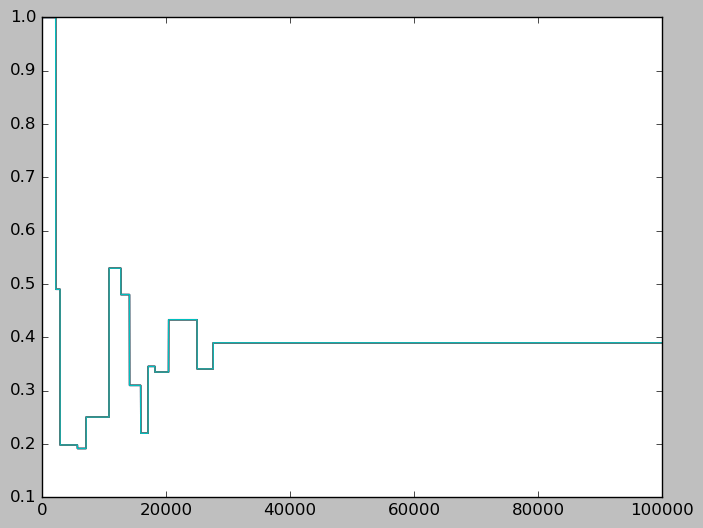

In [245]:
N=623180
P3=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0)

t_max=1000
dt=0.01
ValuesOnlyAtDays = np.arange(0,int(t_max/dt+1),int(1/dt))

resultsseir_vac1=model_SEIRICUHOS_vac(dt,P3,t_max,ListOfRhos,ListOfParametersfirstwave_vac)[ValuesOnlyAtDays]
resultsseir_vac2=model_SEIRICUHOS_vac(dt,P3,t_max,ListOfRhos,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays]
resultsseir_vac3=model_SEIRICUHOS_vac(dt,P3,t_max,ListOfRhos,ListOfParametersfirstwave_vac2)[ValuesOnlyAtDays]
resultsseir_vac4=model_SEIRICUHOS_vac(dt,P3,t_max,ListOfRhos,ListOfParametersfirstwave_vac3)[ValuesOnlyAtDays]


100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4333]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4333]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4333]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4333]


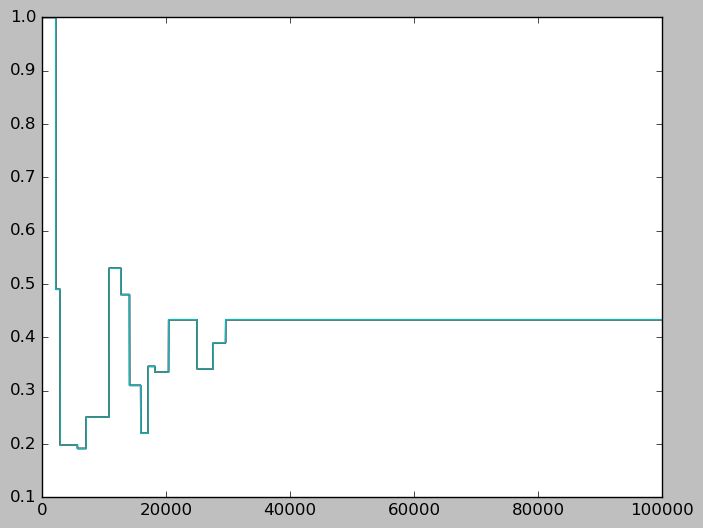

In [246]:
Rho_BestScenario = min(ListOfRhos)
Rho_WorstScenario = ListOfRhos[11] # max(ListOfRhos[1:-1])

List_Rho_BestScenario = list(ListOfRhos) + [Rho_BestScenario]
List_Rho_WorstScenario = list(ListOfRhos) + [Rho_WorstScenario]

resultsseir_vac_Worst=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_WorstScenario,ListOfParametersfirstwave_vac)[ValuesOnlyAtDays]
resultsseir_vac_Worst1=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_WorstScenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays]
resultsseir_vac_Worst2=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_WorstScenario,ListOfParametersfirstwave_vac2)[ValuesOnlyAtDays]
resultsseir_vac_Worst3=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_WorstScenario,ListOfParametersfirstwave_vac3)[ValuesOnlyAtDays]



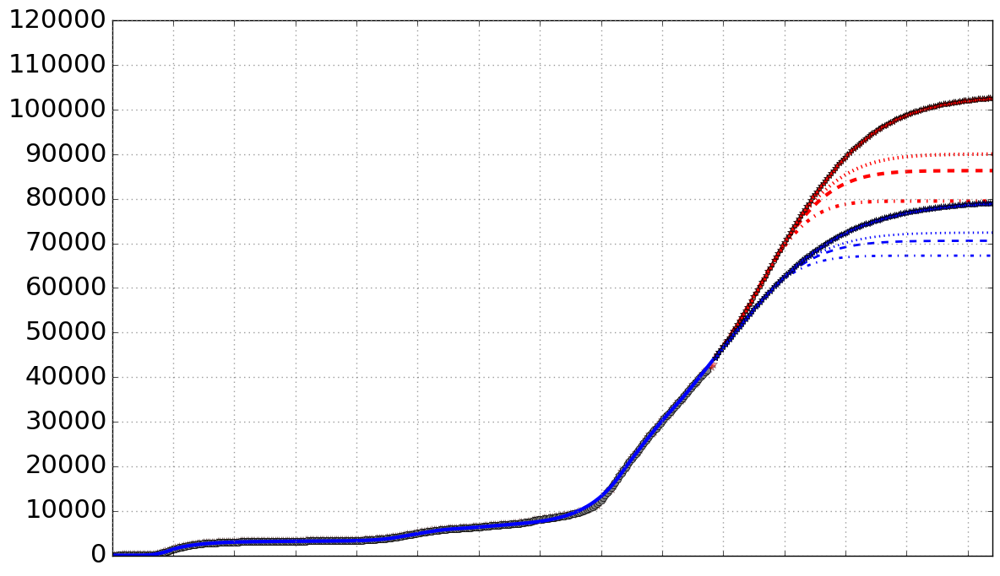

In [256]:
#LenghtOfForecast = 137 # This hold for all plots: by how many days you wish to show simulation, after end of data?
#endofplot = NumberDaysData + LenghtOfForecast

#plot total cases
plt.figure(figsize=(12, 7),facecolor="white")

DI=df['new_cases_cum']
SevenDaysMovingAverage_TotalCases = ComputeSevenDaysMovingAverage(DI)
p =len(SevenDaysMovingAverage_TotalCases)
    
plt.plot(times[0:p],DI,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_TotalCases)-1]),alpha=0.4, markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_TotalCases[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
#plt.plot(t,(resultsseirfit[:,2]+resultsseirfit[:,3]+resultsseirfit[:,4]+resultsseirfit[:,6]+resultsseirfit[:,7]+resultsseirfit[:,8]+resultsseirfit[:,9]+resultsseirfit[:,10]+resultsseirfit[:,11])*N, label="Simulation automated fit", linewidth=2,color='red')
plt.plot(t[0:NumberDaysData],(resultsseir_vac4[:,2]+resultsseir_vac4[:,3]+resultsseir_vac4[:,4]+resultsseir_vac4[:,6]+resultsseir_vac4[:,7]+resultsseir_vac4[:,8]+resultsseir_vac4[:,9]+resultsseir_vac4[:,10]+resultsseir_vac4[:,11]+resultsseir_vac4[:,15])[0:NumberDaysData]*N, label="Simulation, Manual Fit", linewidth=3,color='blue')
#plt.plot(t[0:NumberDaysData],(resultsseir_vac1[:,2]+resultsseir_vac1[:,3]+resultsseir_vac1[:,4]+resultsseir_vac1[:,6]+resultsseir_vac1[:,7]+resultsseir_vac1[:,8]+resultsseir_vac1[:,9]+resultsseir_vac1[:,10]+resultsseir_vac1[:,11]+resultsseir_vac1[:,15])[0:NumberDaysData]*N,'*', label="Simulation, Manual Fit", linewidth=3,color='blue')
#plt.plot(t[0:NumberDaysData],(resultsseir_vac2[:,2]+resultsseir_vac2[:,3]+resultsseir_vac2[:,4]+resultsseir_vac2[:,6]+resultsseir_vac2[:,7]+resultsseir_vac2[:,8]+resultsseir_vac2[:,9]+resultsseir_vac2[:,10]+resultsseir_vac2[:,11]+resultsseir_vac2[:,15])[0:NumberDaysData]*N,':', label="Simulation, Manual Fit", linewidth=3,color='blue')

#Optimistic = resultsseir_vac_Best[:,2]+resultsseir_vac_Best[:,3]+resultsseir_vac_Best[:,4]+resultsseir_vac_Best[:,6]+resultsseir_vac_Best[:,7]+resultsseir_vac_Best[:,8]+resultsseir_vac_Best[:,9]+resultsseir_vac_Best[:,10]+resultsseir_vac_Best[:,11]+resultsseir_vac_Best[:,15]
#Optimistic1 = resultsseir_vac_Best1[:,2]+resultsseir_vac_Best1[:,3]+resultsseir_vac_Best1[:,4]+resultsseir_vac_Best1[:,6]+resultsseir_vac_Best1[:,7]+resultsseir_vac_Best1[:,8]+resultsseir_vac_Best1[:,9]+resultsseir_vac_Best1[:,10]+resultsseir_vac_Best1[:,11]+resultsseir_vac_Best1[:,15]
#Optimistic2 = resultsseir_vac_Best2[:,2]+resultsseir_vac_Best2[:,3]+resultsseir_vac_Best2[:,4]+resultsseir_vac_Best2[:,6]+resultsseir_vac_Best2[:,7]+resultsseir_vac_Best2[:,8]+resultsseir_vac_Best2[:,9]+resultsseir_vac_Best2[:,10]+resultsseir_vac_Best2[:,11]+resultsseir_vac_Best2[:,15]

Pessimistic = resultsseir_vac_Worst[:,2]+resultsseir_vac_Worst[:,3]+resultsseir_vac_Worst[:,4]+resultsseir_vac_Worst[:,6]+resultsseir_vac_Worst[:,7]+resultsseir_vac_Worst[:,8]+resultsseir_vac_Worst[:,9]+resultsseir_vac_Worst[:,10]+resultsseir_vac_Worst[:,11]+resultsseir_vac_Worst[:,15]
Pessimistic1 = resultsseir_vac_Worst1[:,2]+resultsseir_vac_Worst1[:,3]+resultsseir_vac_Worst1[:,4]+resultsseir_vac_Worst1[:,6]+resultsseir_vac_Worst1[:,7]+resultsseir_vac_Worst1[:,8]+resultsseir_vac_Worst1[:,9]+resultsseir_vac_Worst1[:,10]+resultsseir_vac_Worst1[:,11]+resultsseir_vac_Worst1[:,15]
Pessimistic2 = resultsseir_vac_Worst2[:,2]+resultsseir_vac_Worst2[:,3]+resultsseir_vac_Worst2[:,4]+resultsseir_vac_Worst2[:,6]+resultsseir_vac_Worst2[:,7]+resultsseir_vac_Worst2[:,8]+resultsseir_vac_Worst2[:,9]+resultsseir_vac_Worst2[:,10]+resultsseir_vac_Worst2[:,11]++resultsseir_vac_Worst2[:,15]
Pessimistic3 = resultsseir_vac_Worst3[:,2]+resultsseir_vac_Worst3[:,3]+resultsseir_vac_Worst[:,4]+resultsseir_vac_Worst3[:,6]+resultsseir_vac_Worst3[:,7]+resultsseir_vac_Worst3[:,8]+resultsseir_vac_Worst3[:,9]+resultsseir_vac_Worst3[:,10]+resultsseir_vac_Worst3[:,11]++resultsseir_vac_Worst3[:,15]

#plt.plot(t[NumberDaysData:-1],Optimistic[NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown) 1st vaccination strategy", linewidth=3,color='green')
#plt.plot(t[NumberDaysData:-1],Optimistic1[NumberDaysData:-1]*N,'--', label="Optimistic Projection (as lockdown) 2nd vaccination strategy", linewidth=3,color='green')
#plt.plot(t[NumberDaysData:-1],Optimistic2[NumberDaysData:-1]*N,':', label="Optimistic Projection (as lockdown) 3rd vaccination strategy", linewidth=3,color='green')

plt.plot(t[NumberDaysData:-1],Pessimistic[NumberDaysData:-1]*N,'-.', label="Pessimistic Projection (as October) + 1st vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],Pessimistic1[NumberDaysData:-1]*N,'--', label="Pessimistic Projection (as October) + 2nd vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],Pessimistic2[NumberDaysData:-1]*N,':', label="Pessimistic Projection (as October) + 3rd vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],Pessimistic3[NumberDaysData:-1]*N,'*', label="Pessimistic Projection (as October) + no vaccination strategy", linewidth=3,color='red')

plt.plot(t[NumberDaysData:-1],(resultsseir_vac1[:,2]+resultsseir_vac1[:,3]+resultsseir_vac1[:,4]+resultsseir_vac1[:,6]+resultsseir_vac1[:,7]+resultsseir_vac1[:,8]+resultsseir_vac1[:,9]+resultsseir_vac1[:,10]+resultsseir_vac1[:,11]+resultsseir_vac1[:,15])[NumberDaysData:-1]*N,'-.', label="Projection if No Further Change + 1st vaccination strategy", linewidth=2,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac2[:,2]+resultsseir_vac2[:,3]+resultsseir_vac2[:,4]+resultsseir_vac2[:,6]+resultsseir_vac2[:,7]+resultsseir_vac2[:,8]+resultsseir_vac2[:,9]+resultsseir_vac2[:,10]+resultsseir_vac2[:,11]+resultsseir_vac2[:,15])[NumberDaysData:-1]*N,'--', label="Projection if No Further Change + 2nd vaccination strategy", linewidth=2,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac3[:,2]+resultsseir_vac3[:,3]+resultsseir_vac3[:,4]+resultsseir_vac3[:,6]+resultsseir_vac3[:,7]+resultsseir_vac3[:,8]+resultsseir_vac3[:,9]+resultsseir_vac3[:,10]+resultsseir_vac3[:,11]+resultsseir_vac3[:,15])[NumberDaysData:-1]*N,':', label="Projection if No Further Change + 3rd vaccination strategy", linewidth=2,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac4[:,2]+resultsseir_vac4[:,3]+resultsseir_vac4[:,4]+resultsseir_vac4[:,6]+resultsseir_vac4[:,7]+resultsseir_vac4[:,8]+resultsseir_vac4[:,9]+resultsseir_vac4[:,10]+resultsseir_vac4[:,11]+resultsseir_vac4[:,15])[NumberDaysData:-1]*N,'*', label="Projection if No Further Change + no vaccination strategy", linewidth=2,color='blue')

#plt.plot(t[0:NumberDaysData],(resultsseir_vac[:,12]+resultsseir_vac[:,13]+resultsseir_vac[:,14]+resultsseir_vac[:,5])[0:NumberDaysData]*N,'-.', label="Undetected Cases (No change scenario)", linewidth=2,color='magenta',alpha=0.7)

UpperY = 120000#1300000  
#plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90,fontsize=18)
plt.xticks(times[only10thindex],'')

plt.yticks(np.arange(0,UpperY+1,10000),fontsize=22)

#plt.legend(loc='upper left')
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Total Detected Cases",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY)
#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.tight_layout()

plt.savefig('./Results_Luxembourg/TotalCases_vac_SEIR-ICU_LUXEMBOURG'+ FileFormatOfFigures)


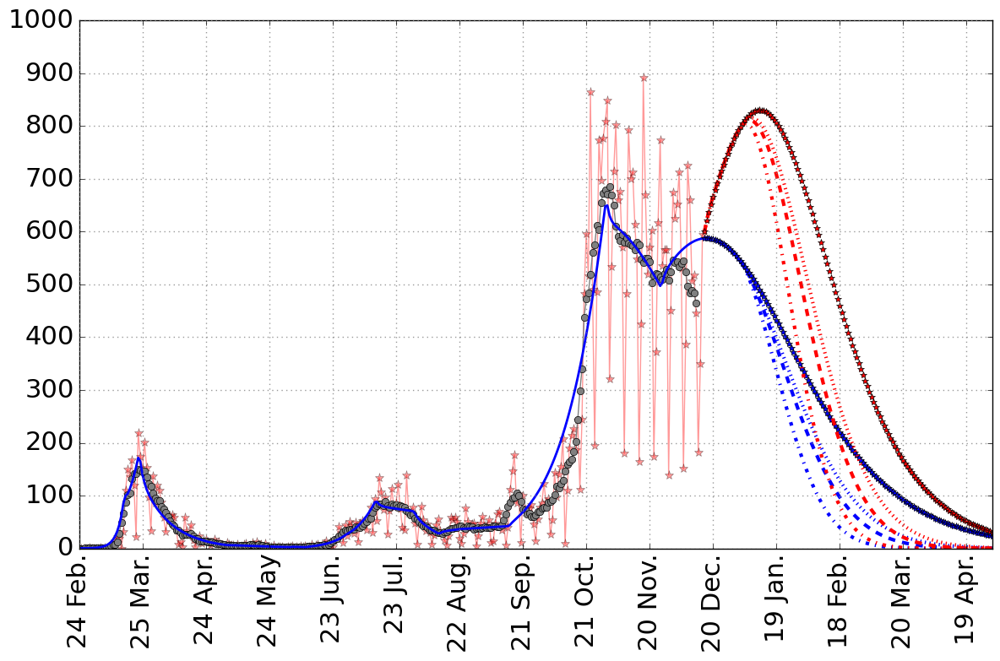

In [257]:
#plot daily new cases
plt.figure(figsize=(12,8),facecolor="white")

DI1=df['new_cases']
SevenDaysMovingAverage_DailyCases = ComputeSevenDaysMovingAverage(DI1)
p =len(SevenDaysMovingAverage_DailyCases)
    
plt.plot(times[0:p],DI1,'-*',color='red',label='Data until '+str(MyListOfDates[len(SevenDaysMovingAverage_DailyCases)-1]),alpha=0.4,markersize=8)
plt.plot(times[0:p-3],SevenDaysMovingAverage_DailyCases[0:-3],'-o',color='grey',label='7-Days Moving Average of Data')
yoo=(resultsseir_vac4[:,2]+resultsseir_vac4[:,3]+resultsseir_vac4[:,4]+resultsseir_vac4[:,6]+resultsseir_vac4[:,7]+resultsseir_vac4[:,8]+resultsseir_vac4[:,9]+resultsseir_vac4[:,10]+resultsseir_vac4[:,11]+resultsseir_vac4[:,15])*N

pp=len(yoo)

yuu=np.zeros(1001)
for ii in range(0,1000):
    yuu[ii]= yoo[ii+1]-yoo[ii]
plt.plot(t[0:NumberDaysData],yuu[0:NumberDaysData],label="Simulation, Manual Fit", linewidth=2,color='blue')


Optimistic4=(resultsseir_vac4[:,2]+resultsseir_vac4[:,3]+resultsseir_vac4[:,4]+resultsseir_vac4[:,6]+resultsseir_vac4[:,7]+resultsseir_vac4[:,8]+resultsseir_vac4[:,9]+resultsseir_vac4[:,10]+resultsseir_vac4[:,11]+resultsseir_vac4[:,15])
Optimistic1=(resultsseir_vac1[:,2]+resultsseir_vac1[:,3]+resultsseir_vac1[:,4]+resultsseir_vac1[:,6]+resultsseir_vac1[:,7]+resultsseir_vac1[:,8]+resultsseir_vac1[:,9]+resultsseir_vac1[:,10]+resultsseir_vac1[:,11]+resultsseir_vac1[:,15])
Optimistic2=(resultsseir_vac2[:,2]+resultsseir_vac2[:,3]+resultsseir_vac2[:,4]+resultsseir_vac2[:,6]+resultsseir_vac2[:,7]+resultsseir_vac2[:,8]+resultsseir_vac2[:,9]+resultsseir_vac2[:,10]+resultsseir_vac2[:,11]+resultsseir_vac2[:,15])
Optimistic3=(resultsseir_vac3[:,2]+resultsseir_vac3[:,3]+resultsseir_vac3[:,4]+resultsseir_vac3[:,6]+resultsseir_vac3[:,7]+resultsseir_vac3[:,8]+resultsseir_vac3[:,9]+resultsseir_vac3[:,10]+resultsseir_vac3[:,11]+resultsseir_vac3[:,15])



yooOptimistic4 = Optimistic4*N
yooOptimistic1 = Optimistic1*N
yooOptimistic2 = Optimistic2*N
yooOptimistic3 = Optimistic3*N


yuuOptimistic4=np.zeros(1001)
yuuOptimistic1=np.zeros(1001)
yuuOptimistic2=np.zeros(1001)
yuuOptimistic3=np.zeros(1001)
for ii in range(0,1000):
    yuuOptimistic4[ii]= yooOptimistic4[ii+1]-yooOptimistic4[ii]
    yuuOptimistic1[ii]= yooOptimistic1[ii+1]-yooOptimistic1[ii]
    yuuOptimistic2[ii]= yooOptimistic2[ii+1]-yooOptimistic2[ii]
    yuuOptimistic3[ii]= yooOptimistic3[ii+1]-yooOptimistic3[ii]
plt.plot(t[NumberDaysData:-1],yuuOptimistic1[NumberDaysData:-1],'-.', label="Optimistic Projection (as October) + 6 months vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],yuuOptimistic2[NumberDaysData:-1],'--', label="Optimistic Projection (as October) + 1 year vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],yuuOptimistic3[NumberDaysData:-1],':', label="Optimistic Projection (as October) + 1.5 years vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],yuuOptimistic4[NumberDaysData:-1],'*', label="Optimistic Projection (as October) + no vaccination", linewidth=3,color='blue')

Pessimistic = resultsseir_vac_Worst[:,2]+resultsseir_vac_Worst[:,3]+resultsseir_vac_Worst[:,4]+resultsseir_vac_Worst[:,6]+resultsseir_vac_Worst[:,7]+resultsseir_vac_Worst[:,8]+resultsseir_vac_Worst[:,9]+resultsseir_vac_Worst[:,10]+resultsseir_vac_Worst[:,11]+resultsseir_vac_Worst[:,15]
Pessimistic1 = resultsseir_vac_Worst1[:,2]+resultsseir_vac_Worst1[:,3]+resultsseir_vac_Worst1[:,4]+resultsseir_vac_Worst1[:,6]+resultsseir_vac_Worst1[:,7]+resultsseir_vac_Worst1[:,8]+resultsseir_vac_Worst1[:,9]+resultsseir_vac_Worst1[:,10]+resultsseir_vac_Worst1[:,11]+resultsseir_vac_Worst1[:,15]
Pessimistic2 = resultsseir_vac_Worst2[:,2]+resultsseir_vac_Worst2[:,3]+resultsseir_vac_Worst2[:,4]+resultsseir_vac_Worst2[:,6]+resultsseir_vac_Worst2[:,7]+resultsseir_vac_Worst2[:,8]+resultsseir_vac_Worst2[:,9]+resultsseir_vac_Worst2[:,10]+resultsseir_vac_Worst2[:,11]+resultsseir_vac_Worst2[:,15]
Pessimistic3 = resultsseir_vac_Worst3[:,2]+resultsseir_vac_Worst3[:,3]+resultsseir_vac_Worst3[:,4]+resultsseir_vac_Worst3[:,6]+resultsseir_vac_Worst3[:,7]+resultsseir_vac_Worst3[:,8]+resultsseir_vac_Worst3[:,9]+resultsseir_vac_Worst3[:,10]+resultsseir_vac_Worst3[:,11]+resultsseir_vac_Worst3[:,15]

yooPessimistic = Pessimistic*N
yooPessimistic1 = Pessimistic1*N
yooPessimistic2 = Pessimistic2*N
yooPessimistic3 = Pessimistic3*N

    
yuuPessimistic=np.zeros(1001)
yuuPessimistic1=np.zeros(1001)
yuuPessimistic2=np.zeros(1001)
yuuPessimistic3=np.zeros(1001)
for ii in range(0,1000):
    yuuPessimistic[ii]= yooPessimistic[ii+1]-yooPessimistic[ii]
    yuuPessimistic1[ii]= yooPessimistic1[ii+1]-yooPessimistic1[ii]
    yuuPessimistic2[ii]= yooPessimistic2[ii+1]-yooPessimistic2[ii]
    yuuPessimistic3[ii]= yooPessimistic3[ii+1]-yooPessimistic3[ii]
plt.plot(t[NumberDaysData:-1],yuuPessimistic[NumberDaysData:-1],'-.', label="Pessimistic Projection (as October) + 6 months vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],yuuPessimistic1[NumberDaysData:-1],'--', label="Pessimistic Projection (as October) + 1 year vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],yuuPessimistic2[NumberDaysData:-1],':', label="Pessimistic Projection (as October) + 1.5 years vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],yuuPessimistic3[NumberDaysData:-1],'*', label="Pessimistic Projection (as October) + no vaccination", linewidth=3,color='red')


#plt.plot(np.arange(0,1001,1)[0:pp+1],yuu,'--', label="Projection if No Further Change", linewidth=3)

UpperY1 = 1000
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], fontsize=22, rotation=90)
#plt.xticks(times[only10thindex], '')
plt.yticks(np.arange(0,UpperY1+1,100),fontsize=22)

#plt.title("Sweden")

#plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Daily New Detected Cases",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY1)

plt.tight_layout()
plt.savefig('./Results_Luxembourg/DailyNewCases_vac_SEIR-ICU_Luxembourg' + FileFormatOfFigures)


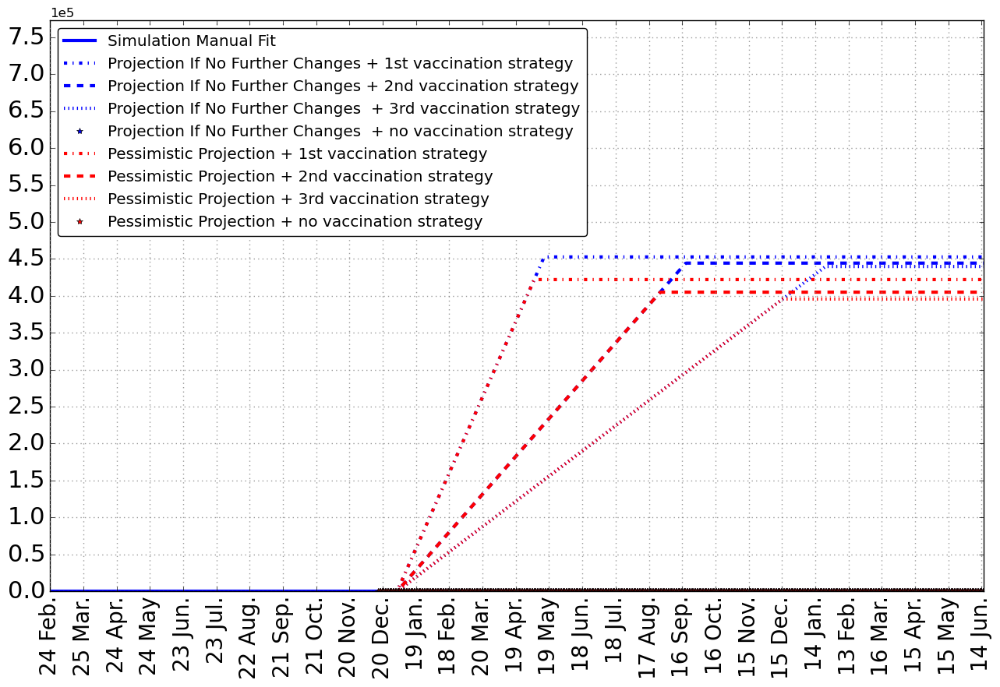

In [250]:
LengthOfForecast=546
endofplot=NumberDaysData+LengthOfForecast
#only10thindex=np.arange(0,endofplot+1,15)
only10thindex=np.arange(0,endofplot+1,30)

times=np.arange(0,endofplot+1,1)

#plot vaccination 
plt.figure(figsize=(13, 9),facecolor="white")

plt.plot(t[0:NumberDaysData],(resultsseir_vac4[:,16])[0:NumberDaysData]*N, label="Simulation Manual Fit", linewidth=3,color='blue')

plt.plot(t[NumberDaysData:-1],(resultsseir_vac1[:,16])[NumberDaysData:-1]*N, '-.',label="Projection If No Further Changes + 1st vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac2[:,16])[NumberDaysData:-1]*N,'--', label="Projection If No Further Changes + 2nd vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac3[:,16])[NumberDaysData:-1]*N,':', label="Projection If No Further Changes  + 3rd vaccination strategy", linewidth=3,color='blue')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac4[:,16])[NumberDaysData:-1]*N,'*', label="Projection If No Further Changes  + no vaccination strategy", linewidth=3,color='blue')

#plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Best[:,16])[NumberDaysData:-1]*N,'-.', label="Optimistic Projection (as lockdown) 1st vaccination strategy", linewidth=3,color='green')
#plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Best1[:,16])[NumberDaysData:-1]*N,'--', label="Optimistic Projection (as lockdown) 2nd vaccination strategy", linewidth=3,color='green')
#plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Best2[:,16])[NumberDaysData:-1]*N,':', label="Optimistic Projection (as lockdown) 3rd vaccination strategy", linewidth=3,color='green')

plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Worst[:,16])[NumberDaysData:-1]*N,'-.', label="Pessimistic Projection + 1st vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Worst1[:,16])[NumberDaysData:-1]*N,'--', label="Pessimistic Projection + 2nd vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Worst2[:,16])[NumberDaysData:-1]*N,':', label="Pessimistic Projection + 3rd vaccination strategy", linewidth=3,color='red')
plt.plot(t[NumberDaysData:-1],(resultsseir_vac_Worst3[:,16])[NumberDaysData:-1]*N,'*', label="Pessimistic Projection + no vaccination strategy", linewidth=3,color='red')

#plt.plot(t,(resultsseir_vac[:,16])*N,'--', label="Projection if No Further Change except vaccination", linewidth=3,color='cyan')
#plt.plot(t,(resultsseir[:,0])*N,'--', label="Projection if No Further Change", linewidth=3,color='blue')

UpperY3 = N+150000
plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90,fontsize=20)
plt.yticks(np.arange(0,UpperY3+1,50000),fontsize=22)
#plt.title("Austria")

plt.legend(loc='upper left', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel("Time")
#plt.ylabel("Vaccinated People",size=12)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)

plt.ticklabel_format(axis='y', style='sci', scilimits=(5,5))

plt.tight_layout()

plt.savefig('./Results_Luxembourg/Vaccinated_vac_SEIR-ICU_LUXEMBOURG' + FileFormatOfFigures)
#plt.xlabel("Time")


In [251]:
cases_sim=(resultsseir_vac1[:,0])*N
cases_sim1=(resultsseir_vac2[:,0])*N
cases_sim2=(resultsseir_vac3[:,0])*N
cases_sim3=(resultsseir_vac4[:,0])*N
#cases_sim_Optimistic=(resultsseir_vac_Best[:,0])*N
#cases_sim_Optimistic1=(resultsseir_vac_Best1[:,0])*N
#cases_sim_Optimistic2=(resultsseir_vac_Best2[:,0])*N
cases_sim_Pessimistic=(resultsseir_vac_Worst[:,0])*N
cases_sim_Pessimistic1=(resultsseir_vac_Worst1[:,0])*N
cases_sim_Pessimistic2=(resultsseir_vac_Worst2[:,0])*N
cases_sim_Pessimistic3=(resultsseir_vac_Worst3[:,0])*N


In [252]:
LenghtOfForecast = 136 # 60 # This hold for all plots: by how many days you wish to show simulation, after end of data?
endofplot = NumberDaysData + LenghtOfForecast
#only10thindex=np.arange(0,endofplot+1,15)
only10thindex=np.arange(0,endofplot+1,30)
times=np.arange(0,endofplot+1,1)


In [253]:
#Reff under vacination 
def R_eff(MyTimes,My_cases_sim,ListOfRhos):
    RhosList = rhoAsFunctionforLuxembourg(MyTimes,ListOfRhos)
    R_eff=np.zeros(len(MyTimes))
    for i in range(0, len(MyTimes)):
        rho = RhosList[i]
        R_eff[i]= beta*rho*((1-p1)*1/tau8+p1/tau1)*(My_cases_sim[i])/N
    return R_eff


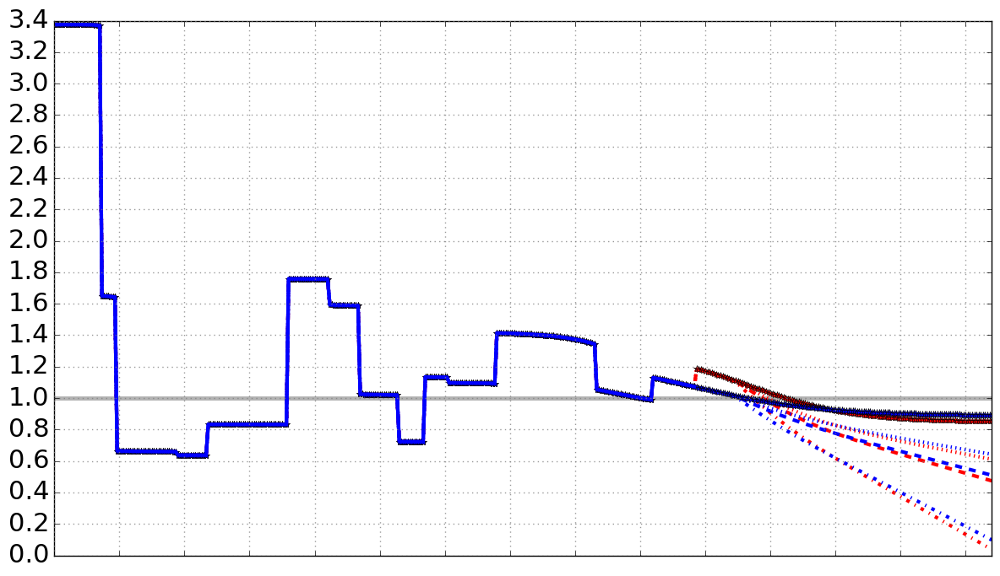

In [254]:
plt.style.use('ggplot')
mpl.rc("figure", facecolor="white")
mpl.style.use('classic')

FileFormatOfFigures = '.pdf' # Could be also '.pdf'


plt.figure(figsize=(12, 7),facecolor="white")
Reff = R_eff(times, cases_sim, ListOfRhos)
Reff1 = R_eff(times, cases_sim1, ListOfRhos)
Reff2 = R_eff(times, cases_sim2, ListOfRhos)
Reff3 = R_eff(times, cases_sim3, ListOfRhos)

#Reff_Opt = R_eff(times, cases_sim_Optimistic, List_Rho_BestScenario)
#Reff_Opt1 = R_eff(times, cases_sim_Optimistic1, List_Rho_BestScenario)
#Reff_Opt2 = R_eff(times, cases_sim_Optimistic2, List_Rho_BestScenario)

Reff_Pess = R_eff(times, cases_sim_Pessimistic, List_Rho_WorstScenario)
Reff_Pess1 = R_eff(times, cases_sim_Pessimistic1, List_Rho_WorstScenario)
Reff_Pess2 = R_eff(times, cases_sim_Pessimistic2, List_Rho_WorstScenario)
Reff_Pess3 = R_eff(times, cases_sim_Pessimistic3, List_Rho_WorstScenario)

plt.axhline(y=1,color='gray',linewidth=3.5, alpha = 0.6)

plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-', label="Simulation Manual Fit", linewidth=3,color='blue')
#plt.plot(times,Reff_Opt,'-.', label="Optimistic Projection (as lockdown) 1st vaccination strategy", linewidth=3,color='green')
#plt.plot(times,Reff_Opt1,'*', label="Optimistic Projection (as lockdown) 2nd vaccination strategy", linewidth=3,color='green')
#plt.plot(times,Reff_Opt2,':', label="Optimistic Projection (as lockdown) 3rd vaccination strategy", linewidth=3,color='green')

plt.plot(times,Reff_Pess,'-.', label="Pessimistic Projection (as October) + 1st vaccination strategy", linewidth=3,color='red')
plt.plot(times,Reff_Pess1,'--', label="Pessimistic Projection (as October) + 2nd vaccination strategy", linewidth=3,color='red')
plt.plot(times,Reff_Pess2,':', label="Pessimistic Projection (as October) + 3rd vaccination strategy", linewidth=3,color='red')
plt.plot(times,Reff_Pess3,'*', label="Pessimistic Projection (as October) + no vaccination strategy", linewidth=3,color='red')

#plt.plot(times,Reff,'--', label="Projection if No Further Change", linewidth=3,color='blue')

plt.plot(times,Reff,'-.', label="Projection if No Further Change + 1st vaccination strategy", linewidth=3,color='blue')
plt.plot(times,Reff1,'--', label="Projection if No Further Change + 2nd vaccination strategy", linewidth=3,color='blue')
plt.plot(times,Reff2,':', label="Projection if No Further Change + 3rd vaccination strategy", linewidth=3,color='blue')
plt.plot(times,Reff3,'*', label="Projection if No Further Change + no vaccination strategy", linewidth=3,color='blue')

plt.plot(times[0:NumberDaysData],Reff[0:NumberDaysData], '-',linewidth=3,color='blue')

UpperY3 = 3.4

#plt.xticks(times[only10thindex], MyListOfDates[only10thindex], rotation=90,fontsize=18)
plt.xticks(times[only10thindex],'')


plt.yticks(np.arange(0,UpperY3+1,0.2),fontsize=22)

#plt.title('Austria')

#plt.legend(loc='upper right', fancybox=True, numpoints=1)
plt.grid(color='gray', linestyle=':', linewidth=1, alpha = 0.8)

#plt.xlabel(“Time”)18
#plt.ylabel(r'$R_{eff}(t)$',size=18)

plt.xlim(0,endofplot)
plt.ylim(0,UpperY3)



plt.tight_layout()
plt.savefig('./Results_Luxembourg/R_eff_vac_Luxembourg' + FileFormatOfFigures)


In [255]:

#################################################################################################
### NOW WE INVESTIGATE SYSTEMATICALLY THE EFFECT OF COMBINATIONS OF RHO and TAU_VAC ON S(t),  ###
### i.e. what oit takes to get to herd immunity or when we might get there                    ###
#################################################################################################


100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35]


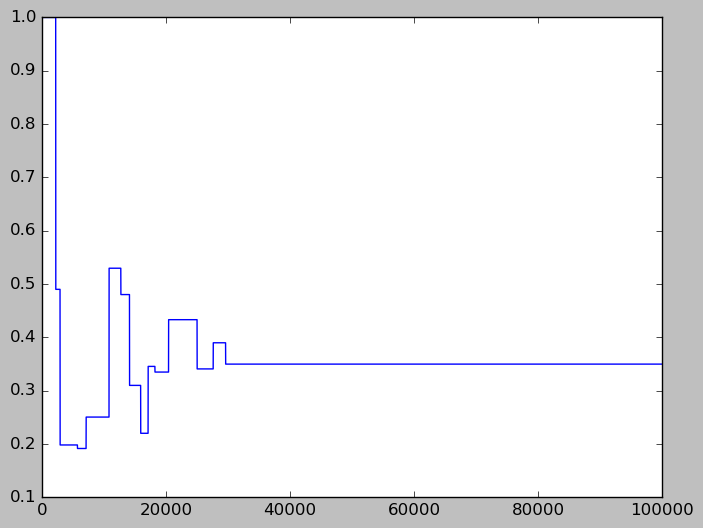

In [188]:
tvac1=1/365

ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])
List_Rho_Scenario = list(ListOfRhos) + [0.35]
    
resultsseir_vac5=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_Scenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays]


In [174]:
# Auxiliary function to compute S(rho,tau_vac)|April

def Auxiliary_f_Compute_S(x,y):
    tvac1=y

    ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])
    List_Rho_Scenario = list(ListOfRhos) + [x]
    
    resultsseir_vac5=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_Scenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays]
    # odeint(model_SEIRICUHOS_vac,P3,t,(List_Rho_Scenario,ListOfParametersfirstwave_vac1))    
    return resultsseir_vac5[endofplot,0]*100


100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.0]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.0]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.0]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.310

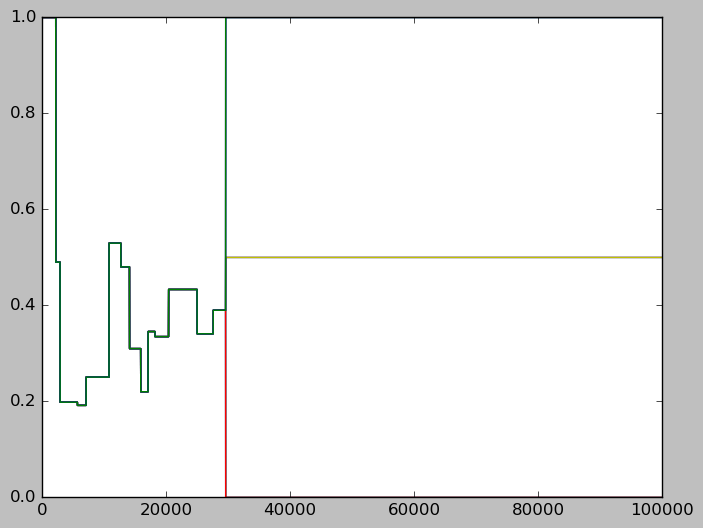

In [175]:
Min_rho = 0
Max_rho = 1
HowManyRhos = 3 # 21

Min_tvac = 0
Max_tvac = 0.01 # 0.0111 
HowManyTvacs = 3 # 21

#List_rho=np.linspace(0,1,11)
List_rho=np.linspace(Min_rho,Max_rho,HowManyRhos)
#List_tvac = np.linspace(0,0.0111,10)
List_tvac = np.linspace(Min_tvac,Max_tvac,HowManyTvacs)

MyArray = np.zeros(HowManyRhos*HowManyTvacs).reshape(HowManyRhos,HowManyTvacs)

X,Y = np.meshgrid(List_tvac,List_rho)

i=0
for rho in List_rho:
    j=0
    for tvac in List_tvac:
        #rho=List_rho[i]
        #tvac=List_tvac[j]
        MyArray[i,j]=Auxiliary_f_Compute_S(rho,tvac)
        #print(i)
        #print(j)
        #print()
        j=j+1
    i=i+1
print(np.shape(MyArray))


/Users/stefano.magni/anaconda/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: The following kwargs were not used by contour: 'label'
  if __name__ == '__main__':


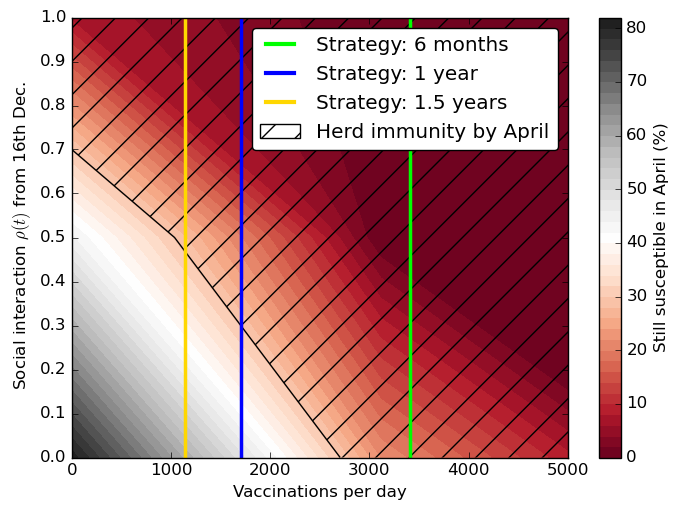

In [176]:
plt.figure(figsize=(8, 5.5),facecolor="white")
plt.contourf(X*N,Y, MyArray,40, cmap='RdGy')
#print(np.size(X))
cbar=plt.colorbar()
cbar.set_label('Still susceptible in April (%)', rotation=90)
n_levels=[0,(1-0.7041)*100]
plt.contour(X*N,Y, MyArray, n_levels, colors='black', linestyles='-')
cs=plt.contourf(X*N,Y, MyArray, n_levels, colors='none',
                  hatches=[ '/',None],label='herd immunity by April'
            )
artists, labels = cs.legend_elements()
My_patch = mpatches.Patch(fill=False,hatch='/')
from matplotlib.lines import Line2D
colors = ['lime', 'blue', 'gold']
lines = [Line2D([0], [0], color=c, linewidth=3, linestyle='-') for c in colors]
lines.append(My_patch)
labels = ['Strategy: 6 months', 'Strategy: 1 year', 'Strategy: 1.5 years','Herd immunity by April']

#plt.plot(N/365,ListOfRhos[-1],marker='o')
#plt.plot(N/365,ListOfRhos[-1],marker='o')
plt.axvline(x=N/(365*0.5),label='Strategy: 6 months',color='lime',linewidth=2.5)
plt.axvline(x=N/365,label='Strategy: 1 year',color='blue',linewidth=2.5)
plt.axvline(x=N/(365*1.5),label='Strategy: 1.5 years',color='gold',linewidth=2.5)
plt.xlabel('Vaccinations per day')
plt.ylabel(r' Social interaction $\rho(t)$ from 16th Dec.')

plt.xlim(0,5000)# 6000) # 6900)
plt.yticks(np.arange(0,1.1,0.1))
plt.legend(lines, labels,fancybox=True)

plt.savefig('./Results_Luxembourg/HerdImmunityByApril_rho_tvac_Luxembourg' + FileFormatOfFigures)
plt.show()


In [49]:
np.amin(MyArray)

0.0006

In [45]:

##################################################################################################
### NOW WE EVALUATE SYSTEMATICALLY THE WHEN WE'LL REACH HERD IMMUNITY BASED ON RHO and TAU_VAC ###
##################################################################################################


In [46]:
MyTestArray = np.array([0,1,2,3,4,5,6,7,8,9])
MyTestArrayBiggerThan = MyTestArray>6
MyTestArrayBiggerThan

array([False, False, False, False, False, False, False,  True,  True,
        True])

100000
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35]


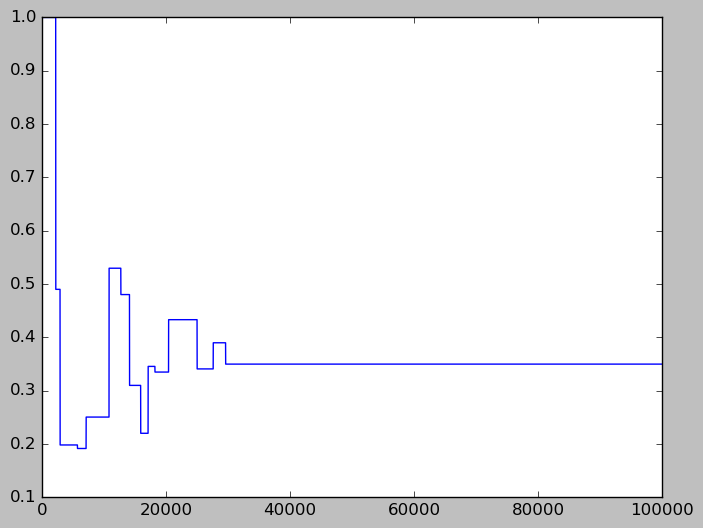

In [47]:
tvac1=1/365

ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])
List_Rho_Scenario = list(ListOfRhos) + [0.35]
    
resultsseir_vac5=model_SEIRICUHOS_vac(dt,P3,t_max,List_Rho_Scenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays]


67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35]


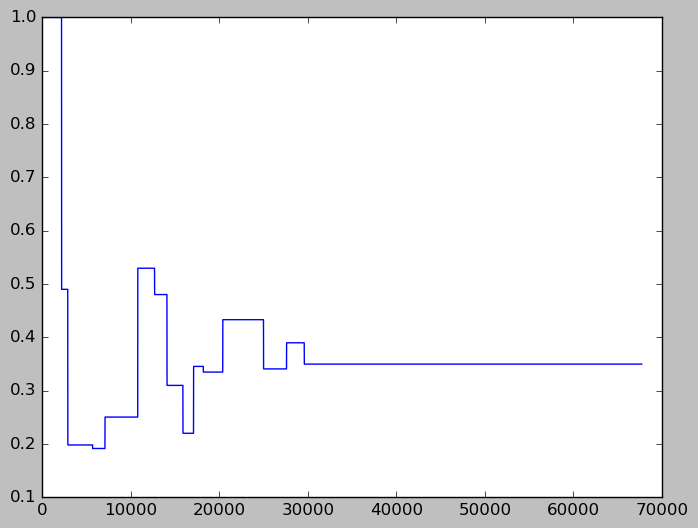

In [48]:
tvac1=1/365
ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9, # p1prim,
               p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])
List_Rho_Scenario = list(ListOfRhos) + [0.35]
          
IndexOfJanuary1st = np.where(MyListOfDates=='1 January')[0][0] # January 1st = 315 for Lux
    #print(IndexOfJanuary1st)
    #Times2years = np.arange(0,IndexOfJanuary1st + 1*365, 1)
Time2years = IndexOfJanuary1st + 1*365
    
resultsseir_vac5=model_SEIRICUHOS_vac(dt,P3,Time2years,List_Rho_Scenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays[0:Time2years]]
    #resultsseir_vac5=odeint(model_SEIRICUHOS_vac,P3,Times2years,(List_Rho_Scenario,ListOfParametersfirstwave_vac1))  


In [49]:
# Auxiliary function to compute S(rho,tau_vac)|April

def f_HerdImm_Time(x,y):
    tvac1=y
    ListOfParametersfirstwave_vac1=np.array([alpha, beta, 
               p1, p2,p3,p4,p5,p6,p7,p9,
               tau1,tau2,tau3,tau4,tau5,tau6,tau7,tau8,tau9,
                p2prim,p3prim,p4prim,p5prim,p6prim,p7prim,p9prim,
               tau3prim,tau4prim,tau5prim,tau6prim,
                                     tau7prim,tau8prim,tau9prim,p1prim,
                                   p2prim2,p3prim2,p4prim2,p5prim2,p6prim2,p7prim2,p9prim2,
               tau3prim2,tau4prim2,tau5prim2,tau6prim2,
                                     tau7prim2,tau8prim2,tau9prim2,tvac1])
    List_Rho_Scenario = list(ListOfRhos) + [x]
          
    IndexOfJanuary1st = np.where(MyListOfDates=='1 January')[0][0] # January 1st = 315 for Lux
    print(IndexOfJanuary1st)
    #Times2years = np.arange(0,IndexOfJanuary1st + 1*365, 1)
    Time2years = IndexOfJanuary1st + 1*365
    
    resultsseir_vac5=model_SEIRICUHOS_vac(dt,P3,Time2years,List_Rho_Scenario,ListOfParametersfirstwave_vac1)[ValuesOnlyAtDays[0:Time2years]]
    #resultsseir_vac5=odeint(model_SEIRICUHOS_vac,P3,Times2years,(List_Rho_Scenario,ListOfParametersfirstwave_vac1))  
    plt.plot( resultsseir_vac5)
    # This is the same as above, but now we need to find t_HI such that S(t_HI) == S_HI, 
    # i.e. S needed for Herd immunity
    # For Austria, based on Francoise's calculation S_HI = (1-0.6835)
    
    S_atHerdImm_Lux =0.271# (1-0.6835)
    # WhenSbiggerSIH = resultsseir_vac5[:,0] <= S_atHerdImm_Lux
    SusceptibleTimeSeries = resultsseir_vac5[:,0]
    WhenSbiggerSIH = np.where(SusceptibleTimeSeries<=S_atHerdImm_Lux)[0]
    print( WhenSbiggerSIH )    
    if WhenSbiggerSIH.size: # Do this only if WhenSbiggerSIH is not empty
        FirstDateAtWhichHerdImmReached = WhenSbiggerSIH[0]
        DaysAfterJan1stForHI = max(0, FirstDateAtWhichHerdImmReached - IndexOfJanuary1st) # Scale to days after Jan 1st, and if negative put 0 as means on Jan 1st we already have herd imm
    else:
        DaysAfterJan1stForHI = np.nan # float('inf') # 
    print(DaysAfterJan1stForHI)
    
    return DaysAfterJan1stForHI


312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618
 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636
 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654
 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672
 673 674 675 676]
163
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648 6

[408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623
 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641
 642 643 644 645 646 647 648 649 650 651 652 653 65

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2]
[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
189
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[491 492 493 494 49

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618
 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636
 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 65

[413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610
 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628
 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 65

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.21250000000000002]
[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
242
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651
 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669
 670 671 672

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616
 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634
 635 636 637

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.225]
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595

[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 61

[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616
 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634
 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652
 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670
 671 672 673 674 675 676]
161
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.23750000000000002]
[381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 59

[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 61

[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629
 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647
 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676]
210
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 633 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.25]
[375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 

[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 61

[645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
333
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632
 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650
 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668
 669 670 671 672 673 674 675 676]
303
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
278
312


[464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
152
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[458 459

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639
 640 641 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618
 619 620 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.2625]
[379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 59

[372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 61

[366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622
 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640
 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658
 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
185
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[487 488 489 490 491 492 493 49

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651
 652 653 654

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623
 624 625 626

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.275]
[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
206
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 52

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 66

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610
 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.28750000000000003]
[383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 59

[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 62

[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[]
nan
312
67700

[476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619
 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637
 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655
 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673
 674 675 676]
164
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[468 469 470 471 472 473 474 475 476 477 47

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.30000000000000004]
[380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 59

[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 61

[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614
 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632
 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650
 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668
 669 670 671 672 673 674 675 676]
231
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663
 664 665 66

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629
 630 631 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3125]
[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341

[472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651
 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669
 670 671 672 673 674 675 676]
160
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[465 466 467 468 469 470 471 472 473 474 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 645

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620
 621 622 623

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.325]
[379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597

[372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 61

[366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 61

[553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660
 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
241
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629
 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647
 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 66

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3375]
[363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35000000000000003]
[484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663
 664 665 666 667 668 669 670 671 672 673 674 675 676]
172
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35000000000000003]
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35000000000000003]
[408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35000000000000003]
[391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.35000000000000003]
[380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 59

[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 61

[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[]
nan
312
67700

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
152
312
6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619
 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.36250000000000004]
[364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 57

[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
243
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663
 664 665 666

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610
 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628
 629 630 631

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610
 611 612 613

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.375]
[362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616
 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634
 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652
 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670
 671 672 673 674 675 676]
179
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[481

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620
 621 622 62

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 59

[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 61

[365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.3875]
[360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618
 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636
 637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654
 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672
 673 674 675 676]
163
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623
 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641
 642 643 644 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617
 618 619 620 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 5

[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 61

[364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4]
[359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629
 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647
 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676]
156
312
67700
[1, 0.4902,

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619
 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.41250000000000003]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648
 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666
 667 668 669 670 671 672 673 674 675 676]
157
312
67700
[1, 0.4902, 0.1

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618
 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.42500000000000004]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622
 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640
 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658
 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
167
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639
 640 641 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 59

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4375]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611
 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629
 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647
 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676]
210
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648
 649 650 651 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619
 620 621 622 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 

[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.45]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 

[458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583
 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601
 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619
 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637
 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655
 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673
 674 675 676]
146
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.34

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4625]
[412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4625]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4625]
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 59

[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 61

[364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4625]
[359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.4625]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622
 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640
 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658
 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
275
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612
 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630
 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.47500000000000003]
[353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614
 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632
 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650
 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668
 669 670 671 672 673 674 675 676]
195
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[489 490 491 492 493 494 495 496 497 498 49

[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620
 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638
 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657 658 659 660 661 662 663 664 665 666 667 668 66

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575
 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 59

[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.48750000000000004]
[352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 56

[572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625
 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643
 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661
 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676]
260
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616
 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634
 635 636 637 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 6

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592
 593 594 595 5

[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 572 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5]
[351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[]
nan
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[672 673 674 675 676]
360
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663
 664 665 666 667 668 669 670 671 672 673 674 675 676]
28

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617
 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635
 636 637 63

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 60

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 59

[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5125]
[347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 648

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594

[367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571
 572 573 574

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.525]
[346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595
 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613
 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631
 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649
 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667
 668 669 670 671 672 673 674 675 676]
212
312
67700
[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582
 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600
 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5375000000000001]
[344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622
 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640
 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658
 659 660 661 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 570 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 567 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.55]
[342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 

[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602
 603 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620
 621 622 623 624 625 626 627 628 629 630 631 632 633 634 635 636 637 638
 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657 658 659 660 661 662 663 664 665 666 667 668 66

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 59

[366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581
 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598 599
 600 601 602 603 604 605 606 607 608 609 610 611 61

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574
 575 576 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5625]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578
 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596
 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614
 615 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632
 633 634 635

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577
 578 579 580

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 563

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 559

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.575]
[339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 557

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645
 646 647 64

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566
 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584
 585 586 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573
 574 575 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567
 568 569 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.5875]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565
 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6000000000000001]
[336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568
 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 58

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 57

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563 564
 565 566 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560
 561 562 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6125]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570
 571 572 573

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562 563
 564 565 566

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559
 560 561 562

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.625]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 56

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556
 557 558 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6375]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557 558 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.65]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6625000000000001]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552
 553 554 555

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.675]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 55

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.6875]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547
 548 549 550 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545
 546 547 548 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544
 545 546 547 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 546 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510
 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7125000000000001]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365
 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383
 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346
 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364
 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382
 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472
 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7250000000000001]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345
 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363
 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381
 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399
 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417
 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435
 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453
 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471
 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543
 544 545 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7375]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380
 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398
 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416
 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434
 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452
 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470
 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488
 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506
 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524
 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541 542
 543 544 545 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 544 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 543 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 542 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.75]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379
 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396 397
 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415
 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468 469
 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487
 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505
 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523
 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540 541
 542 543 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540
 541 542 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539
 540 541 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7625]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378
 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395 396
 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413 414
 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432
 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522
 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7750000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467
 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485
 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503
 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520 521
 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.7875000000000001]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502
 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519 520
 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 540 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339
 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357
 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375
 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411
 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429
 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447
 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465
 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483
 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501
 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518 519
 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537
 538 539 54

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8125]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536
 537 538 539

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.825]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537 538

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356
 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374
 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392
 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428
 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446
 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517 518
 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8375000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391
 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481
 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499
 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516 517
 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8500000000000001]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8625]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336
 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354
 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372
 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390
 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408
 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515 516
 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534
 535 536 537

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 536

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533
 534 535 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.8875]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335
 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353
 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371
 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443
 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461
 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514 515
 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9000000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9125000000000001]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 535

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.925]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334
 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352
 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370
 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388
 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406
 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424
 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442
 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460
 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478
 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496
 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513 514
 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531 532
 533 534 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9375]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.95]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531
 532 533 534 

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333
 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351
 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369
 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387
 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405
 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423
 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441
 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459
 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477
 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495
 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512 513
 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530 531

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9625000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9750000000000001]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 0.9875]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 53

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332
 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350
 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368
 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386
 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404
 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422
 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[314 315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331
 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 5

[1, 0.4902, 0.1984, 0.1918, 0.2507, 0.5298, 0.4804, 0.3101, 0.2203, 0.3457, 0.3351, 0.4333, 0.341, 0.39, 1.0]
[314 315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331
 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349
 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367
 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385
 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402 403
 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511
 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529
 530 531 532 5

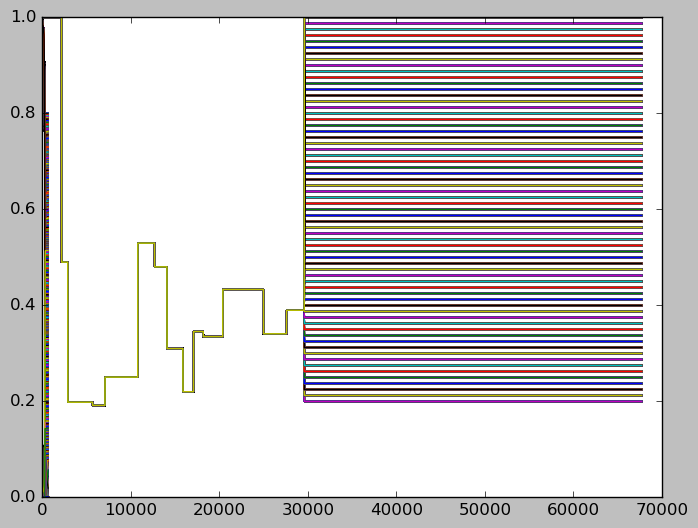

In [50]:
Min_rho = 0.2
Max_rho = 1
HowManyRhos = 65 # Use smaller grid if it takes too long or too heavy for your computer, can take hours otherwise (try e.g. 9 points)

Min_tvac = 0
Max_tvac = 0.01 # 0.0111 
HowManyTvacs = 65 # Use smaller grid if it takes too long or too heavy for your computer, can take hours otherwise (try e.g. 9 points)

#List_rho=np.linspace(0,1,11)
List_rho=np.linspace(Min_rho,Max_rho,HowManyRhos)
#List_tvac = np.linspace(0,0.0111,10)
List_tvac = np.linspace(Min_tvac,Max_tvac,HowManyTvacs)

MyArray = np.zeros(HowManyRhos*HowManyTvacs).reshape(HowManyRhos,HowManyTvacs)

X,Y = np.meshgrid(List_tvac,List_rho)

i=0
for rho in List_rho:
    j=0
    for tvac in List_tvac:
        #rho=List_rho[i]
        #tvac=List_tvac[j]
        MyArray[i,j]=f_HerdImm_Time(rho,tvac)
        #print(i)
        #print(j)
        #print()
        j=j+1
    i=i+1
print(np.shape(MyArray))


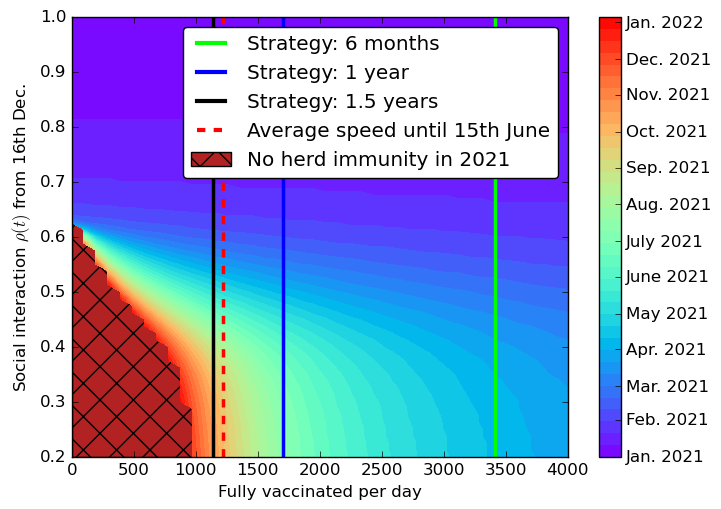

In [51]:
fig = plt.figure(figsize=(8, 5.5),facecolor="white")
ax = fig.add_subplot(111)

plt.contourf(X*N,Y, MyArray,40, cmap='rainbow')#cmap='RdGy')

#cbar=plt.colorbar()
#cbar.set_label('Time to Herd Immunity since Jan 1st', rotation=90)

cbar = plt.colorbar()
cbar.set_ticks([0,
                31,
                31+28,
                31+28+31,
                31+28+31+30,
                31+28+31+30+31,
                31+28+31+30+31+30,
                31+28+31+30+31+30+31,
                31+28+31+30+31+30+31+31,
                31+28+31+30+31+30+31+31+30,
                31+28+31+30+31+30+31+31+30+31,
                31+28+31+30+31+30+31+31+30+31+30,
                31+28+31+30+31+30+31+31+30+31+30+31
               ])

#cbar.set_xticklabels(['1st Jan. 2021', '1st Feb. 2021', '1st March 2021', '1st April 2021'])  # horizontal colorbar

cbar.set_ticklabels(['Jan. 2021', 
                     'Feb. 2021', 
                     'Mar. 2021', 
                     'Apr. 2021',
                     'May 2021', 
                     'June 2021', 
                     'July 2021',
                     'Aug. 2021', 
                     'Sep. 2021', 
                     'Oct. 2021',
                     'Nov. 2021', 
                     'Dec. 2021', 
                     'Jan. 2022'
                    ])

#n_levels=[0,100,200,300,400]#,float('inf')]
#plt.contour(X*N,Y, MyArray, n_levels, colors='black', linestyles='-')
#cs=plt.contourf(X*N,Y, MyArray, n_levels, colors='none',hatches=['\\','\\\\','*'])

import matplotlib.patches as patches
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
xy = (xmin,ymin)
width = xmax - xmin
height = ymax - ymin
GrayBackground = patches.Rectangle(xy, width, height,color='firebrick',zorder=-10)
BlackHatches = patches.Rectangle(xy, width, height,hatch='x', fill=None, zorder=-9)
ax.add_patch(GrayBackground)
ax.add_patch(BlackHatches)

# artists, labels = cs.legend_elements()
My_patch = mpatches.Patch(hatch='x',facecolor='firebrick',)
from matplotlib.lines import Line2D
colors = ['lime', 'blue','k','red']
LineStyles = ['-','-','-','--']
lines = [Line2D([0], [0], color=colors[i], linewidth=3, linestyle=LineStyles[i]) for i in [0,1,2,3]]
lines.append(My_patch)
labels = ['Strategy: 6 months', 'Strategy: 1 year','Strategy: 1.5 years','Average speed until 15th June','No herd immunity in 2021']

#plt.title('When Herd Immunity is reached - Austria')
                
plt.axvline(x=N/(365*0.5),label='Strategy: 6 months',color='lime',linewidth=2.5)
plt.axvline(x=N/365,label='Strategy: 1 year',color='blue',linewidth=2.5)
plt.axvline(x=N/(365*1.5),label='Strategy: 1.5 years',color='k',linewidth=2.5)
plt.axvline(x=N/(365*1.4),label='Average speed until 15 June',color='red',linewidth=2.5,linestyle='--')
plt.xlabel('Fully vaccinated per day')
plt.ylabel(r'Social interaction $\rho(t)$ from 16th Dec.')

plt.xlim(0,4000)
plt.yticks(np.arange(0.2,1.1,0.1))
plt.legend(lines, labels,fancybox=True)
#plt.legend()
plt.savefig('./Results_Luxembourg/HerdImmunityTIME_rho_tvac_Luxembourg' + FileFormatOfFigures)
plt.show()

In [258]:
### Herd Immunity Threshold computational estimation ###

In [259]:
def rhoAsFunctionforLuxembourg(time,ListOfRhos):
    
    rho0 = ListOfRhos[0]
    rho1 = ListOfRhos[1]
    rho2 = ListOfRhos[2]
    rho3 = ListOfRhos[3]
    rho4 = ListOfRhos[4]
    rho5 = ListOfRhos[5]
    rho6 = ListOfRhos[6]
    rho7 = ListOfRhos[7]
    rho8 = ListOfRhos[8]
    rho9 = ListOfRhos[9]
    rho10 = ListOfRhos[10]
    rho11 = ListOfRhos[11]
    rho12 = ListOfRhos[12]
    rho13 = ListOfRhos[13]
    
    
    ListOfRhosOUTPUT = []
    for t in time:
        if (t<22):
            rho=1
        elif (t>=22)and (t<29):
            rho=rho1
        elif (t>=29)and (t<57):
            rho=rho2
        elif (t>=57)and (t<71):
            rho=rho3
        elif (t>=71)and (t<108):  
            rho=rho4
        elif (t>=108)and(t<127):
            rho=rho5
        elif (t>=127) and (t<141):
            rho=rho6
        elif (t>=141) and (t<159):
            rho=rho7
        elif(t>=159) and (t<171):
            rho=rho8
        elif(t>=171) and (t<182): 
            rho=rho9
        elif(t>=182) and (t<204): 
            rho=rho10
        elif(t>=204) and (t<250):
            rho=rho11  
        elif(t>=250)and(t<276):
            rho=rho12 
        elif(t>=276)and(t<NumberDaysData):
            rho=rho13
        elif t >= NumberDaysData:
            if len(ListOfRhos) < 15:
                rho=1
            elif len(ListOfRhos) >= 15:
                rho=ListOfRhos[14]
            
        ListOfRhosOUTPUT.append(rho)
    return np.array(ListOfRhosOUTPUT)

In [260]:
rho1=0.4902
rho2=0.1984
rho3=0.1918
rho4=0.2507
rho5=0.5298
rho6=0.4804
rho7=0.3101
rho8=0.2203
rho9=0.3457
rho10=0.3351
rho11=0.4333
rho12=0.341
rho13=0.39

ListOfRhos=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]

In [261]:
rho1=1
rho2=1
rho3=1
rho4=1
rho5=1 
rho6=1
rho7=1
rho8=1
rho9=1
rho10=1
rho11=1
rho12=1
rho13=1

ListOfRhos1=[1,rho1,rho2,rho3,rho4,rho5,rho6,rho7,rho8,rho9,rho10,rho11,rho12,rho13]
ListOfRhos_ManualFit_1stWave=ListOfRhos1

In [262]:
# Run the model

N=623180
P2=(1-1/N,1/N,0,0,0,0,0,0,0,0,0,0,0,0,0,0)
t_max = 10000
dt = 0.001
t = np.linspace(0, t_max, int(t_max/dt) + 1)

resultsseir=odeint(model_SEIRICUHOS,P2,t,(ListOfRhos,ListOfParametersfirstwave))
resultsseir1=odeint(model_SEIRICUHOS,P2,t,(ListOfRhos1,ListOfParametersfirstwave))

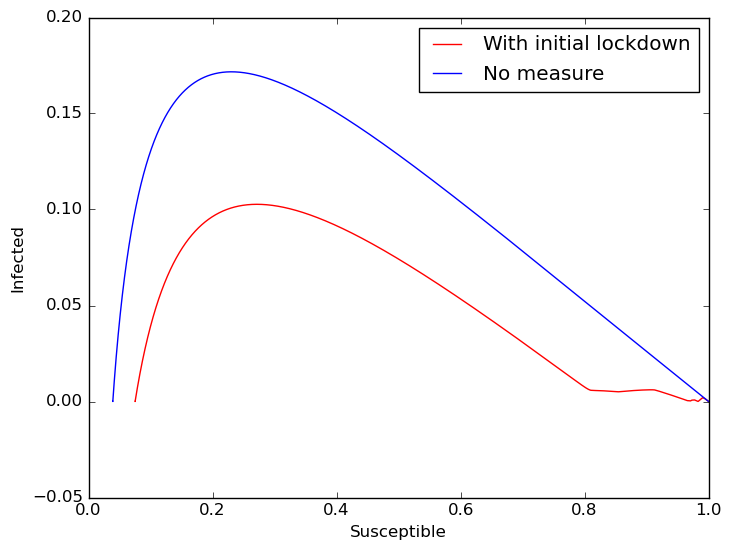

In [263]:
plt.figure(facecolor='white')
plt.plot(resultsseir[:,0], (resultsseir[:,3]+resultsseir[:,5]), color="red",label='With initial lockdown')
plt.plot(resultsseir1[:,0], (resultsseir1[:,3]+resultsseir1[:,5]), color="blue",label='No measure')


plt.xlabel("Susceptible")
plt.ylabel("Infected")  
plt.legend(loc='best')
#plt.title("Phase space")

In [264]:
print ("S max =", resultsseir[:,0][np.argmax(resultsseir[:,3]+resultsseir[:,5])])#maximum wavelength of emission, np.argmax(intensity373,axis=0)] is pulling the maximum value from the intensity array and then matching it to the corresponding wavelength in put to the calculation
print ("I max = ", np.amax(resultsseir[:,3]+resultsseir[:,5]))


S max = 0.27140785150878666
I max =  0.10270430289354945


In [265]:
print ("S max =", resultsseir1[:,0][np.argmax(resultsseir1[:,3]+resultsseir1[:,5])])
print ("I max = ", np.amax(resultsseir1[:,3]+resultsseir1[:,5]))

S max = 0.2303037499230584
I max =  0.17171225178904875


In [266]:
list_of_tuples=list(zip(resultsseir[:,0], (resultsseir[:,3]+resultsseir[:,5])))
df2=pd.DataFrame(list_of_tuples,columns=['S','I'])
df2.to_csv(r'dataframe_SILux.csv', index = False)

In [267]:
list_of_tuples=list(zip(df['date'],SevenDaysMovingAverage_TotalCases,SevenDaysMovingAverage_ICU,SevenDaysMovingAverage_Hos,SevenDaysMovingAverage_deadhos,SevenDaysMovingAverage_deadautre))
df2=pd.DataFrame(list_of_tuples,columns=['Date','Cases','ICU','Hospital','dead_hos','dead_autre'])
df2.to_csv(r'dataframe_moving_average.csv', index = False)

In [268]:
data=np.vstack((df2['Cases'],df2['ICU']))
data2=np.vstack((df2['Hospital'],df['dead_hos']))
data4=np.vstack((data,data2))
data1=np.vstack((data4,df['dead_autre']))
#data1=np.vstack((data5,df['recovered']))